<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_7_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [4]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [5]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [6]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [8]:
%cd '/dataset unzipped'

/dataset unzipped


In [9]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [10]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [11]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [13]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [14]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [15]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [16]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [17]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [18]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(7):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 39.5109 - IoU: 0.0491
Epoch 1: val_loss improved from inf to 42.22808, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 54ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


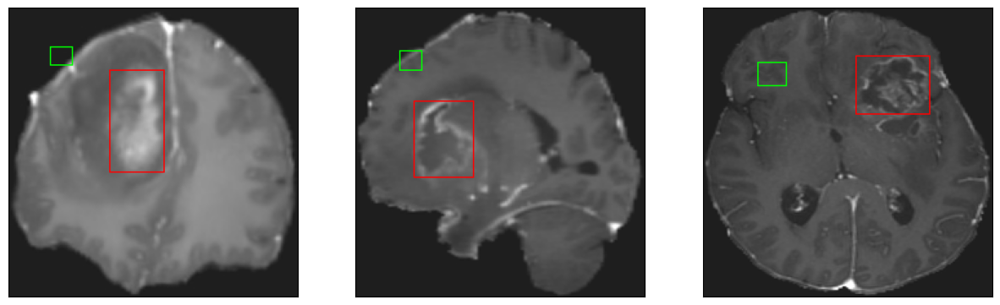

26/26 [==============================] - 25s 279ms/step - loss: 38.8619 - IoU: 0.0500 - val_loss: 42.2281 - val_IoU: 0.0176
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 22.2541 - IoU: 0.1155
Epoch 2: val_loss improved from 42.22808 to 28.30975, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


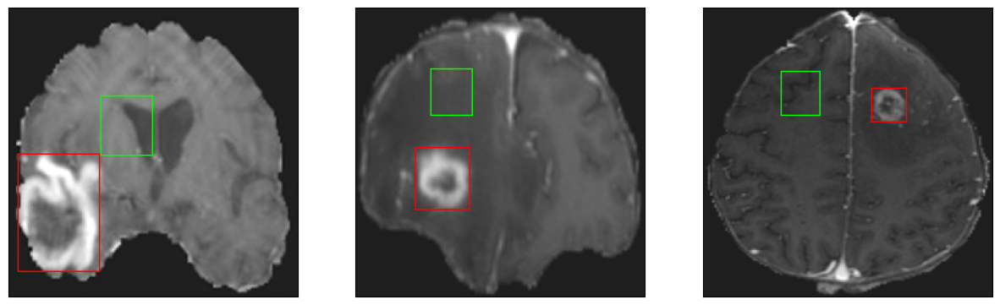

26/26 [==============================] - 3s 133ms/step - loss: 22.1504 - IoU: 0.1177 - val_loss: 28.3098 - val_IoU: 0.0596
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 17.1561 - IoU: 0.2137
Epoch 3: val_loss did not improve from 28.30975
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


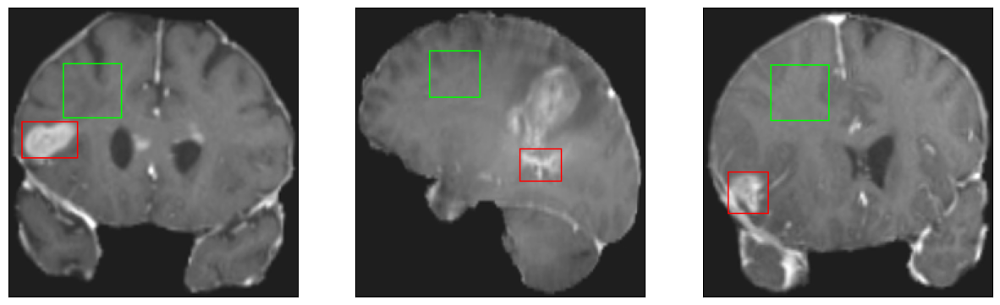

26/26 [==============================] - 3s 111ms/step - loss: 17.1561 - IoU: 0.2137 - val_loss: 32.2066 - val_IoU: 0.0732
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 14.2847 - IoU: 0.2875
Epoch 4: val_loss did not improve from 28.30975
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


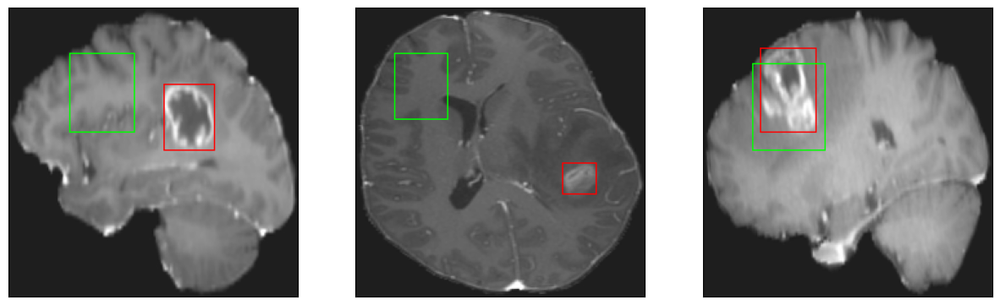

26/26 [==============================] - 3s 103ms/step - loss: 14.2847 - IoU: 0.2875 - val_loss: 31.8681 - val_IoU: 0.0930
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 13.0679 - IoU: 0.3173
Epoch 5: val_loss did not improve from 28.30975
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4


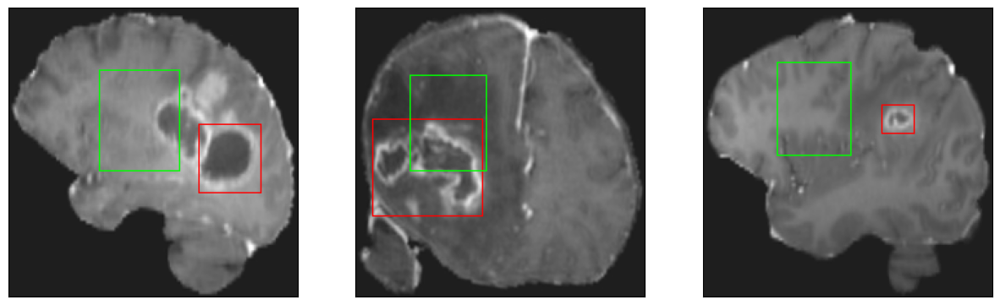

26/26 [==============================] - 3s 133ms/step - loss: 13.0679 - IoU: 0.3173 - val_loss: 29.6724 - val_IoU: 0.1318
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 12.1719 - IoU: 0.3406
Epoch 6: val_loss improved from 28.30975 to 24.50426, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


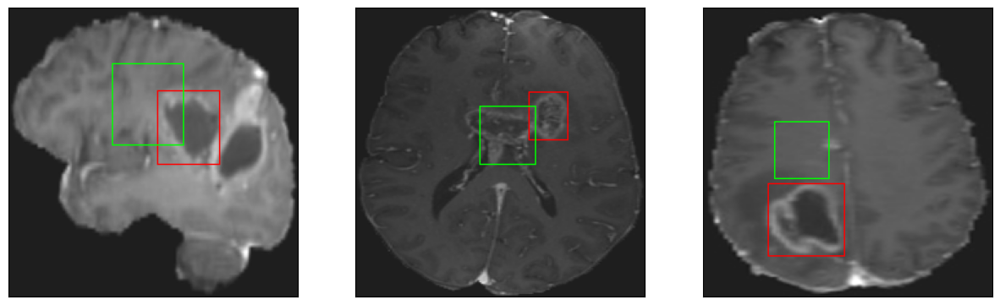

26/26 [==============================] - 4s 147ms/step - loss: 12.1920 - IoU: 0.3382 - val_loss: 24.5043 - val_IoU: 0.1519
Epoch 7/200
25/26 [===========================>..] - ETA: 0s - loss: 11.4970 - IoU: 0.3554
Epoch 7: val_loss did not improve from 24.50426
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


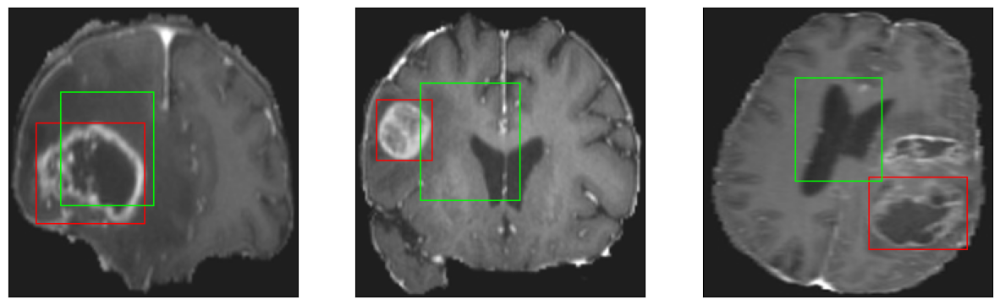

26/26 [==============================] - 3s 100ms/step - loss: 11.5069 - IoU: 0.3574 - val_loss: 31.8242 - val_IoU: 0.1435
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 10.9042 - IoU: 0.3800
Epoch 8: val_loss improved from 24.50426 to 19.70995, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


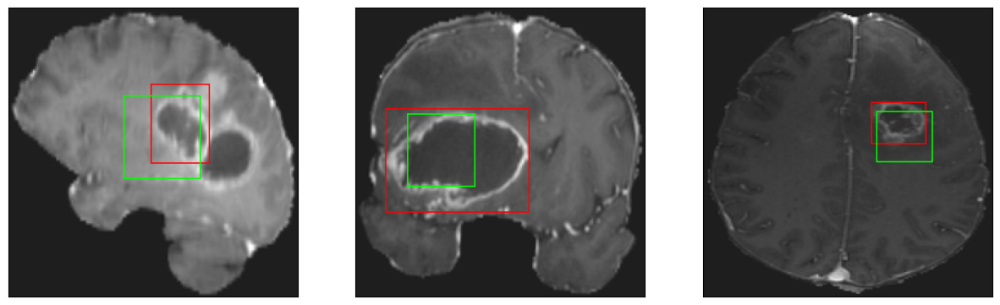

26/26 [==============================] - 4s 144ms/step - loss: 10.9042 - IoU: 0.3800 - val_loss: 19.7099 - val_IoU: 0.2201
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 10.4007 - IoU: 0.3937
Epoch 9: val_loss improved from 19.70995 to 18.12489, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


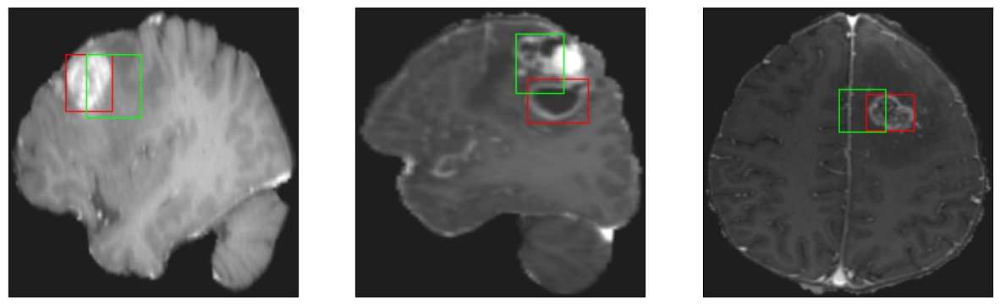

26/26 [==============================] - 3s 113ms/step - loss: 10.4007 - IoU: 0.3937 - val_loss: 18.1249 - val_IoU: 0.2121
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 9.8961 - IoU: 0.4038
Epoch 10: val_loss improved from 18.12489 to 12.61214, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


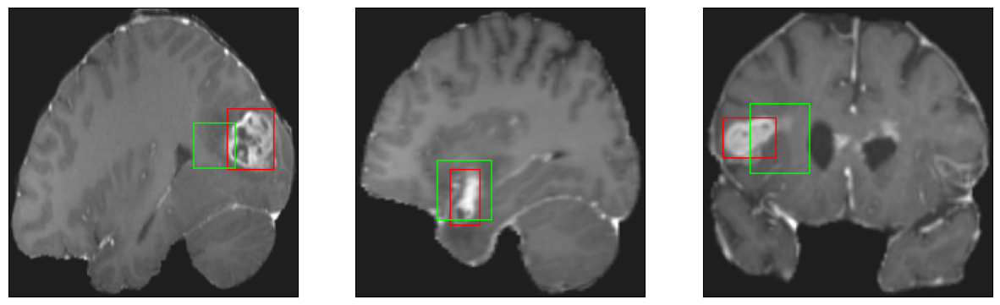

26/26 [==============================] - 3s 112ms/step - loss: 9.8676 - IoU: 0.4023 - val_loss: 12.6121 - val_IoU: 0.3242
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 9.7569 - IoU: 0.4137
Epoch 11: val_loss improved from 12.61214 to 12.17271, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


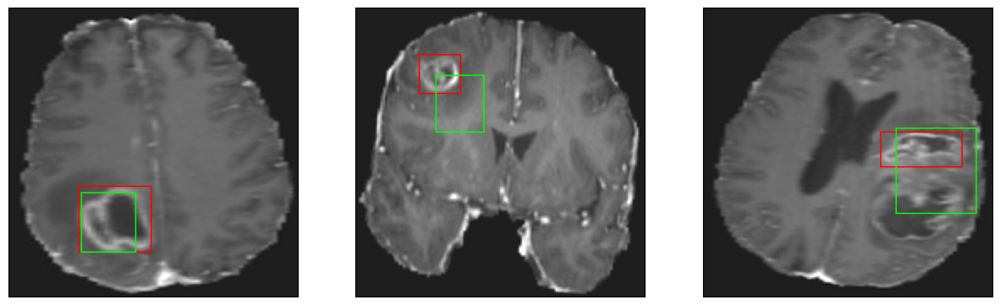

26/26 [==============================] - 3s 118ms/step - loss: 9.7549 - IoU: 0.4153 - val_loss: 12.1727 - val_IoU: 0.3564
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 8.8871 - IoU: 0.4446
Epoch 12: val_loss did not improve from 12.17271
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


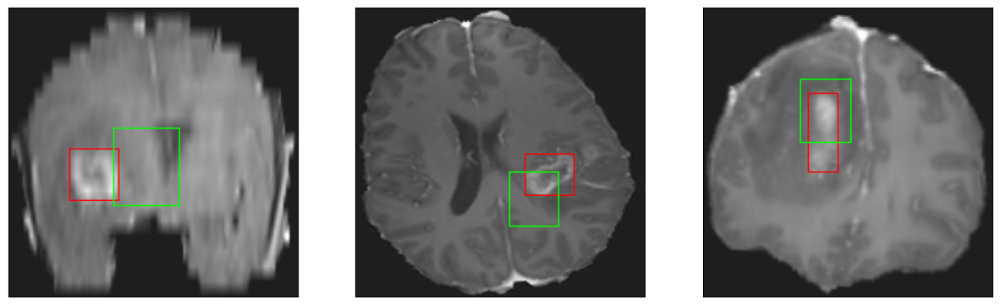

26/26 [==============================] - 4s 141ms/step - loss: 8.8871 - IoU: 0.4446 - val_loss: 15.2455 - val_IoU: 0.2861
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 8.8771 - IoU: 0.4442
Epoch 13: val_loss did not improve from 12.17271
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


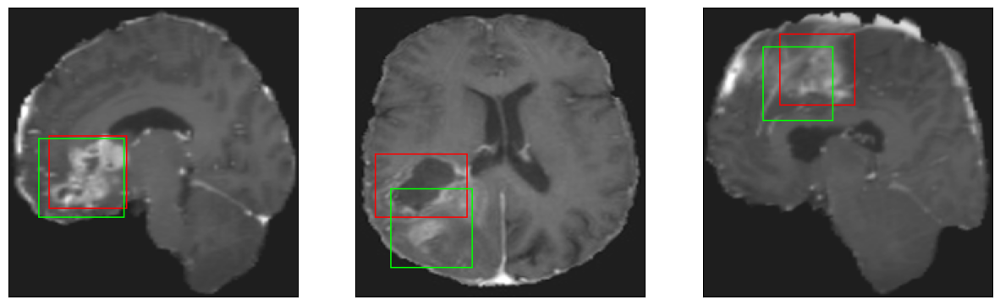

26/26 [==============================] - 3s 128ms/step - loss: 8.8771 - IoU: 0.4442 - val_loss: 14.2491 - val_IoU: 0.3510
Epoch 14/200
25/26 [===========================>..] - ETA: 0s - loss: 8.7059 - IoU: 0.4471
Epoch 14: val_loss improved from 12.17271 to 11.99650, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


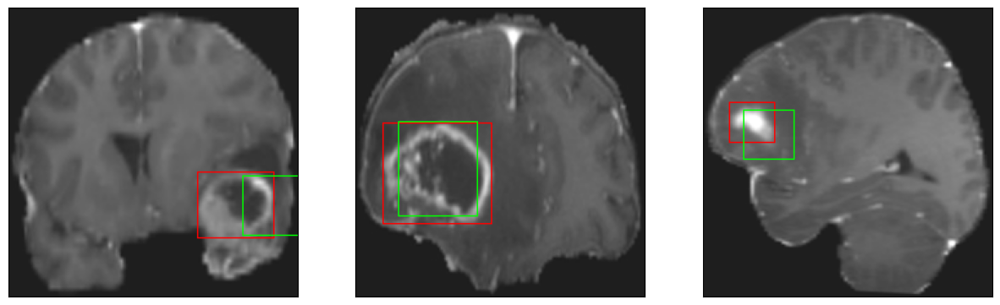

26/26 [==============================] - 3s 120ms/step - loss: 8.6770 - IoU: 0.4488 - val_loss: 11.9965 - val_IoU: 0.3246
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 8.3971 - IoU: 0.4594
Epoch 15: val_loss did not improve from 11.99650
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


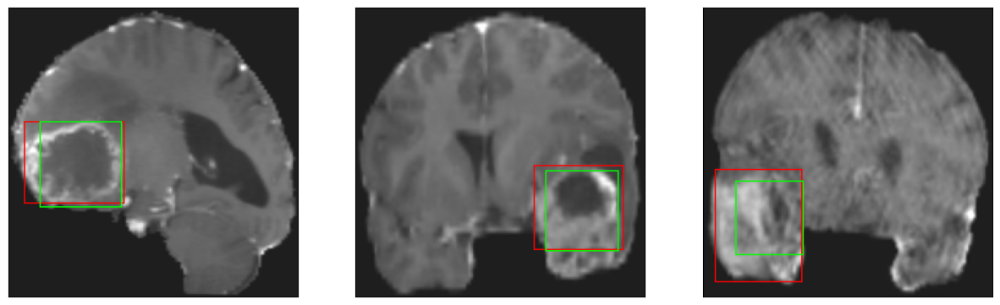

26/26 [==============================] - 3s 109ms/step - loss: 8.3971 - IoU: 0.4594 - val_loss: 16.0410 - val_IoU: 0.2631
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 8.5829 - IoU: 0.4692
Epoch 16: val_loss improved from 11.99650 to 11.24710, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


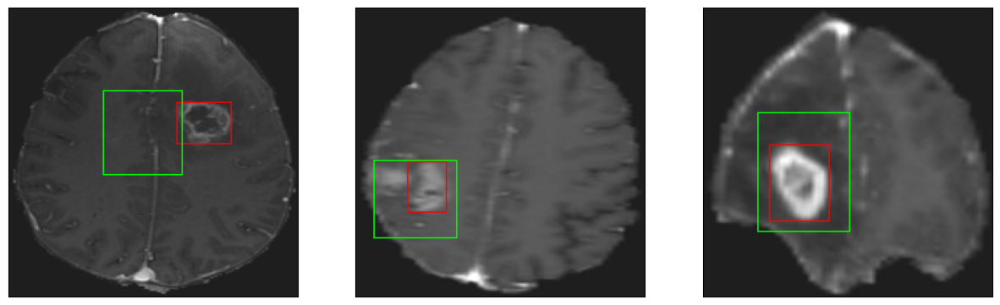

26/26 [==============================] - 4s 145ms/step - loss: 8.5829 - IoU: 0.4692 - val_loss: 11.2471 - val_IoU: 0.3979
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 8.2738 - IoU: 0.4662
Epoch 17: val_loss did not improve from 11.24710
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


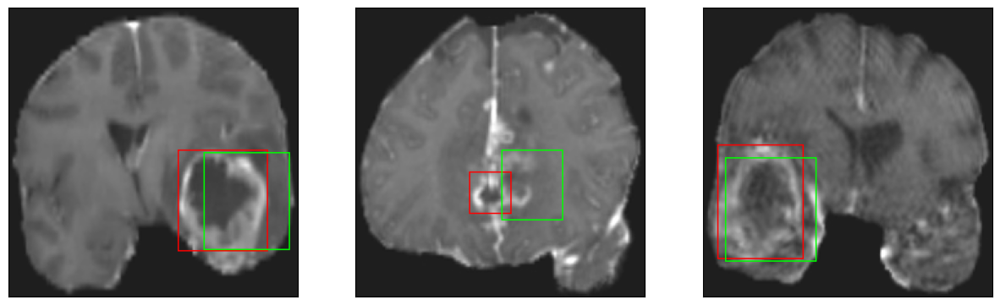

26/26 [==============================] - 4s 148ms/step - loss: 8.2738 - IoU: 0.4662 - val_loss: 12.8529 - val_IoU: 0.3092
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 8.1259 - IoU: 0.4802
Epoch 18: val_loss did not improve from 11.24710
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


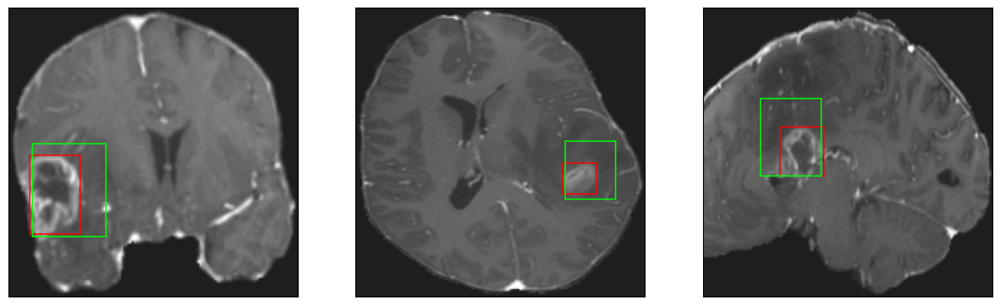

26/26 [==============================] - 3s 118ms/step - loss: 8.1960 - IoU: 0.4792 - val_loss: 14.7780 - val_IoU: 0.3887
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 8.2361 - IoU: 0.4724
Epoch 19: val_loss did not improve from 11.24710
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


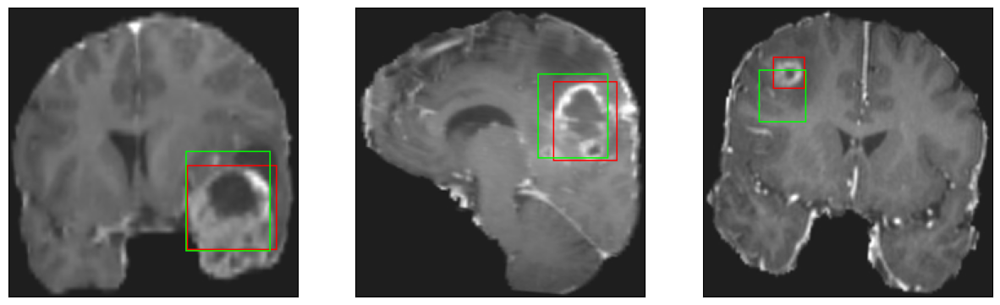

26/26 [==============================] - 3s 110ms/step - loss: 8.2361 - IoU: 0.4724 - val_loss: 12.2319 - val_IoU: 0.3990
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 7.7827 - IoU: 0.4783
Epoch 20: val_loss did not improve from 11.24710
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


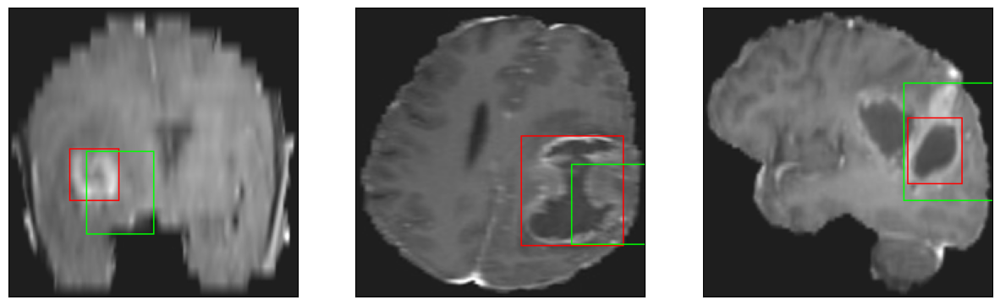

26/26 [==============================] - 4s 152ms/step - loss: 7.7573 - IoU: 0.4796 - val_loss: 14.3756 - val_IoU: 0.2968
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 7.7416 - IoU: 0.4915
Epoch 21: val_loss improved from 11.24710 to 10.92056, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


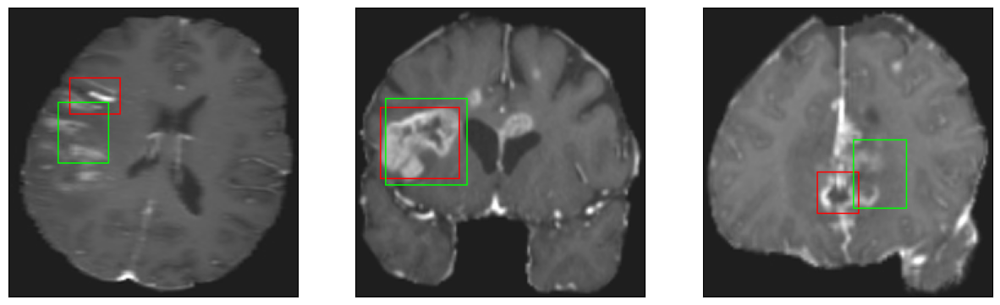

26/26 [==============================] - 5s 189ms/step - loss: 7.7416 - IoU: 0.4915 - val_loss: 10.9206 - val_IoU: 0.3811
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 7.4161 - IoU: 0.5009
Epoch 22: val_loss did not improve from 10.92056
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


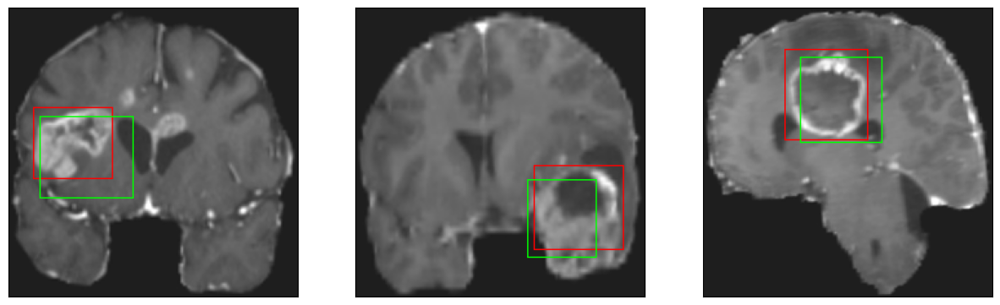

26/26 [==============================] - 3s 129ms/step - loss: 7.4161 - IoU: 0.5009 - val_loss: 13.0674 - val_IoU: 0.2745
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 7.3043 - IoU: 0.4974
Epoch 23: val_loss did not improve from 10.92056
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


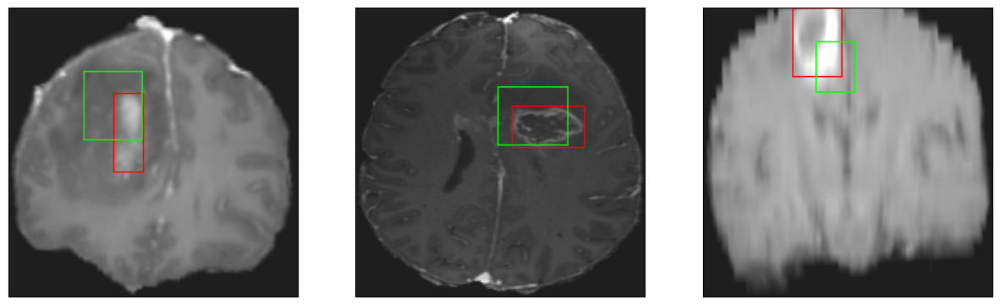

26/26 [==============================] - 3s 121ms/step - loss: 7.3160 - IoU: 0.4950 - val_loss: 12.2593 - val_IoU: 0.4178
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 7.2290 - IoU: 0.5071
Epoch 24: val_loss improved from 10.92056 to 10.00114, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 18ms/step
4


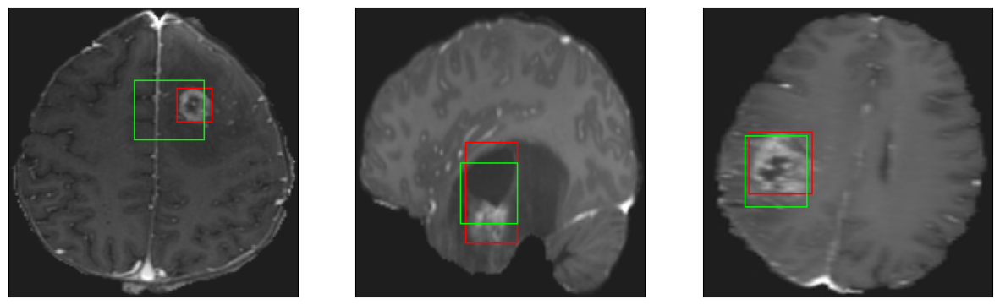

26/26 [==============================] - 5s 189ms/step - loss: 7.2290 - IoU: 0.5071 - val_loss: 10.0011 - val_IoU: 0.4199
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 7.1934 - IoU: 0.5080
Epoch 25: val_loss did not improve from 10.00114
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


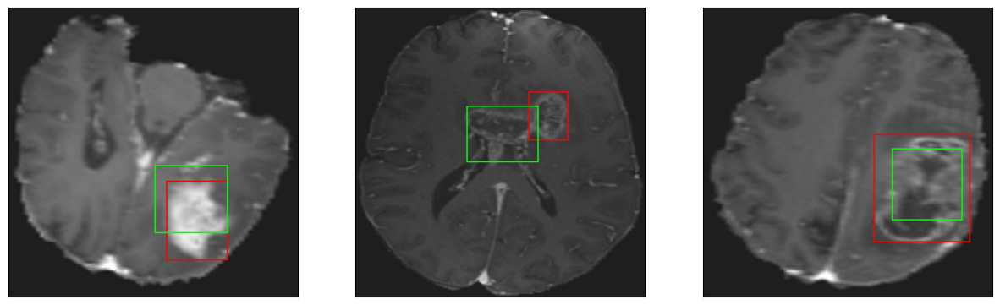

26/26 [==============================] - 4s 137ms/step - loss: 7.1934 - IoU: 0.5080 - val_loss: 12.4729 - val_IoU: 0.3588
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 7.2158 - IoU: 0.5047
Epoch 26: val_loss did not improve from 10.00114
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


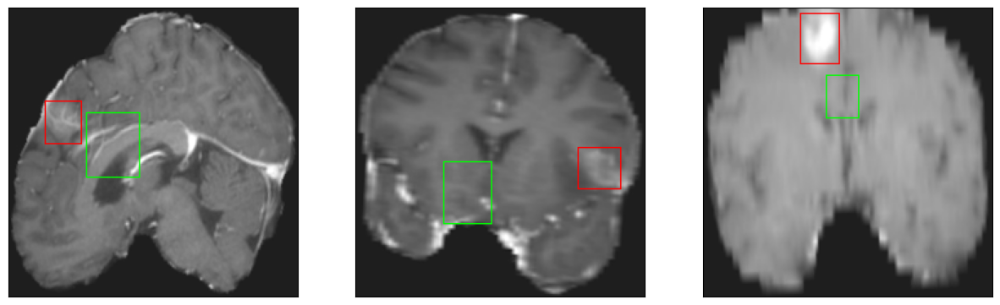

26/26 [==============================] - 3s 117ms/step - loss: 7.2186 - IoU: 0.5040 - val_loss: 10.4883 - val_IoU: 0.4128
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 6.9454 - IoU: 0.5119
Epoch 27: val_loss did not improve from 10.00114
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4


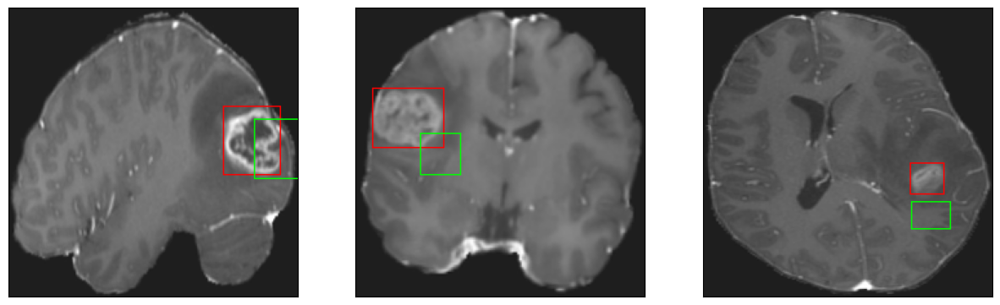

26/26 [==============================] - 4s 137ms/step - loss: 6.9454 - IoU: 0.5119 - val_loss: 13.0109 - val_IoU: 0.2995
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 6.7282 - IoU: 0.5238
Epoch 28: val_loss did not improve from 10.00114
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


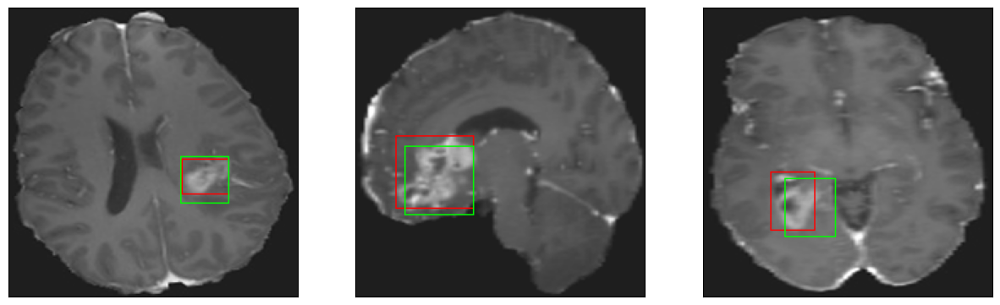

26/26 [==============================] - 4s 149ms/step - loss: 6.7282 - IoU: 0.5238 - val_loss: 10.7061 - val_IoU: 0.4330
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7128 - IoU: 0.5348
Epoch 29: val_loss improved from 10.00114 to 9.87074, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


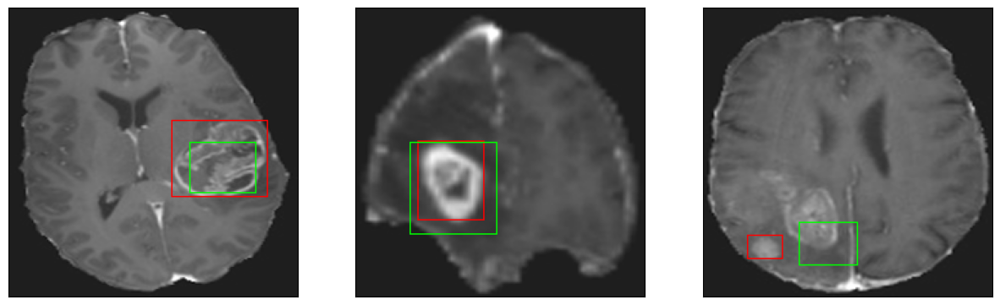

26/26 [==============================] - 5s 178ms/step - loss: 6.7481 - IoU: 0.5325 - val_loss: 9.8707 - val_IoU: 0.4431
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 6.7628 - IoU: 0.5378
Epoch 30: val_loss did not improve from 9.87074
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


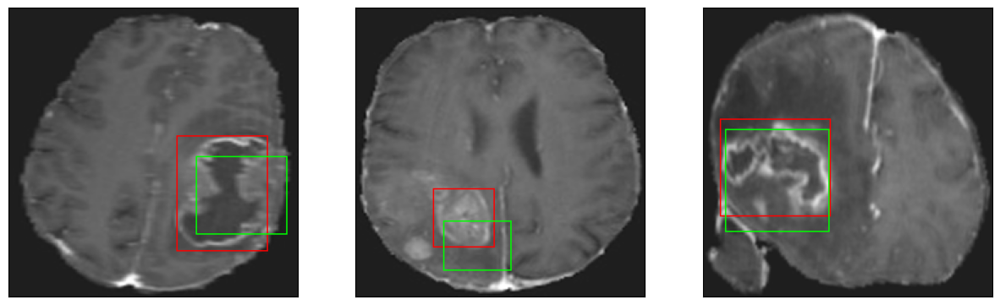

26/26 [==============================] - 3s 116ms/step - loss: 6.7628 - IoU: 0.5378 - val_loss: 11.2300 - val_IoU: 0.4018
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 6.6582 - IoU: 0.5376
Epoch 31: val_loss did not improve from 9.87074
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


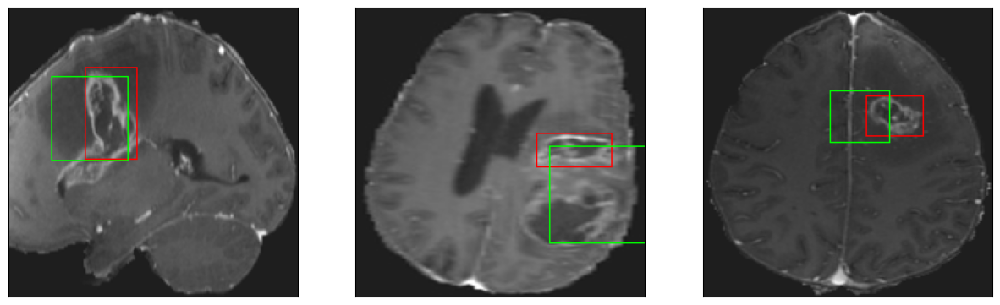

26/26 [==============================] - 4s 152ms/step - loss: 6.6582 - IoU: 0.5376 - val_loss: 12.3026 - val_IoU: 0.4052
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 6.8582 - IoU: 0.5258
Epoch 32: val_loss did not improve from 9.87074
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


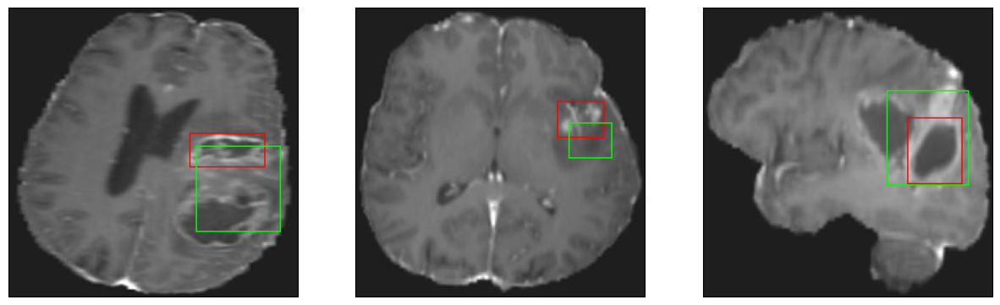

26/26 [==============================] - 4s 139ms/step - loss: 6.8582 - IoU: 0.5258 - val_loss: 10.7855 - val_IoU: 0.3701
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.4922 - IoU: 0.5380
Epoch 33: val_loss did not improve from 9.87074
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


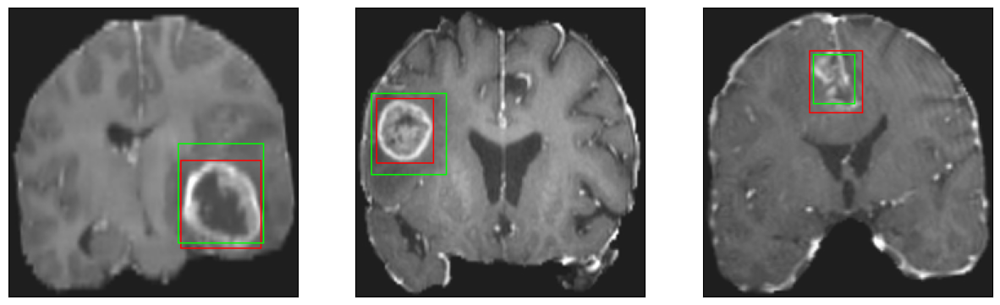

26/26 [==============================] - 3s 119ms/step - loss: 6.4922 - IoU: 0.5380 - val_loss: 10.4582 - val_IoU: 0.4621
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.4579 - IoU: 0.5391
Epoch 34: val_loss did not improve from 9.87074
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


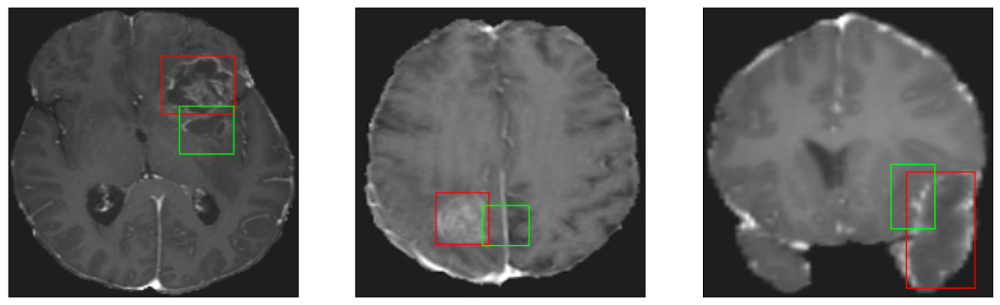

26/26 [==============================] - 3s 118ms/step - loss: 6.4579 - IoU: 0.5391 - val_loss: 10.3248 - val_IoU: 0.3958
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 6.6031 - IoU: 0.5313
Epoch 35: val_loss did not improve from 9.87074
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 15ms/step
4


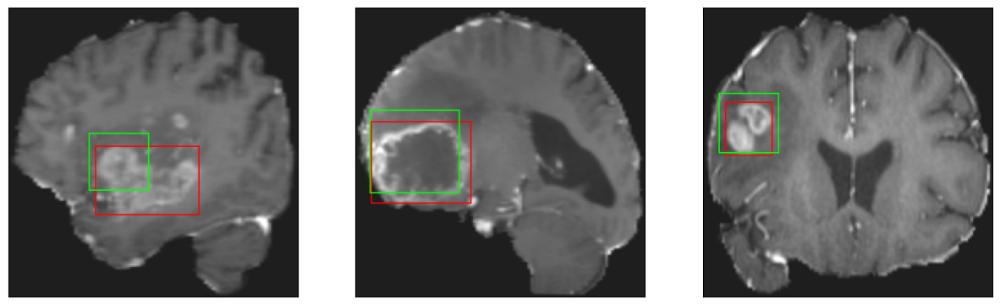

26/26 [==============================] - 4s 149ms/step - loss: 6.6031 - IoU: 0.5313 - val_loss: 10.4302 - val_IoU: 0.4201
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.7135 - IoU: 0.5176
Epoch 36: val_loss improved from 9.87074 to 9.71091, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


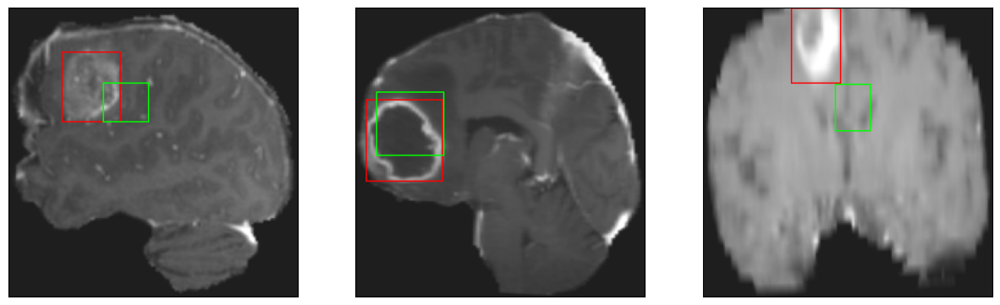

26/26 [==============================] - 4s 171ms/step - loss: 6.7135 - IoU: 0.5176 - val_loss: 9.7109 - val_IoU: 0.4335
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8363 - IoU: 0.5161
Epoch 37: val_loss did not improve from 9.71091
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


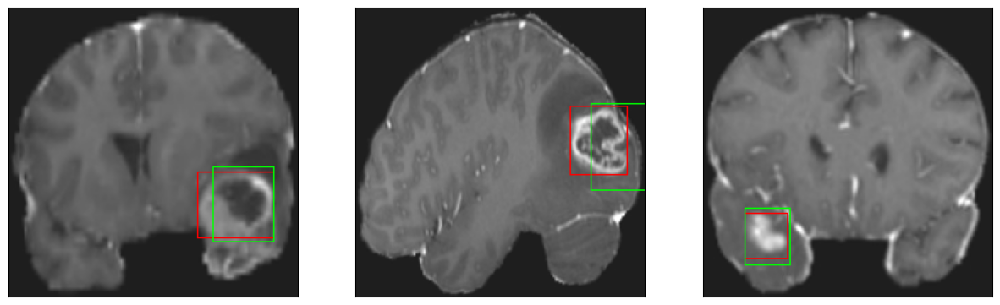

26/26 [==============================] - 3s 115ms/step - loss: 6.7829 - IoU: 0.5178 - val_loss: 9.9435 - val_IoU: 0.4227
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2507 - IoU: 0.5594
Epoch 38: val_loss did not improve from 9.71091
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4


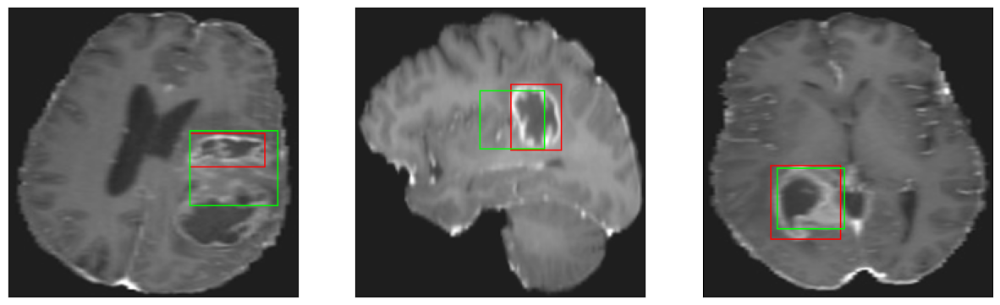

26/26 [==============================] - 4s 141ms/step - loss: 6.2756 - IoU: 0.5553 - val_loss: 10.7220 - val_IoU: 0.4259
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 6.3571 - IoU: 0.5451
Epoch 39: val_loss did not improve from 9.71091
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


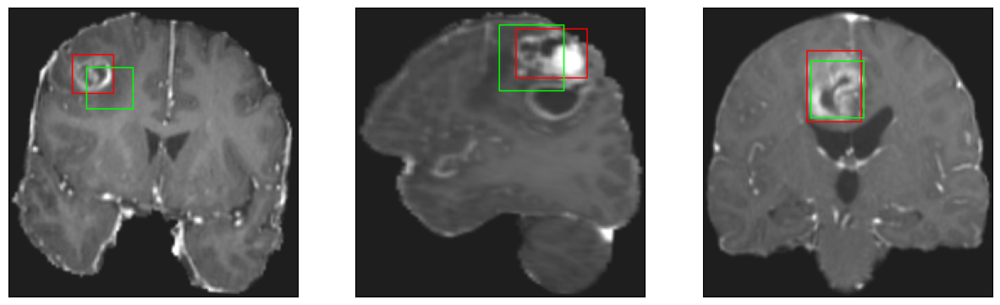

26/26 [==============================] - 4s 153ms/step - loss: 6.3571 - IoU: 0.5451 - val_loss: 13.3576 - val_IoU: 0.3449
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.2085 - IoU: 0.5559
Epoch 40: val_loss improved from 9.71091 to 8.88908, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


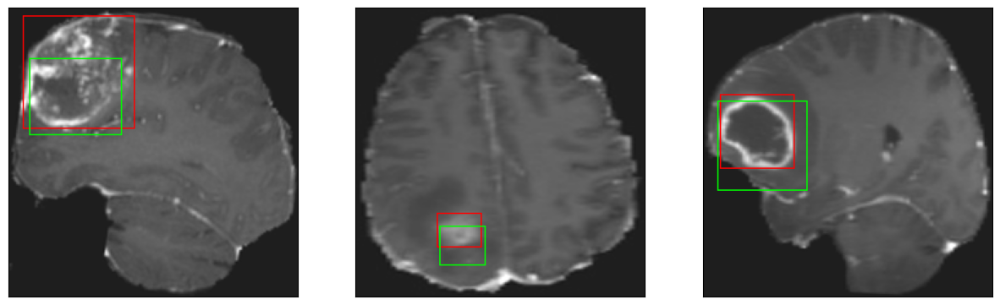

26/26 [==============================] - 5s 196ms/step - loss: 6.2085 - IoU: 0.5559 - val_loss: 8.8891 - val_IoU: 0.4745
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 6.3752 - IoU: 0.5433
Epoch 41: val_loss did not improve from 8.88908
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


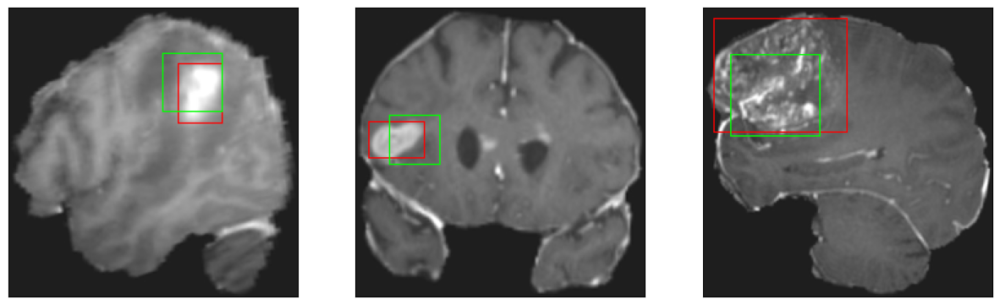

26/26 [==============================] - 3s 112ms/step - loss: 6.3752 - IoU: 0.5433 - val_loss: 11.7775 - val_IoU: 0.3875
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.9060 - IoU: 0.5629
Epoch 42: val_loss did not improve from 8.88908
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 12ms/step
4


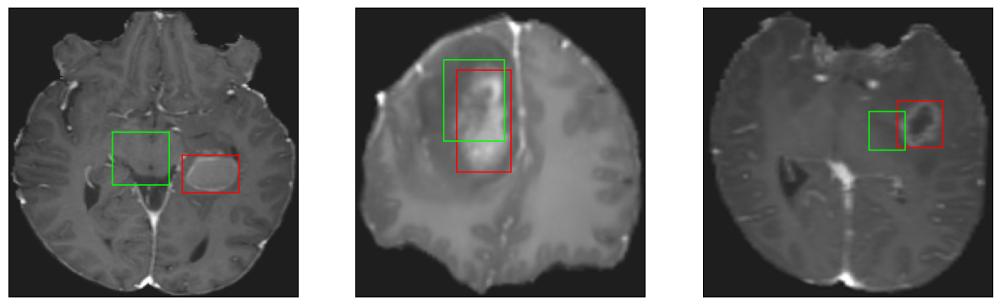

26/26 [==============================] - 4s 153ms/step - loss: 5.9060 - IoU: 0.5629 - val_loss: 12.8074 - val_IoU: 0.3907
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 5.8386 - IoU: 0.5723
Epoch 43: val_loss improved from 8.88908 to 8.65567, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


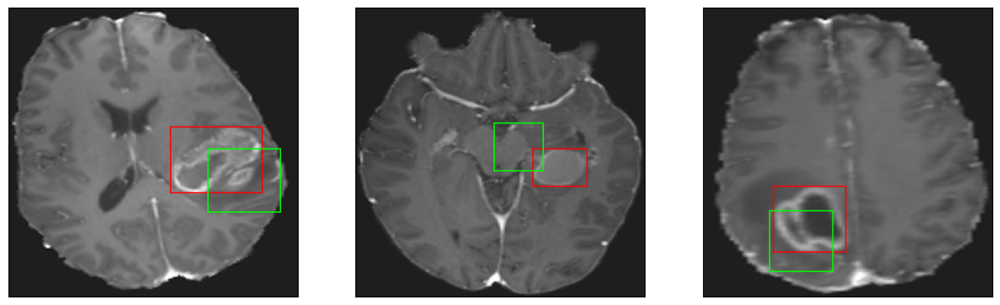

26/26 [==============================] - 4s 152ms/step - loss: 5.8386 - IoU: 0.5723 - val_loss: 8.6557 - val_IoU: 0.4834
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 5.8415 - IoU: 0.5595
Epoch 44: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


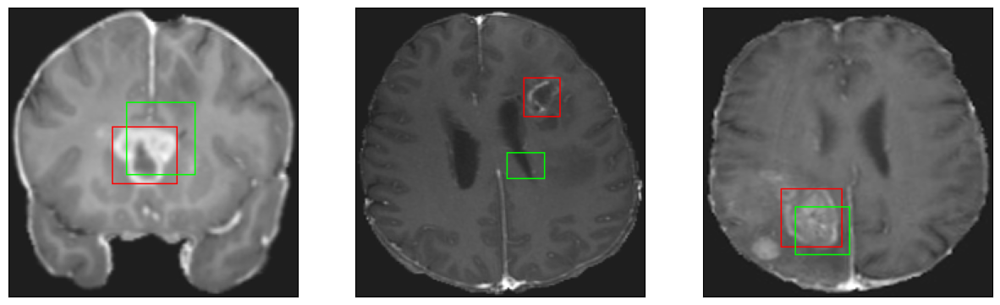

26/26 [==============================] - 3s 118ms/step - loss: 5.8415 - IoU: 0.5595 - val_loss: 9.9446 - val_IoU: 0.4457
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0517 - IoU: 0.5505
Epoch 45: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


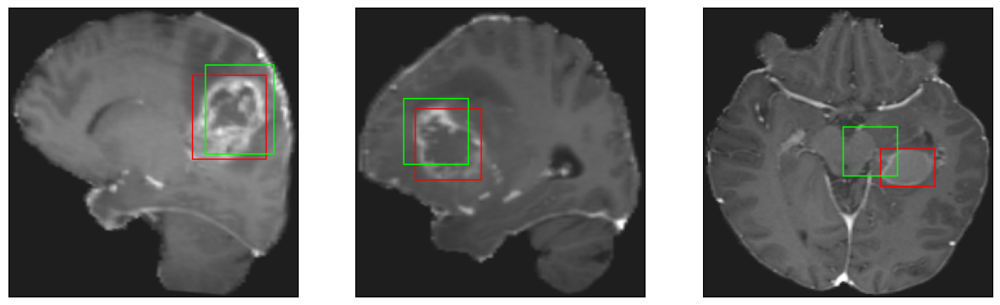

26/26 [==============================] - 3s 113ms/step - loss: 5.9816 - IoU: 0.5545 - val_loss: 9.2672 - val_IoU: 0.4853
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4910 - IoU: 0.5817
Epoch 46: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


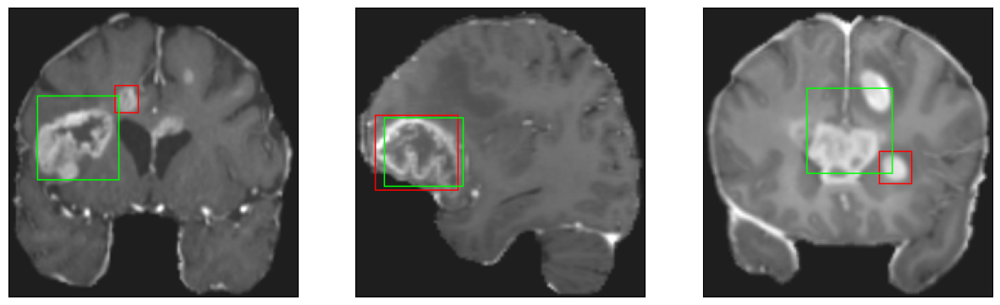

26/26 [==============================] - 4s 141ms/step - loss: 5.6099 - IoU: 0.5786 - val_loss: 11.9607 - val_IoU: 0.3902
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 5.7162 - IoU: 0.5768
Epoch 47: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


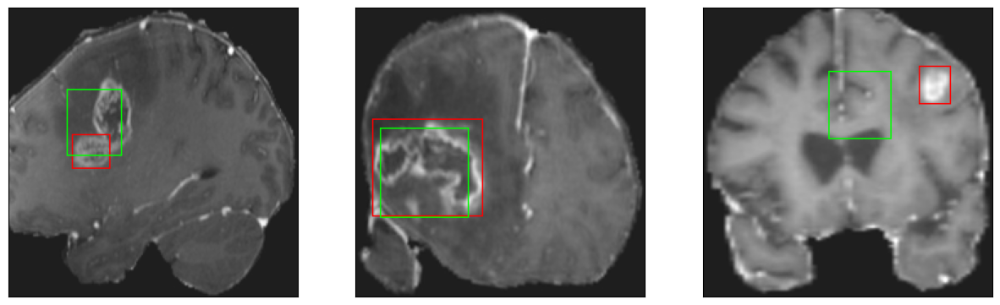

26/26 [==============================] - 4s 139ms/step - loss: 5.7162 - IoU: 0.5768 - val_loss: 10.7784 - val_IoU: 0.4296
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.3554 - IoU: 0.5963
Epoch 48: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


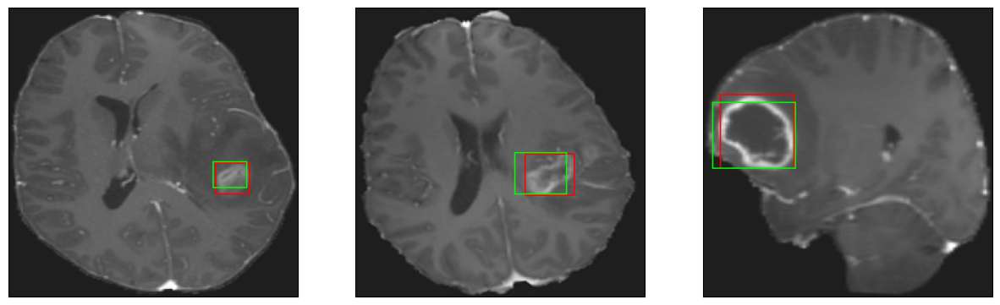

26/26 [==============================] - 3s 116ms/step - loss: 5.3554 - IoU: 0.5963 - val_loss: 9.7855 - val_IoU: 0.4479
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 5.6691 - IoU: 0.5806
Epoch 49: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


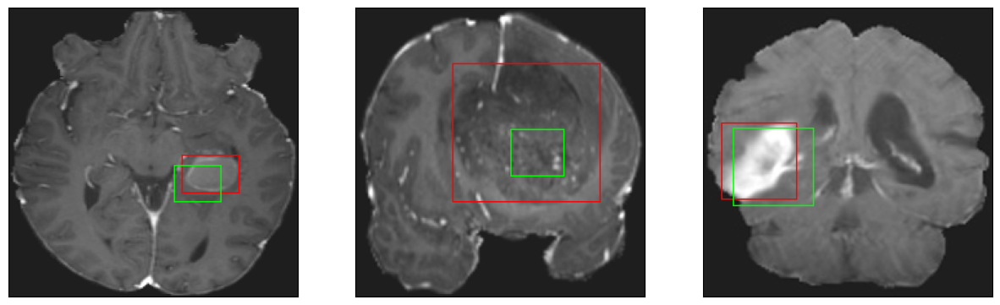

26/26 [==============================] - 3s 119ms/step - loss: 5.6691 - IoU: 0.5806 - val_loss: 9.4214 - val_IoU: 0.4620
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 5.6132 - IoU: 0.5806
Epoch 50: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


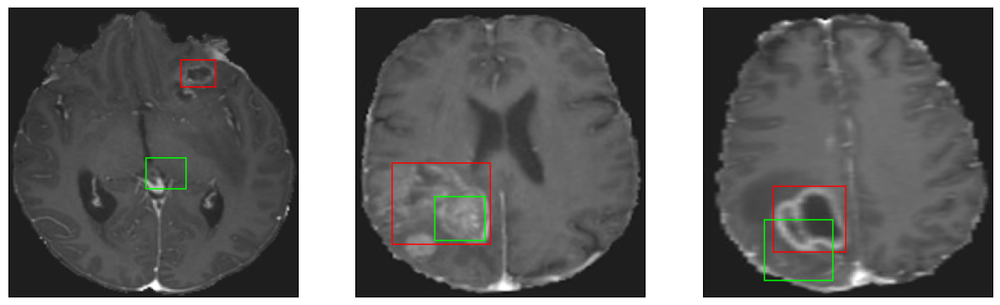

26/26 [==============================] - 4s 147ms/step - loss: 5.6132 - IoU: 0.5806 - val_loss: 9.0110 - val_IoU: 0.4773
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5165 - IoU: 0.5890
Epoch 51: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


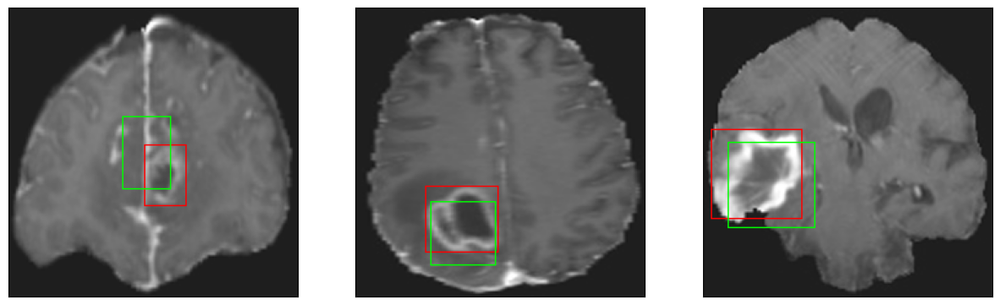

26/26 [==============================] - 3s 118ms/step - loss: 5.5174 - IoU: 0.5879 - val_loss: 10.0311 - val_IoU: 0.4188
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8841 - IoU: 0.5565
Epoch 52: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


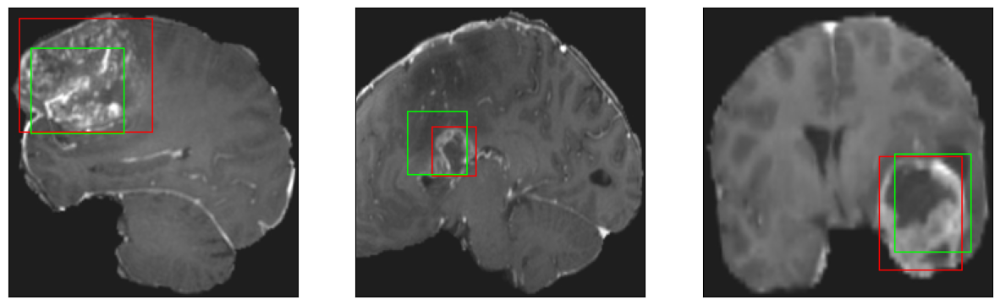

26/26 [==============================] - 3s 119ms/step - loss: 5.9002 - IoU: 0.5568 - val_loss: 9.5196 - val_IoU: 0.5075
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 5.8636 - IoU: 0.5800
Epoch 53: val_loss did not improve from 8.65567
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


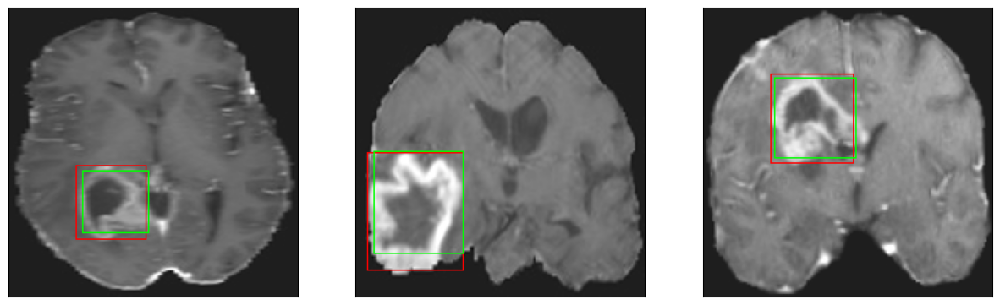

26/26 [==============================] - 3s 118ms/step - loss: 5.8636 - IoU: 0.5800 - val_loss: 10.6523 - val_IoU: 0.4335
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.6675 - IoU: 0.5826
Epoch 54: val_loss improved from 8.65567 to 8.44848, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


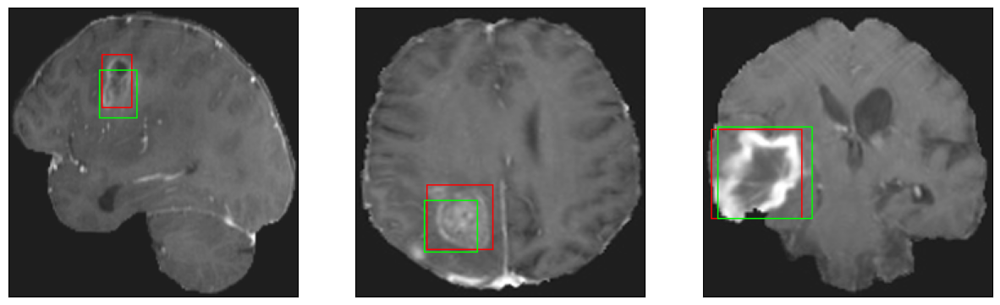

26/26 [==============================] - 5s 196ms/step - loss: 5.6675 - IoU: 0.5826 - val_loss: 8.4485 - val_IoU: 0.5163
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 5.6084 - IoU: 0.5790
Epoch 55: val_loss did not improve from 8.44848
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


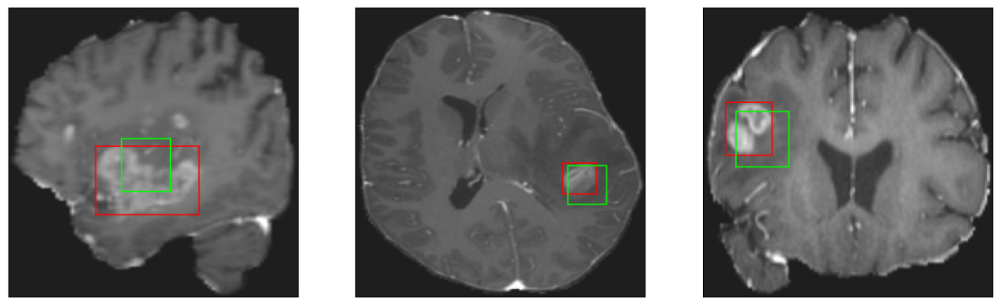

26/26 [==============================] - 4s 136ms/step - loss: 5.6084 - IoU: 0.5790 - val_loss: 9.3133 - val_IoU: 0.4597
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5893 - IoU: 0.5863
Epoch 56: val_loss did not improve from 8.44848
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


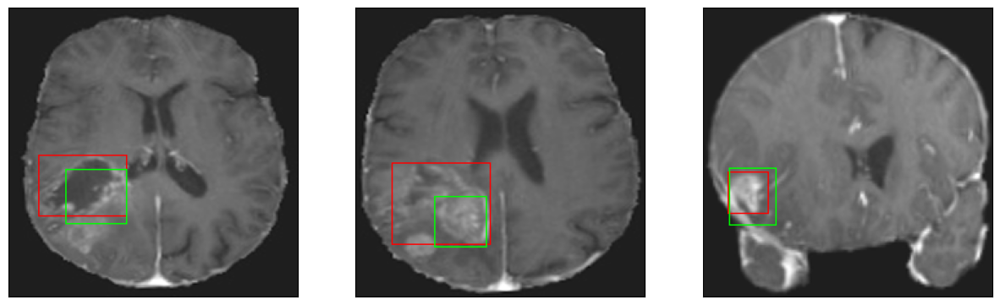

26/26 [==============================] - 3s 124ms/step - loss: 5.6107 - IoU: 0.5851 - val_loss: 8.4995 - val_IoU: 0.4951
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4828 - IoU: 0.5980
Epoch 57: val_loss did not improve from 8.44848
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


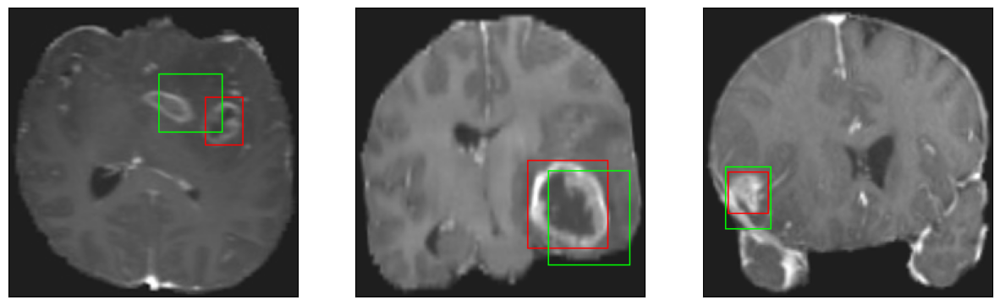

26/26 [==============================] - 3s 118ms/step - loss: 5.4765 - IoU: 0.5977 - val_loss: 8.4760 - val_IoU: 0.4917
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.6476 - IoU: 0.5781
Epoch 58: val_loss did not improve from 8.44848
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


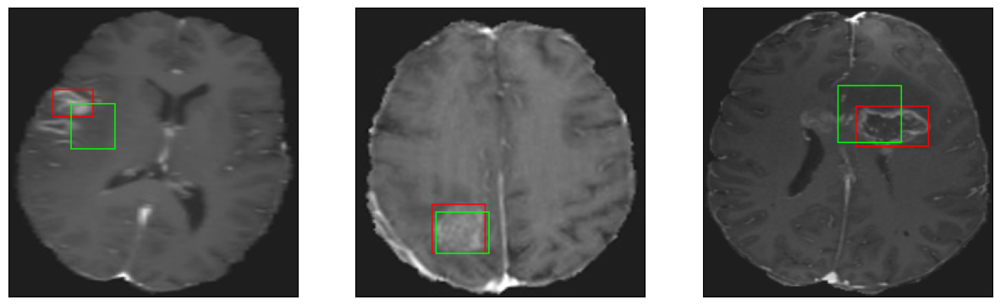

26/26 [==============================] - 4s 156ms/step - loss: 5.6476 - IoU: 0.5781 - val_loss: 10.8159 - val_IoU: 0.4247
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 5.3940 - IoU: 0.5933
Epoch 59: val_loss did not improve from 8.44848
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


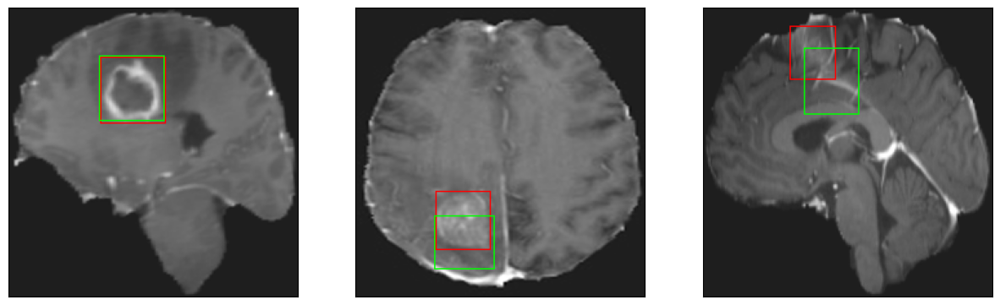

26/26 [==============================] - 3s 132ms/step - loss: 5.3940 - IoU: 0.5933 - val_loss: 8.5551 - val_IoU: 0.5146
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.7688 - IoU: 0.5612
Epoch 60: val_loss did not improve from 8.44848
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


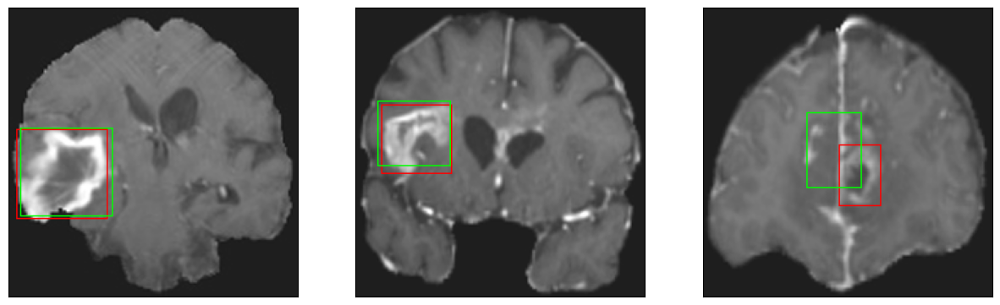

26/26 [==============================] - 3s 118ms/step - loss: 5.7688 - IoU: 0.5612 - val_loss: 9.8977 - val_IoU: 0.4420
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.5779 - IoU: 0.5849
Epoch 61: val_loss improved from 8.44848 to 8.29152, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


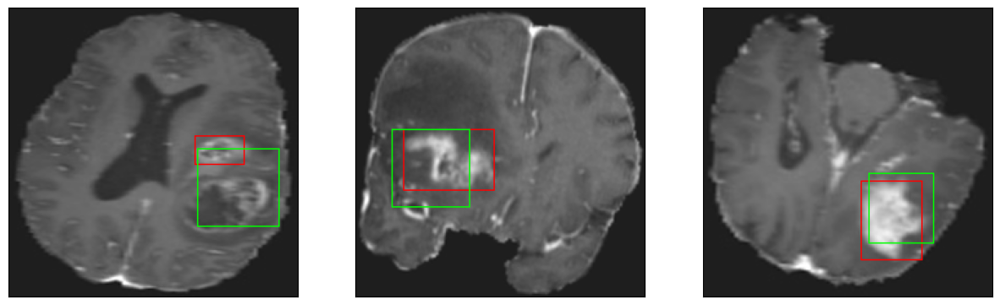

26/26 [==============================] - 5s 211ms/step - loss: 5.5779 - IoU: 0.5849 - val_loss: 8.2915 - val_IoU: 0.5273
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 5.2116 - IoU: 0.6010
Epoch 62: val_loss did not improve from 8.29152
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


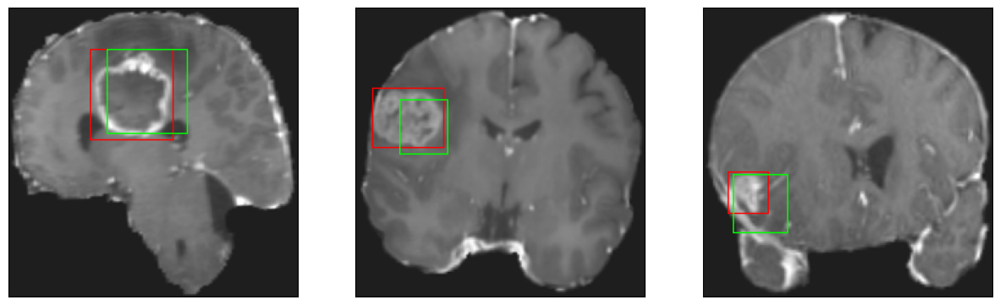

26/26 [==============================] - 3s 111ms/step - loss: 5.2116 - IoU: 0.6010 - val_loss: 8.2982 - val_IoU: 0.5171
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 5.3782 - IoU: 0.5992
Epoch 63: val_loss did not improve from 8.29152
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


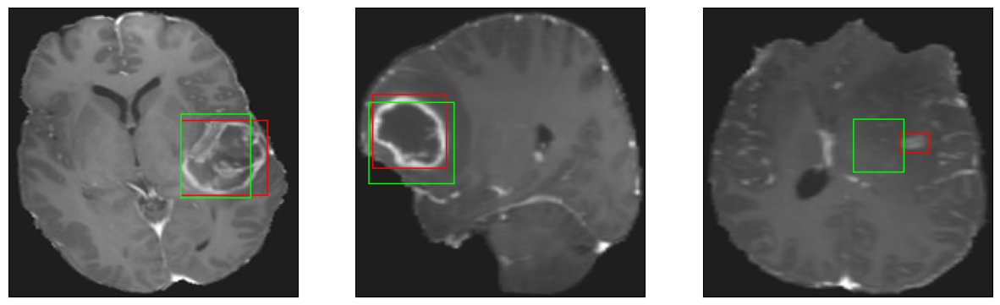

26/26 [==============================] - 3s 114ms/step - loss: 5.3782 - IoU: 0.5992 - val_loss: 9.9240 - val_IoU: 0.4461
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 5.1328 - IoU: 0.6068
Epoch 64: val_loss did not improve from 8.29152
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


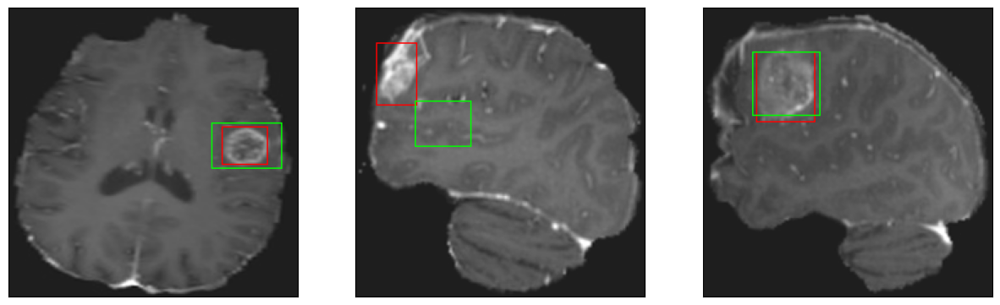

26/26 [==============================] - 4s 143ms/step - loss: 5.1328 - IoU: 0.6068 - val_loss: 10.9385 - val_IoU: 0.4328
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2469 - IoU: 0.6019
Epoch 65: val_loss did not improve from 8.29152
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


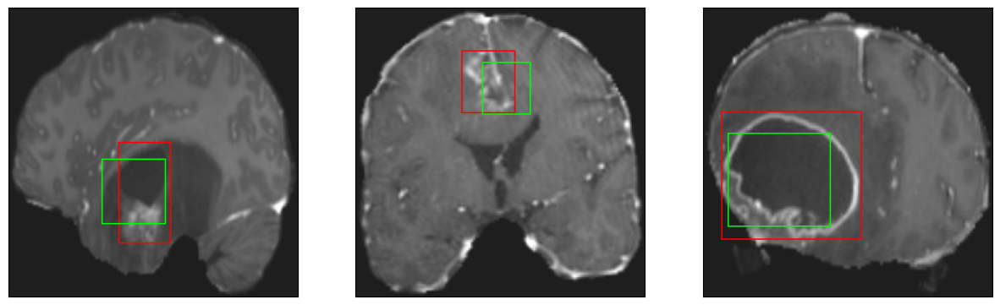

26/26 [==============================] - 3s 123ms/step - loss: 5.2236 - IoU: 0.6031 - val_loss: 10.1857 - val_IoU: 0.4683
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 5.1804 - IoU: 0.6033
Epoch 66: val_loss did not improve from 8.29152
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


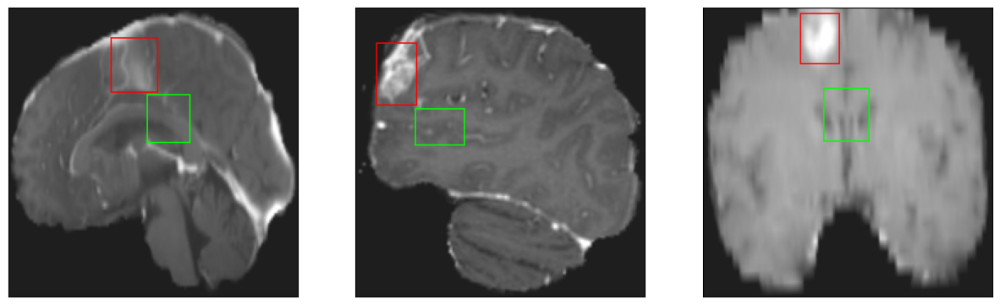

26/26 [==============================] - 3s 127ms/step - loss: 5.1804 - IoU: 0.6033 - val_loss: 10.4877 - val_IoU: 0.4417
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 5.1483 - IoU: 0.6046
Epoch 67: val_loss improved from 8.29152 to 8.09398, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


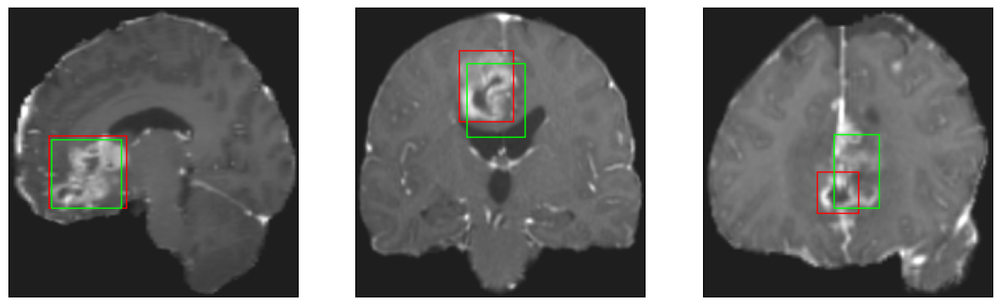

26/26 [==============================] - 4s 168ms/step - loss: 5.1483 - IoU: 0.6046 - val_loss: 8.0940 - val_IoU: 0.5301
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 5.3292 - IoU: 0.5990
Epoch 68: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


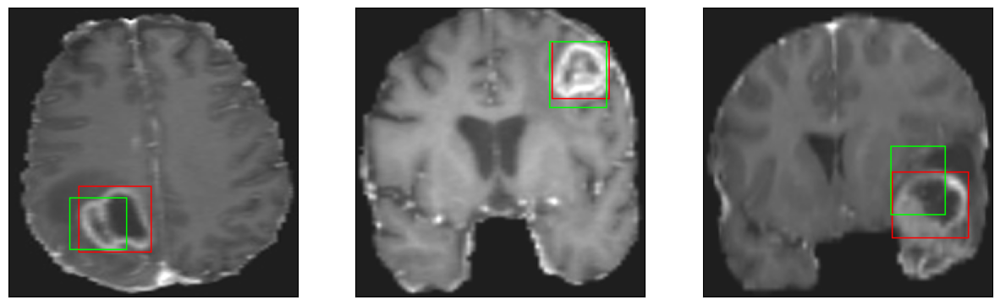

26/26 [==============================] - 4s 139ms/step - loss: 5.3292 - IoU: 0.5990 - val_loss: 9.1496 - val_IoU: 0.4641
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 5.0718 - IoU: 0.6086
Epoch 69: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


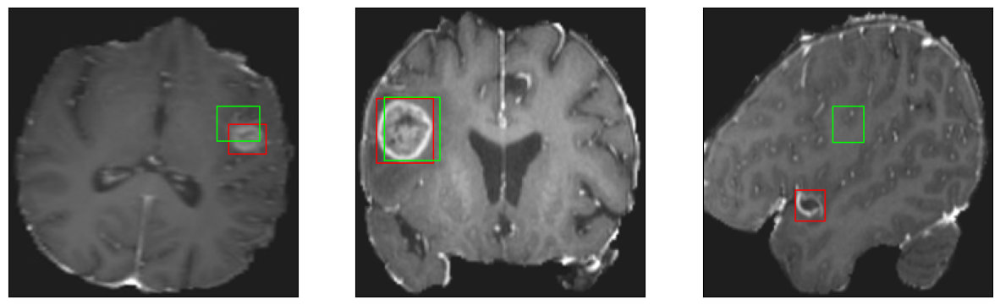

26/26 [==============================] - 3s 133ms/step - loss: 5.0718 - IoU: 0.6086 - val_loss: 9.5649 - val_IoU: 0.4475
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.2556 - IoU: 0.6020
Epoch 70: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


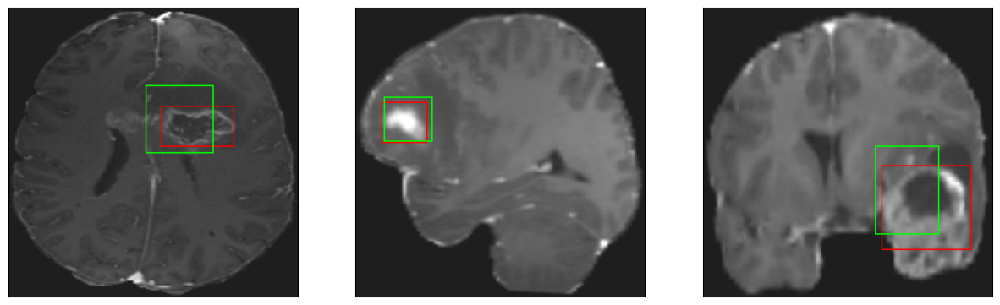

26/26 [==============================] - 3s 121ms/step - loss: 5.2556 - IoU: 0.6020 - val_loss: 9.0735 - val_IoU: 0.4838
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5671 - IoU: 0.5892
Epoch 71: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


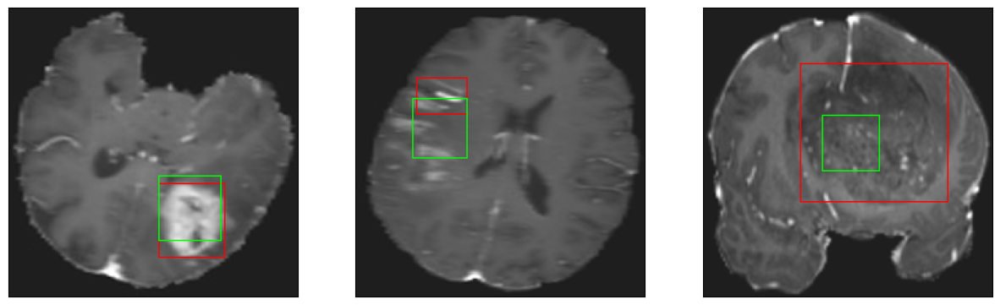

26/26 [==============================] - 3s 114ms/step - loss: 5.5990 - IoU: 0.5880 - val_loss: 10.3096 - val_IoU: 0.4355
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 5.1985 - IoU: 0.6035
Epoch 72: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 10ms/step
4


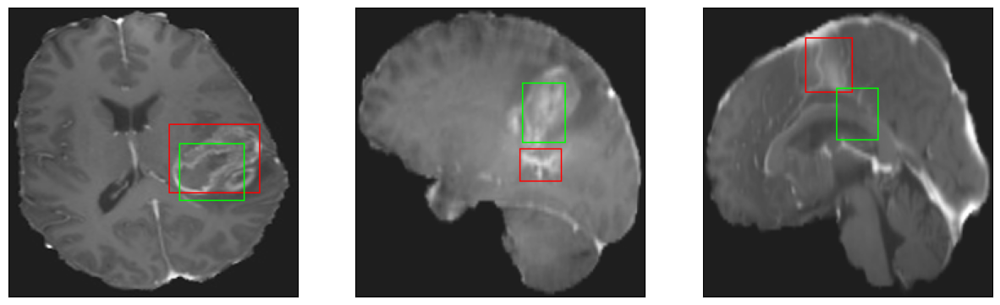

26/26 [==============================] - 4s 146ms/step - loss: 5.1985 - IoU: 0.6035 - val_loss: 10.0846 - val_IoU: 0.4180
Epoch 73/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2712 - IoU: 0.5976
Epoch 73: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


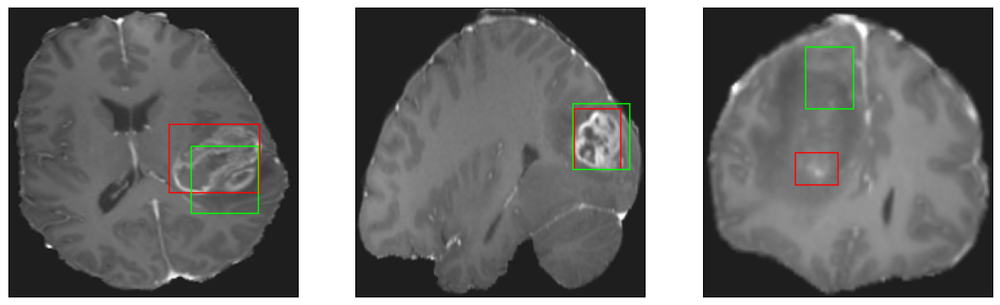

26/26 [==============================] - 3s 125ms/step - loss: 5.2696 - IoU: 0.5968 - val_loss: 9.2992 - val_IoU: 0.4562
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.3324 - IoU: 0.5929
Epoch 74: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


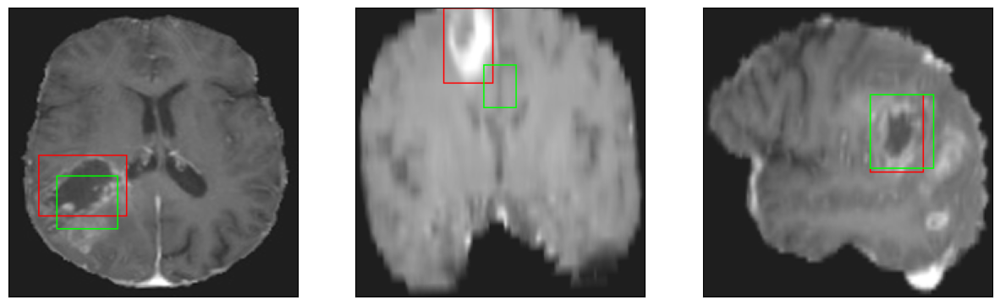

26/26 [==============================] - 3s 119ms/step - loss: 5.3324 - IoU: 0.5929 - val_loss: 8.3115 - val_IoU: 0.5236
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 5.4895 - IoU: 0.6002
Epoch 75: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 11ms/step
4


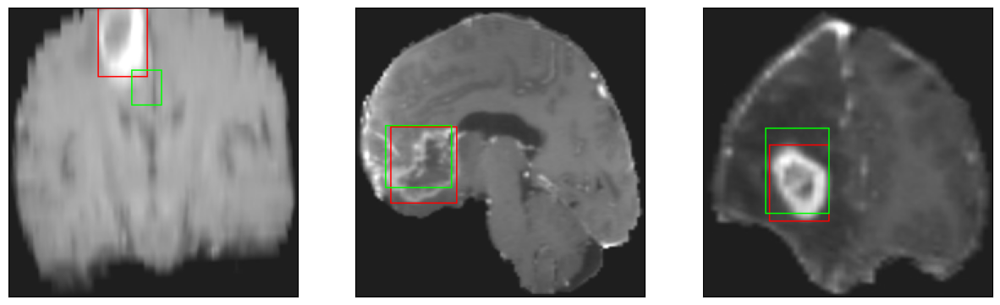

26/26 [==============================] - 4s 138ms/step - loss: 5.4895 - IoU: 0.6002 - val_loss: 9.2077 - val_IoU: 0.4737
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2495 - IoU: 0.6011
Epoch 76: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


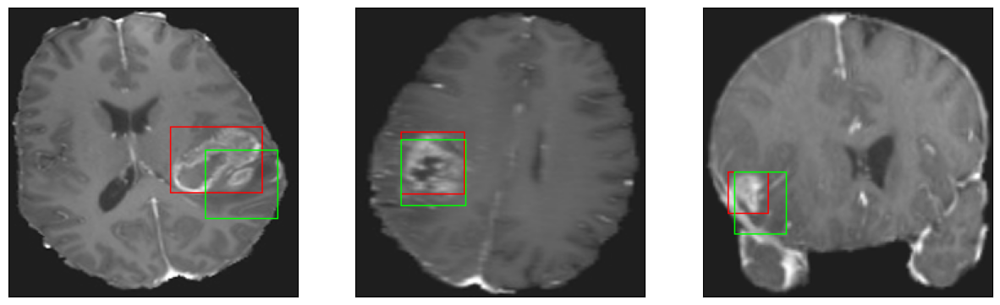

26/26 [==============================] - 4s 137ms/step - loss: 5.3088 - IoU: 0.5994 - val_loss: 8.1779 - val_IoU: 0.5127
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 5.0267 - IoU: 0.6135
Epoch 77: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


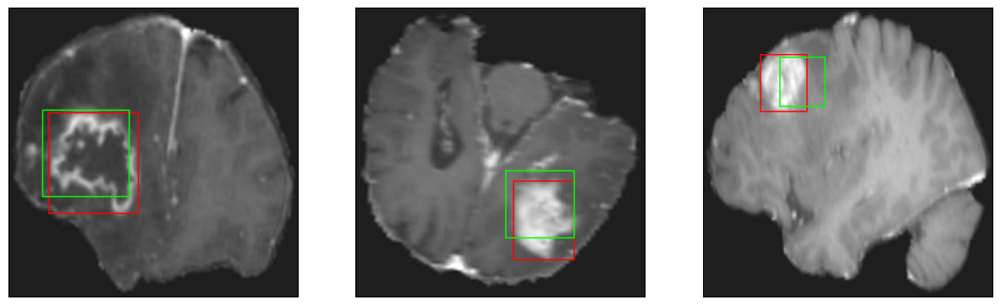

26/26 [==============================] - 3s 111ms/step - loss: 5.0267 - IoU: 0.6135 - val_loss: 8.9468 - val_IoU: 0.4884
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2931 - IoU: 0.5973
Epoch 78: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


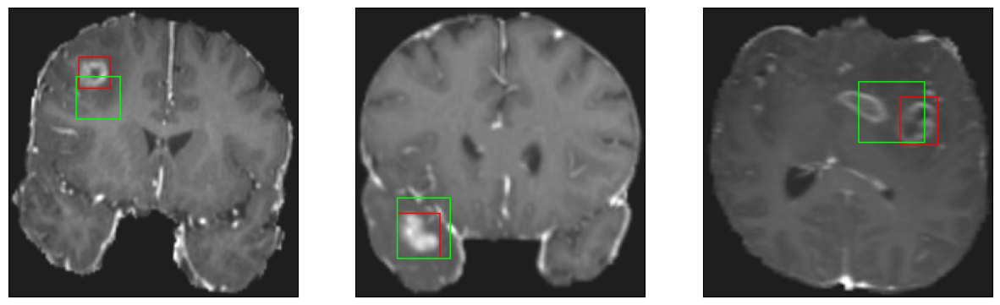

26/26 [==============================] - 3s 125ms/step - loss: 5.3110 - IoU: 0.5971 - val_loss: 8.4163 - val_IoU: 0.5097
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 4.9701 - IoU: 0.6185
Epoch 79: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


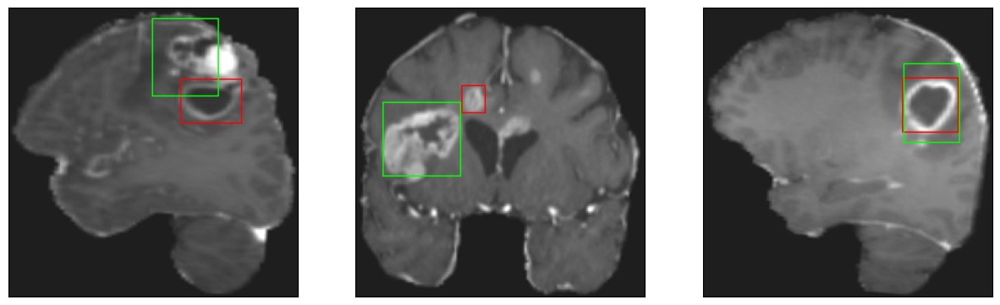

26/26 [==============================] - 4s 138ms/step - loss: 4.9701 - IoU: 0.6185 - val_loss: 8.8720 - val_IoU: 0.4888
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 5.2427 - IoU: 0.5998
Epoch 80: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


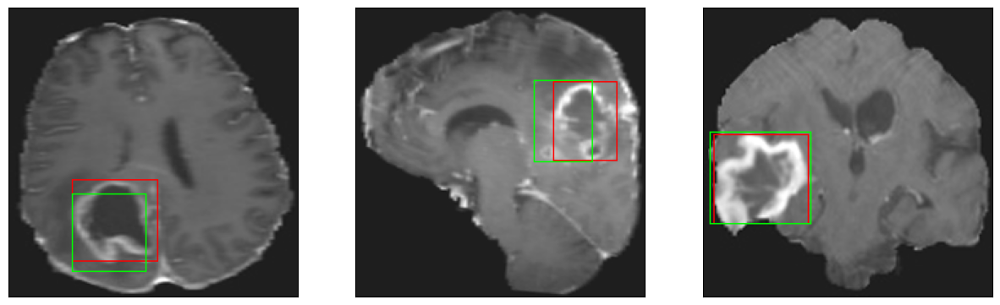

26/26 [==============================] - 3s 120ms/step - loss: 5.2427 - IoU: 0.5998 - val_loss: 8.6621 - val_IoU: 0.5046
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 5.3352 - IoU: 0.6022
Epoch 81: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


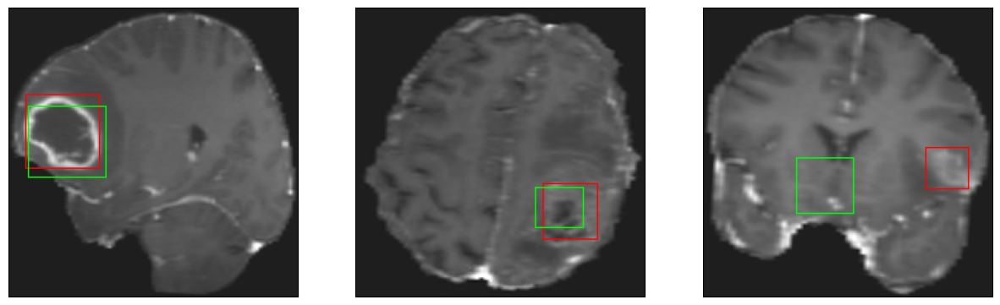

26/26 [==============================] - 4s 139ms/step - loss: 5.3352 - IoU: 0.6022 - val_loss: 12.0896 - val_IoU: 0.3870
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 5.2093 - IoU: 0.5948
Epoch 82: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


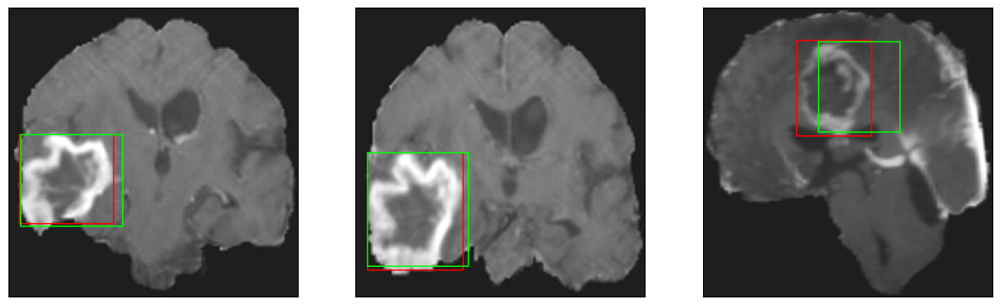

26/26 [==============================] - 4s 144ms/step - loss: 5.2093 - IoU: 0.5948 - val_loss: 8.4998 - val_IoU: 0.5228
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 5.0383 - IoU: 0.6055
Epoch 83: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


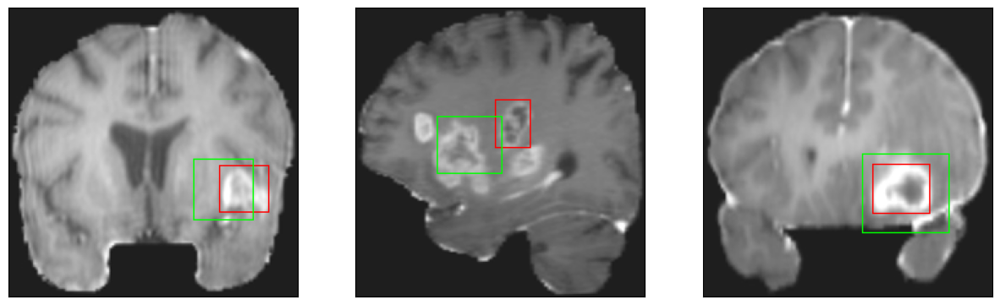

26/26 [==============================] - 3s 131ms/step - loss: 5.0383 - IoU: 0.6055 - val_loss: 8.3642 - val_IoU: 0.5174
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9191 - IoU: 0.6214
Epoch 84: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


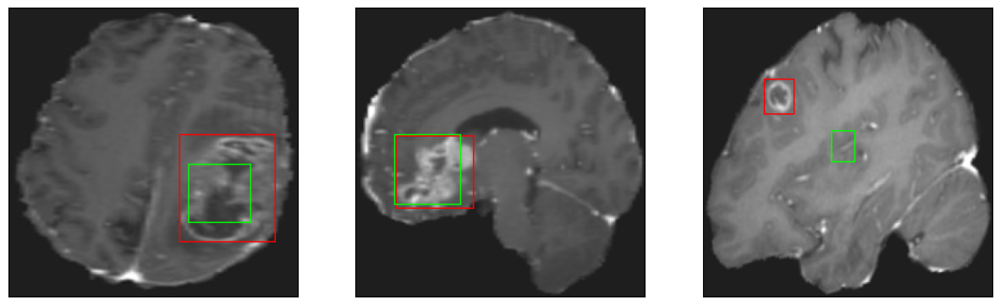

26/26 [==============================] - 3s 114ms/step - loss: 4.9196 - IoU: 0.6212 - val_loss: 9.1770 - val_IoU: 0.4813
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 5.0434 - IoU: 0.6097
Epoch 85: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


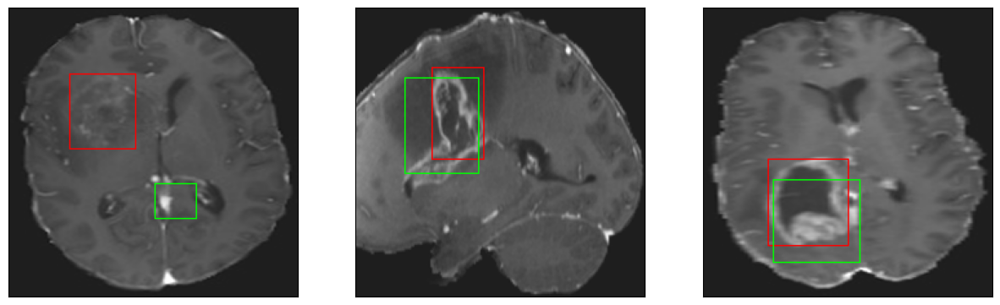

26/26 [==============================] - 3s 118ms/step - loss: 5.0434 - IoU: 0.6097 - val_loss: 8.3478 - val_IoU: 0.5238
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3269 - IoU: 0.5998
Epoch 86: val_loss did not improve from 8.09398
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4


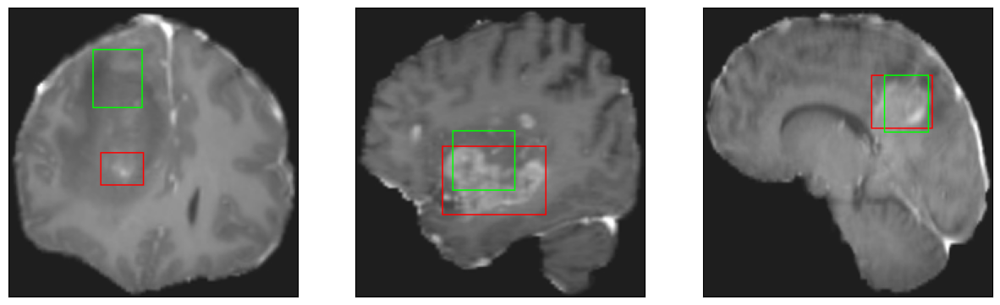

26/26 [==============================] - 4s 136ms/step - loss: 5.3198 - IoU: 0.6000 - val_loss: 8.7212 - val_IoU: 0.4976
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 4.9460 - IoU: 0.6176
Epoch 87: val_loss improved from 8.09398 to 7.64546, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


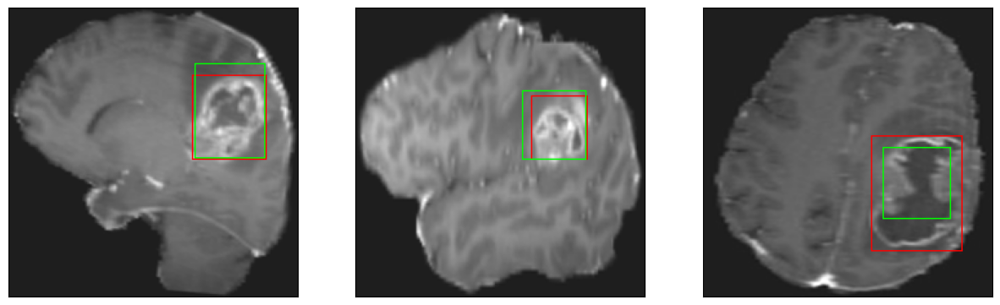

26/26 [==============================] - 5s 195ms/step - loss: 4.9460 - IoU: 0.6176 - val_loss: 7.6455 - val_IoU: 0.5675
Epoch 88/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7232 - IoU: 0.6273
Epoch 88: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


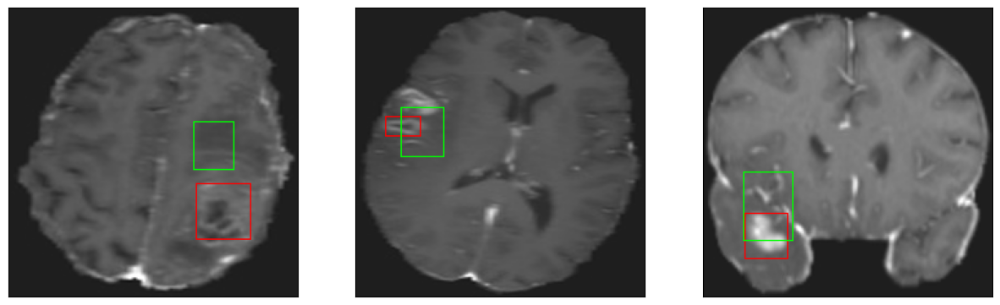

26/26 [==============================] - 3s 126ms/step - loss: 4.7895 - IoU: 0.6251 - val_loss: 10.8335 - val_IoU: 0.4170
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 4.9156 - IoU: 0.6201
Epoch 89: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


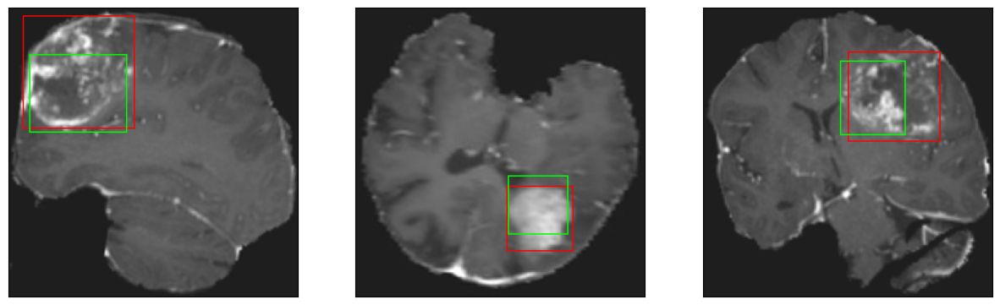

26/26 [==============================] - 3s 130ms/step - loss: 4.9156 - IoU: 0.6201 - val_loss: 9.2383 - val_IoU: 0.4880
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 4.8409 - IoU: 0.6145
Epoch 90: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


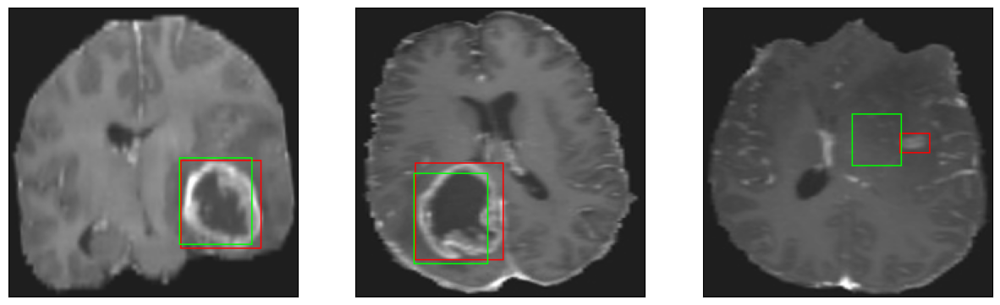

26/26 [==============================] - 3s 132ms/step - loss: 4.8409 - IoU: 0.6145 - val_loss: 8.8293 - val_IoU: 0.4913
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 4.7818 - IoU: 0.6288
Epoch 91: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


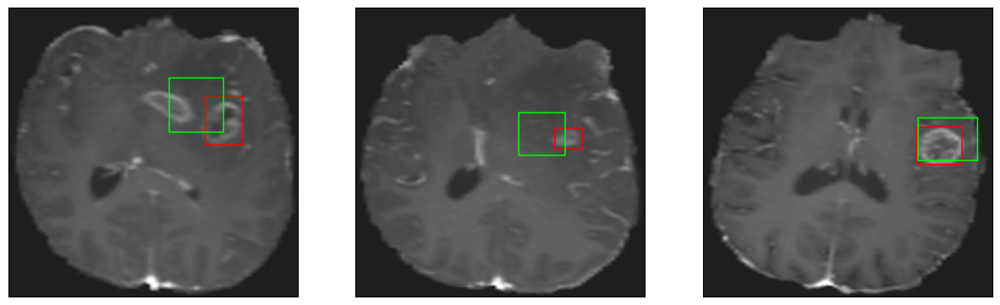

26/26 [==============================] - 4s 147ms/step - loss: 4.7818 - IoU: 0.6288 - val_loss: 8.6534 - val_IoU: 0.4905
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8049 - IoU: 0.6223
Epoch 92: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


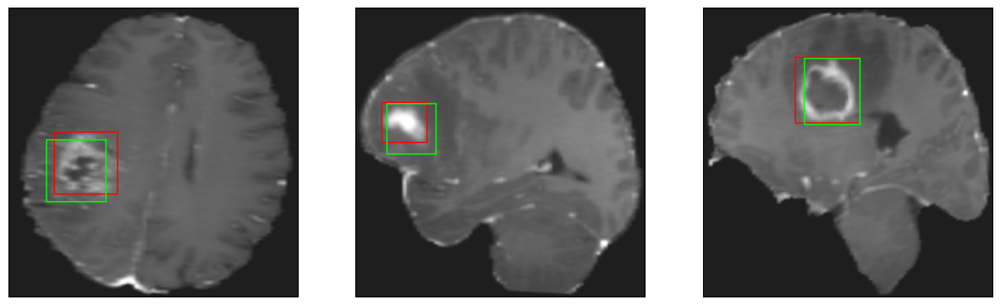

26/26 [==============================] - 3s 118ms/step - loss: 4.7711 - IoU: 0.6241 - val_loss: 8.2190 - val_IoU: 0.5333
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 4.7377 - IoU: 0.6241
Epoch 93: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


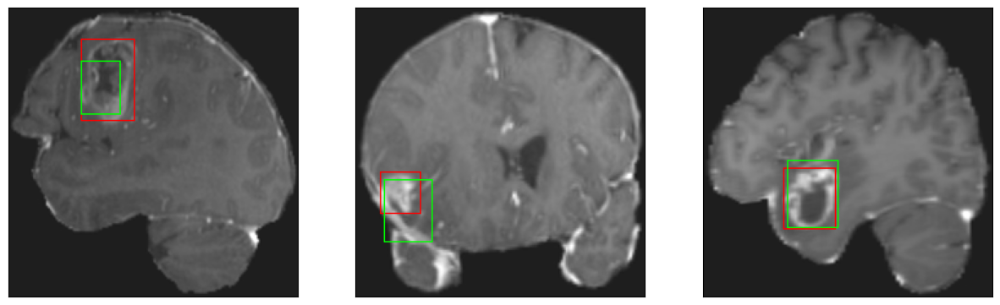

26/26 [==============================] - 3s 117ms/step - loss: 4.7377 - IoU: 0.6241 - val_loss: 8.2681 - val_IoU: 0.5185
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 4.9532 - IoU: 0.6189
Epoch 94: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


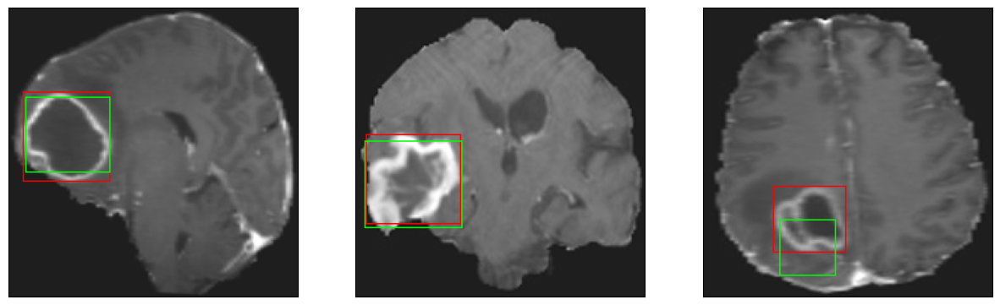

26/26 [==============================] - 4s 149ms/step - loss: 4.9532 - IoU: 0.6189 - val_loss: 8.8453 - val_IoU: 0.4815
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 4.8550 - IoU: 0.6279
Epoch 95: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


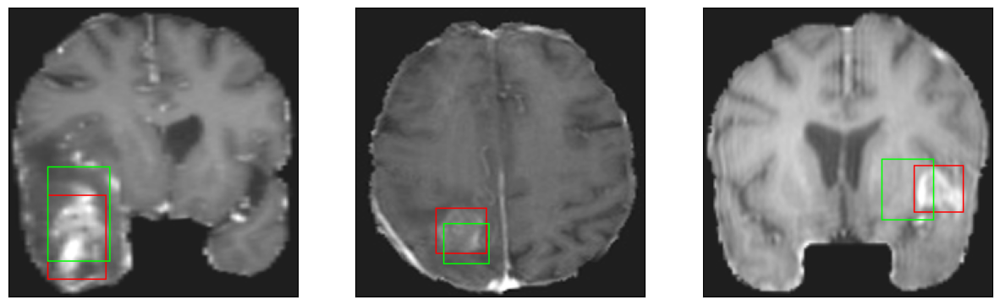

26/26 [==============================] - 4s 138ms/step - loss: 4.8550 - IoU: 0.6279 - val_loss: 8.3186 - val_IoU: 0.5208
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.8538 - IoU: 0.6252
Epoch 96: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


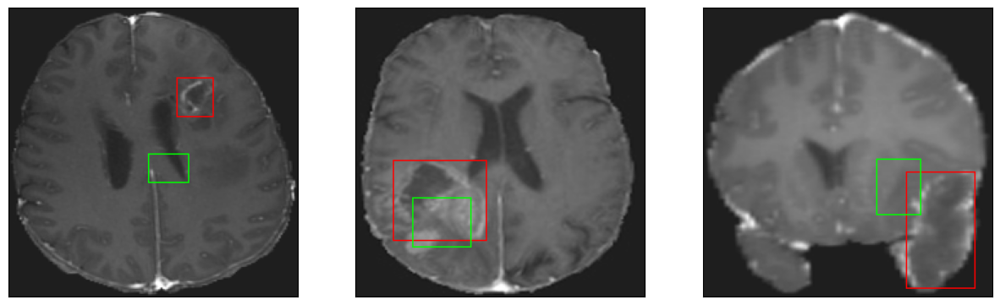

26/26 [==============================] - 3s 113ms/step - loss: 4.8538 - IoU: 0.6252 - val_loss: 9.7573 - val_IoU: 0.4443
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.7219 - IoU: 0.6315
Epoch 97: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


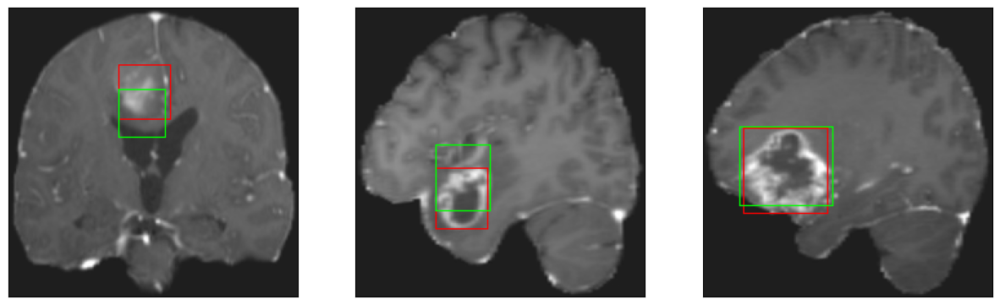

26/26 [==============================] - 3s 122ms/step - loss: 4.7219 - IoU: 0.6315 - val_loss: 8.8395 - val_IoU: 0.4917
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 4.9331 - IoU: 0.6181
Epoch 98: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4


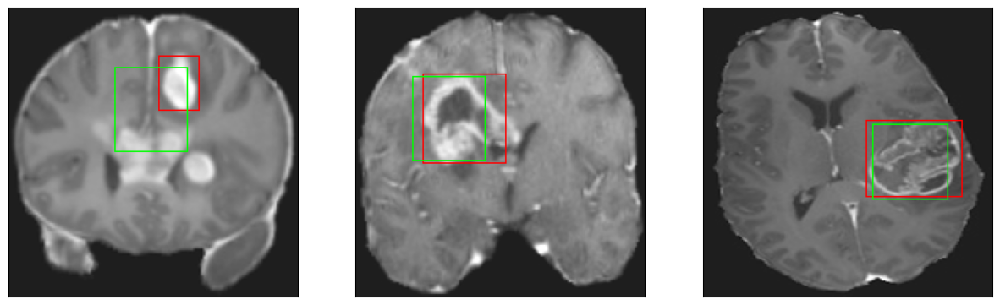

26/26 [==============================] - 4s 142ms/step - loss: 4.9331 - IoU: 0.6181 - val_loss: 8.7634 - val_IoU: 0.5135
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.7856 - IoU: 0.6259
Epoch 99: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


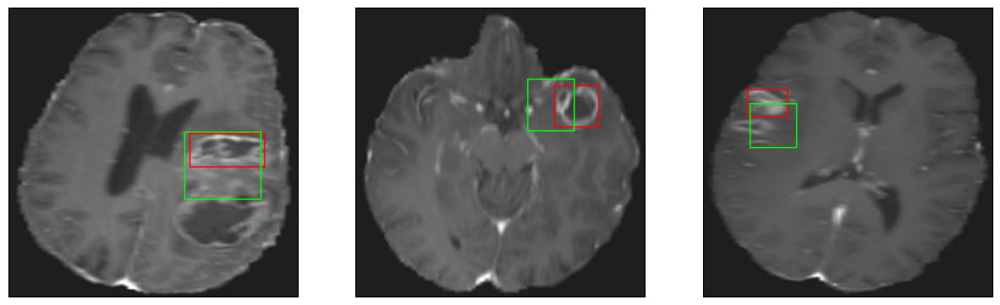

26/26 [==============================] - 3s 128ms/step - loss: 4.7856 - IoU: 0.6259 - val_loss: 9.0051 - val_IoU: 0.4807
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 4.7243 - IoU: 0.6368
Epoch 100: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


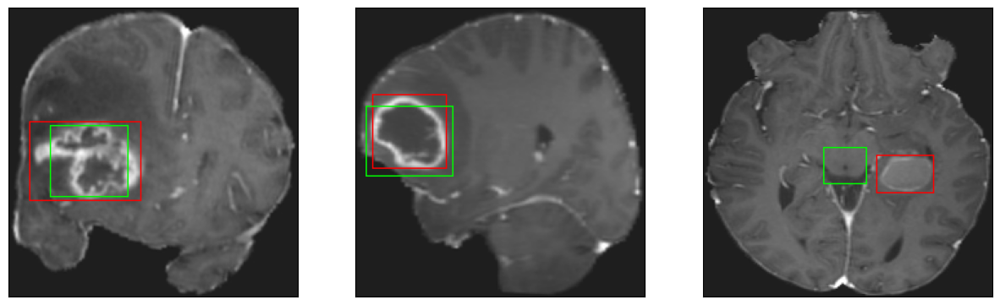

26/26 [==============================] - 3s 123ms/step - loss: 4.7243 - IoU: 0.6368 - val_loss: 8.5932 - val_IoU: 0.5153
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 5.0216 - IoU: 0.6114
Epoch 101: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


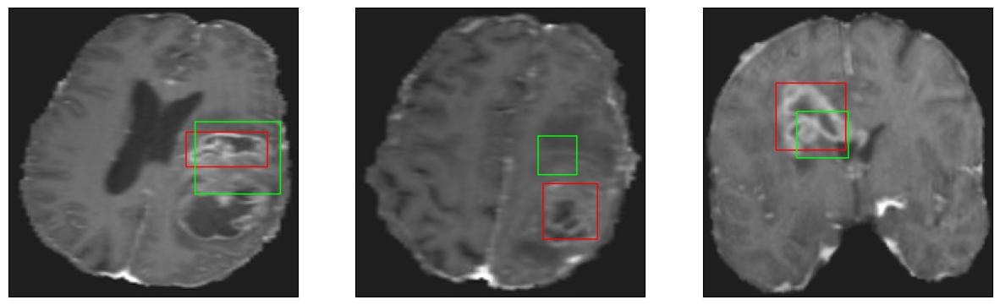

26/26 [==============================] - 3s 119ms/step - loss: 5.0216 - IoU: 0.6114 - val_loss: 9.6903 - val_IoU: 0.4484
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8858 - IoU: 0.6172
Epoch 102: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


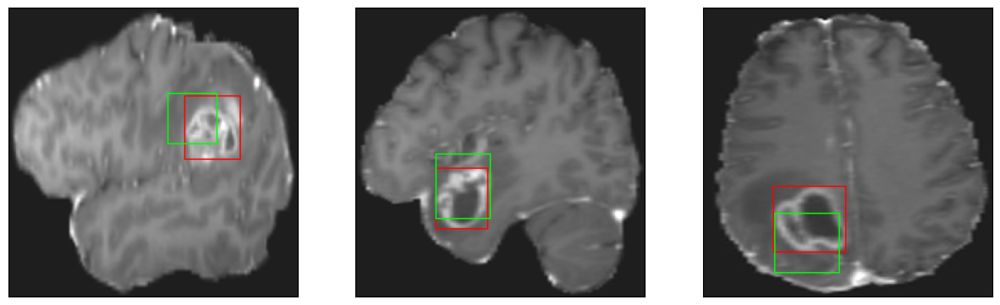

26/26 [==============================] - 4s 155ms/step - loss: 4.8467 - IoU: 0.6198 - val_loss: 9.3497 - val_IoU: 0.4765
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7034 - IoU: 0.6225
Epoch 103: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


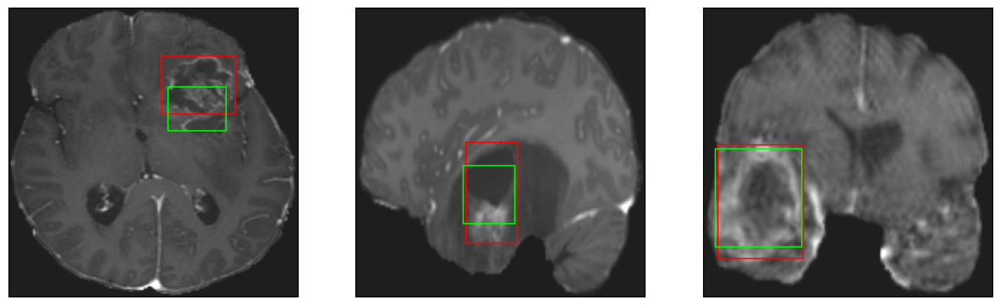

26/26 [==============================] - 3s 123ms/step - loss: 4.7620 - IoU: 0.6203 - val_loss: 8.3444 - val_IoU: 0.5332
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8483 - IoU: 0.6150
Epoch 104: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


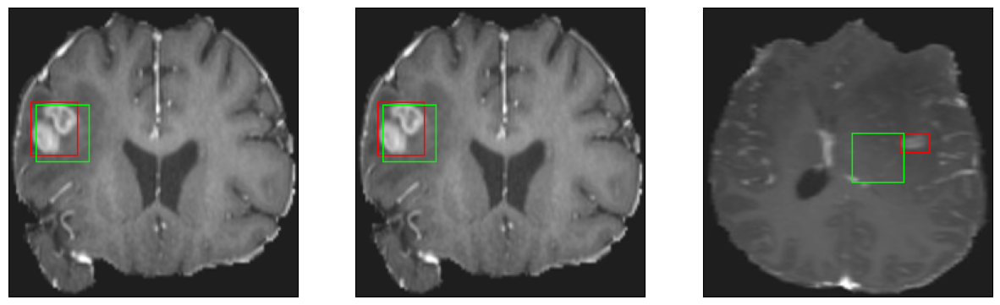

26/26 [==============================] - 3s 113ms/step - loss: 4.8093 - IoU: 0.6194 - val_loss: 7.9730 - val_IoU: 0.5478
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7409 - IoU: 0.6313
Epoch 105: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


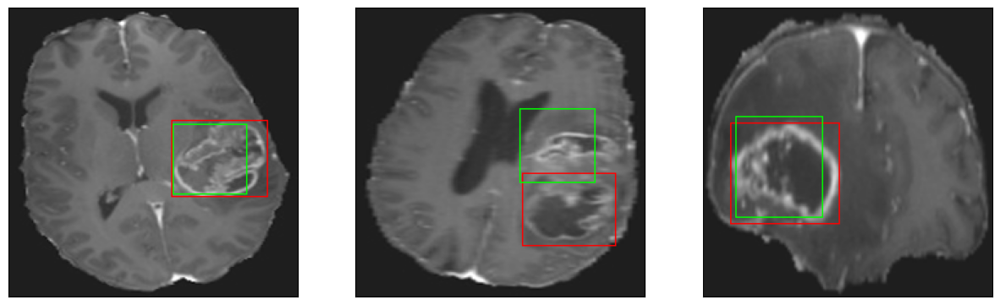

26/26 [==============================] - 3s 119ms/step - loss: 4.7028 - IoU: 0.6324 - val_loss: 8.9797 - val_IoU: 0.4849
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 4.6364 - IoU: 0.6345
Epoch 106: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


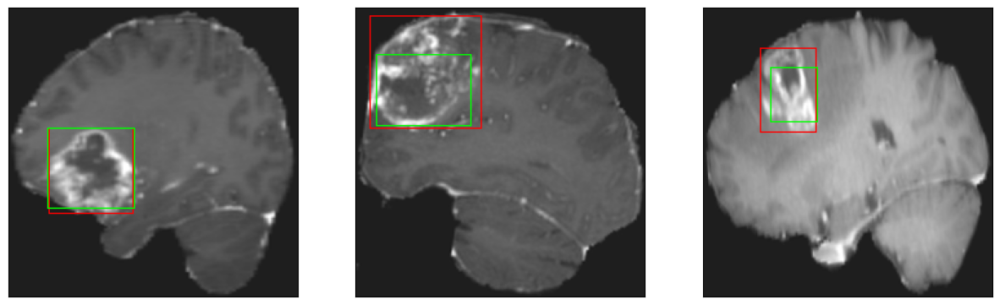

26/26 [==============================] - 3s 125ms/step - loss: 4.6364 - IoU: 0.6345 - val_loss: 8.0169 - val_IoU: 0.5453
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.9914 - IoU: 0.6168
Epoch 107: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


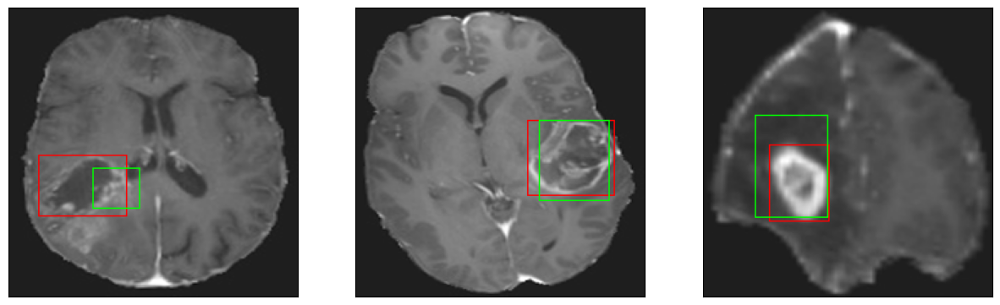

26/26 [==============================] - 4s 149ms/step - loss: 4.9914 - IoU: 0.6168 - val_loss: 7.8944 - val_IoU: 0.5439
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8782 - IoU: 0.6284
Epoch 108: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


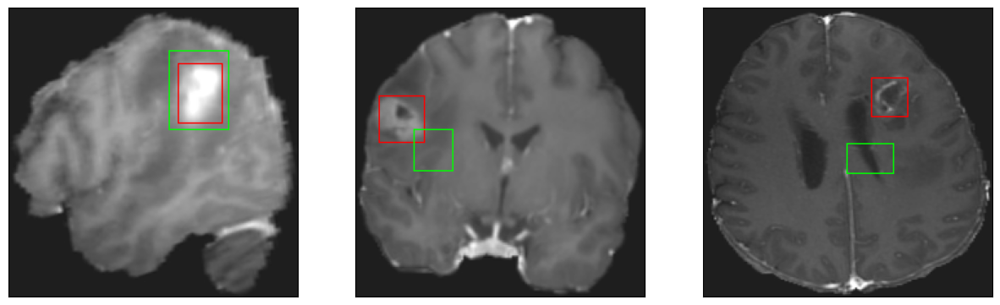

26/26 [==============================] - 3s 118ms/step - loss: 4.8814 - IoU: 0.6277 - val_loss: 7.9860 - val_IoU: 0.5413
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6809 - IoU: 0.6311
Epoch 109: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


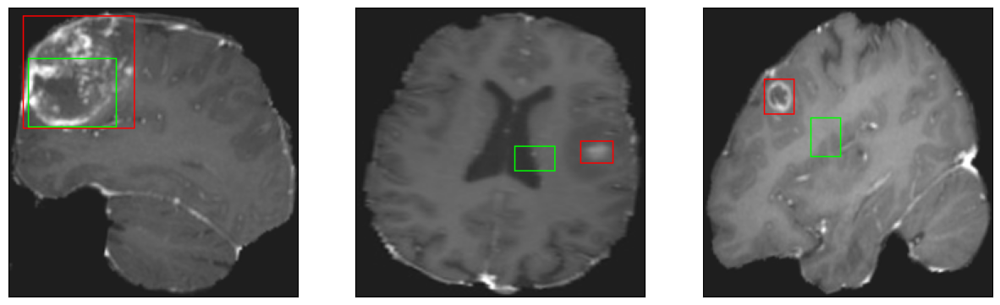

26/26 [==============================] - 3s 105ms/step - loss: 4.6877 - IoU: 0.6298 - val_loss: 12.1257 - val_IoU: 0.3667
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8130 - IoU: 0.6230
Epoch 110: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


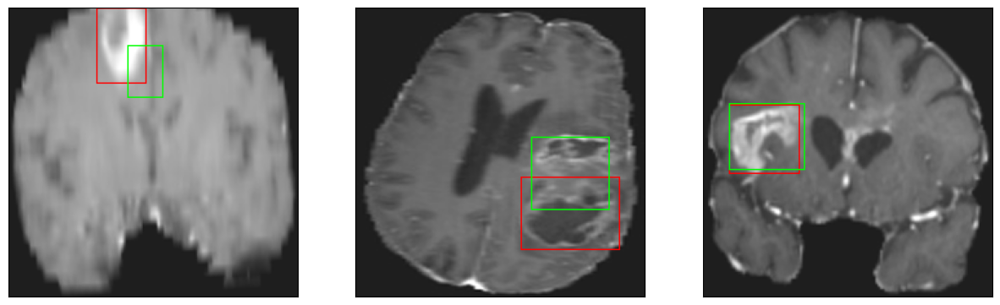

26/26 [==============================] - 4s 139ms/step - loss: 4.7857 - IoU: 0.6237 - val_loss: 7.9396 - val_IoU: 0.5441
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5919 - IoU: 0.6416
Epoch 111: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


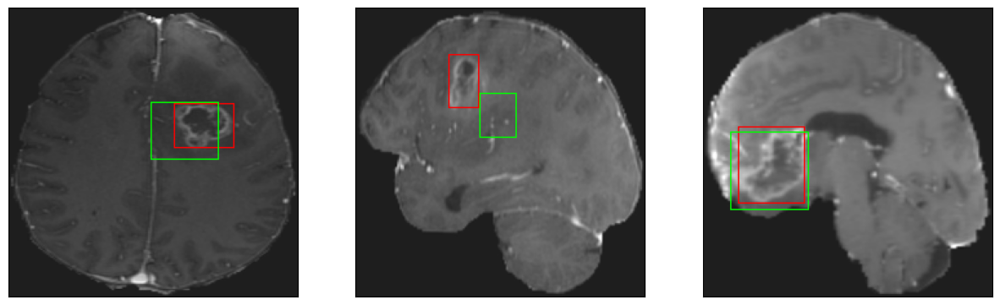

26/26 [==============================] - 3s 120ms/step - loss: 4.5956 - IoU: 0.6402 - val_loss: 9.0216 - val_IoU: 0.4748
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 4.7112 - IoU: 0.6248
Epoch 112: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


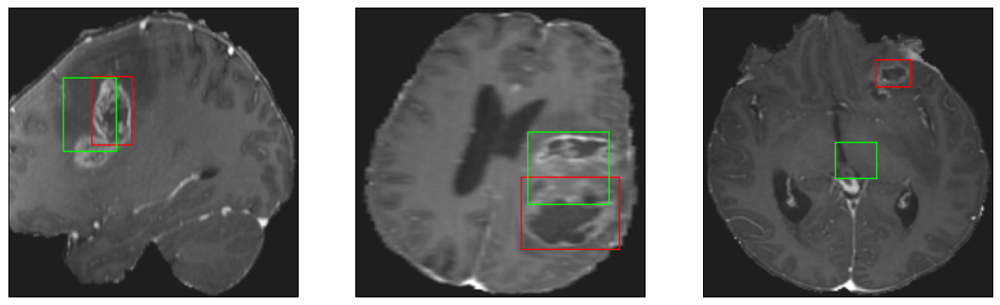

26/26 [==============================] - 3s 126ms/step - loss: 4.7112 - IoU: 0.6248 - val_loss: 8.5091 - val_IoU: 0.4981
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6528 - IoU: 0.6324
Epoch 113: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


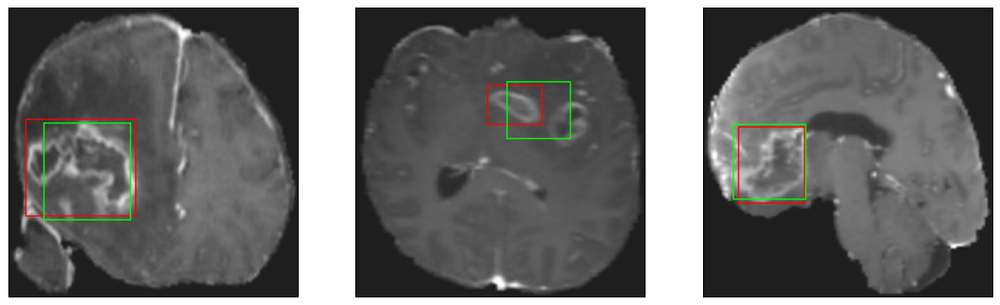

26/26 [==============================] - 3s 118ms/step - loss: 4.6225 - IoU: 0.6346 - val_loss: 7.9740 - val_IoU: 0.5465
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.6485 - IoU: 0.6384
Epoch 114: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4


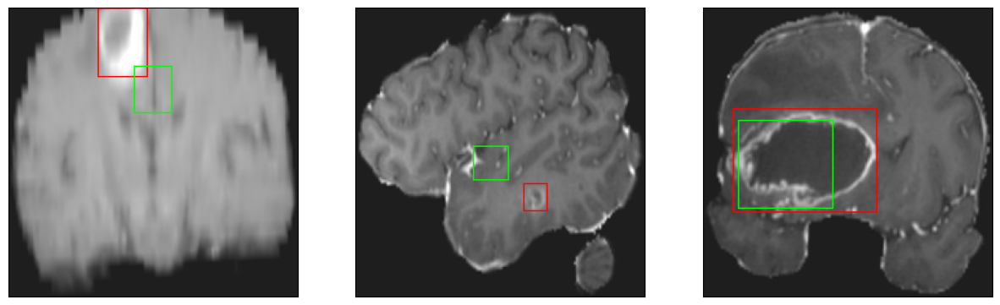

26/26 [==============================] - 4s 141ms/step - loss: 4.6485 - IoU: 0.6384 - val_loss: 8.7836 - val_IoU: 0.4798
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 4.8233 - IoU: 0.6240
Epoch 115: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


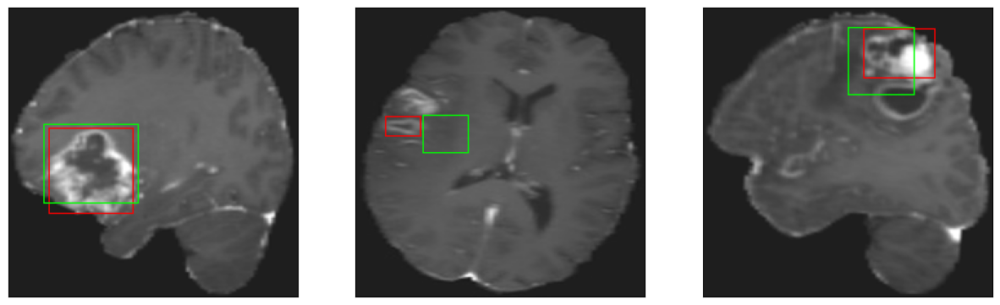

26/26 [==============================] - 3s 124ms/step - loss: 4.8233 - IoU: 0.6240 - val_loss: 8.3244 - val_IoU: 0.5374
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.6742 - IoU: 0.6354
Epoch 116: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


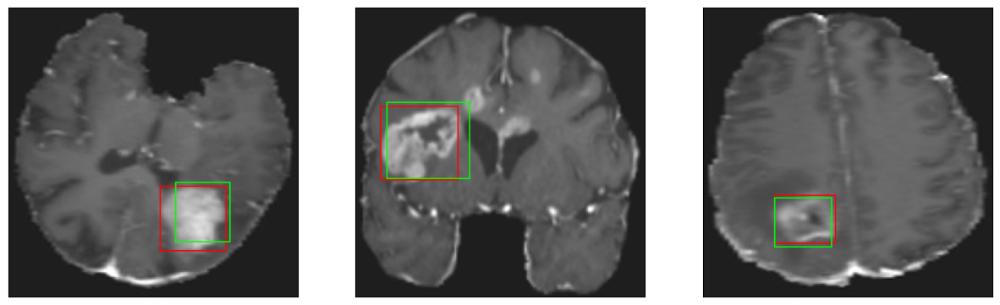

26/26 [==============================] - 3s 131ms/step - loss: 4.6742 - IoU: 0.6354 - val_loss: 8.0553 - val_IoU: 0.5449
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 4.5533 - IoU: 0.6411
Epoch 117: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


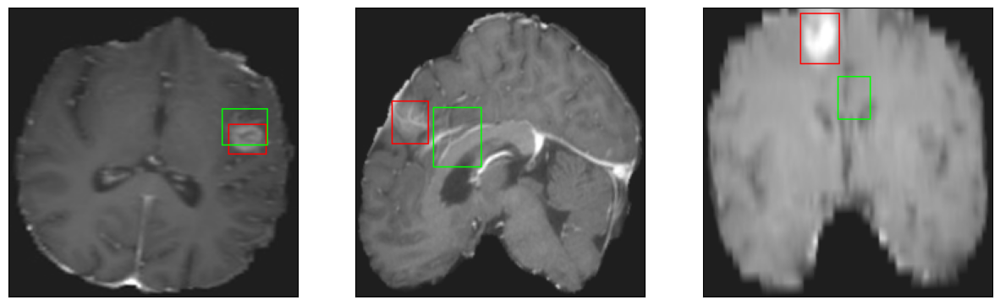

26/26 [==============================] - 3s 132ms/step - loss: 4.5533 - IoU: 0.6411 - val_loss: 8.1086 - val_IoU: 0.5172
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.6518 - IoU: 0.6344
Epoch 118: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


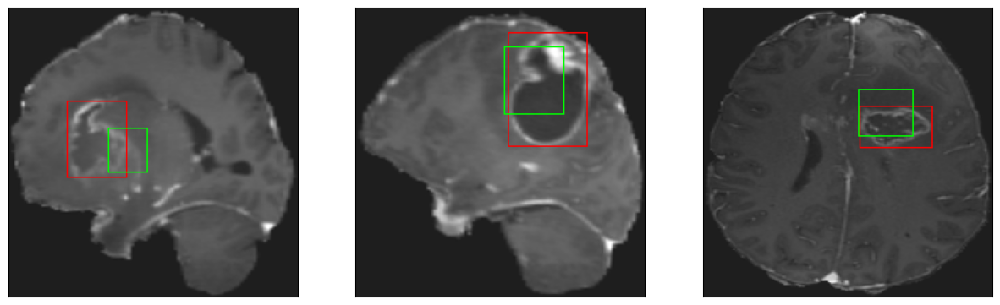

26/26 [==============================] - 4s 148ms/step - loss: 4.6518 - IoU: 0.6344 - val_loss: 8.4737 - val_IoU: 0.5081
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.5366 - IoU: 0.6450
Epoch 119: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


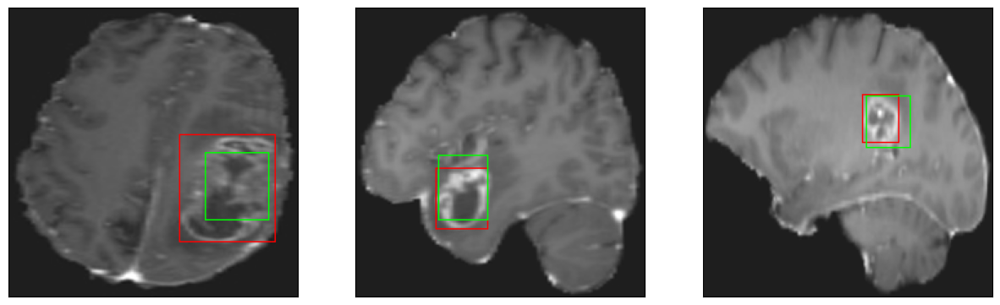

26/26 [==============================] - 4s 134ms/step - loss: 4.5366 - IoU: 0.6450 - val_loss: 7.9102 - val_IoU: 0.5474
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.6717 - IoU: 0.6362
Epoch 120: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4


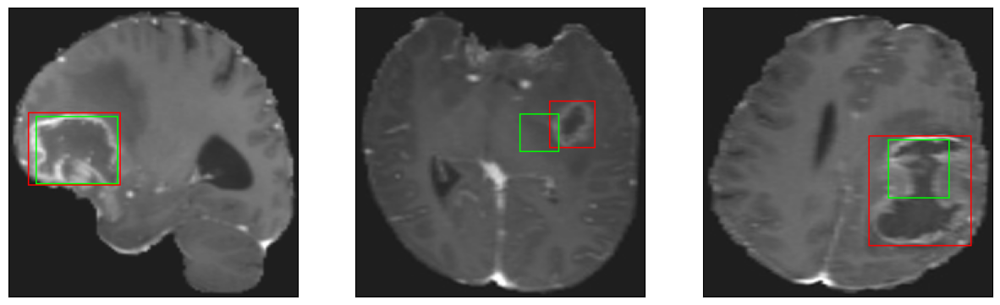

26/26 [==============================] - 4s 164ms/step - loss: 4.6717 - IoU: 0.6362 - val_loss: 10.5520 - val_IoU: 0.4141
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5832 - IoU: 0.6413
Epoch 121: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


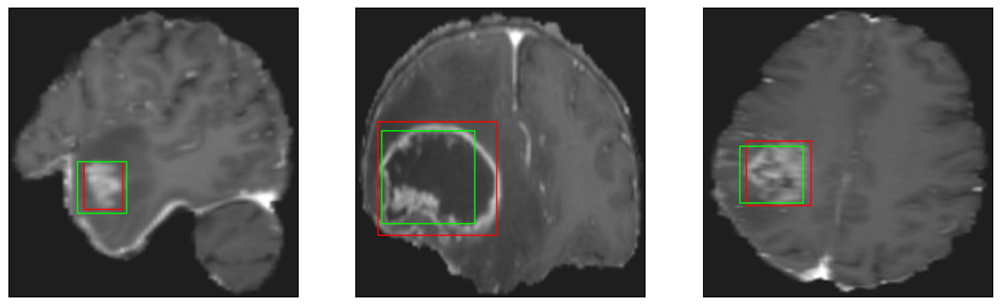

26/26 [==============================] - 4s 145ms/step - loss: 4.5468 - IoU: 0.6424 - val_loss: 8.0341 - val_IoU: 0.5434
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 4.4497 - IoU: 0.6453
Epoch 122: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


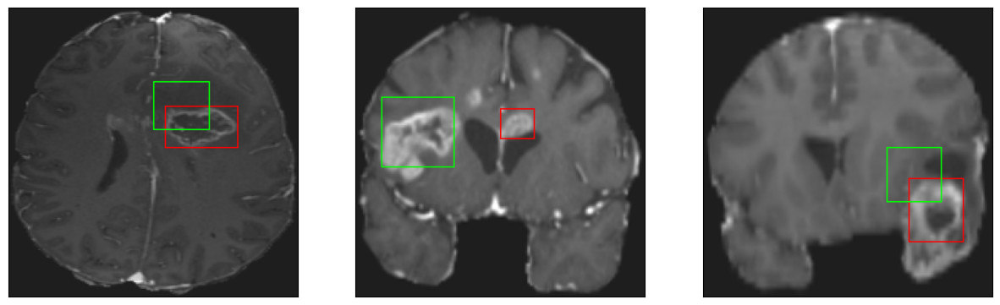

26/26 [==============================] - 4s 166ms/step - loss: 4.4497 - IoU: 0.6453 - val_loss: 12.6758 - val_IoU: 0.3471
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 4.5617 - IoU: 0.6447
Epoch 123: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


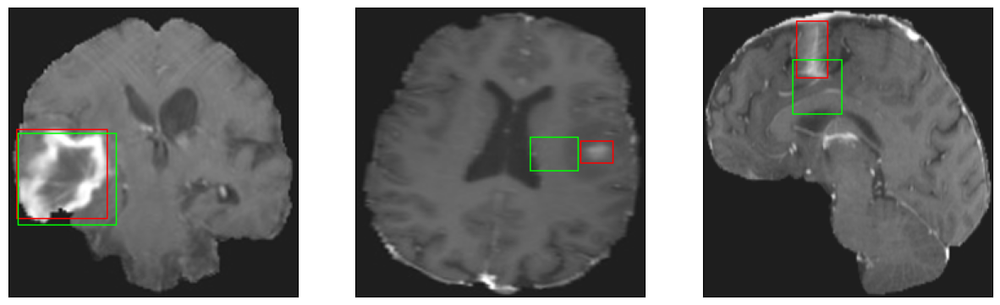

26/26 [==============================] - 3s 118ms/step - loss: 4.5617 - IoU: 0.6447 - val_loss: 10.6779 - val_IoU: 0.4420
Epoch 124/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5589 - IoU: 0.6421
Epoch 124: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


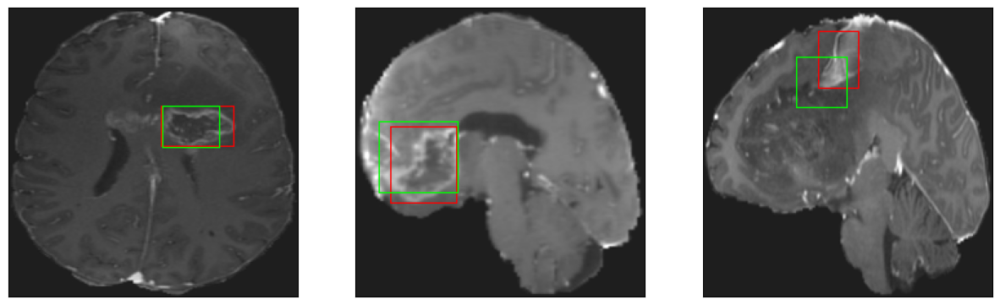

26/26 [==============================] - 3s 114ms/step - loss: 4.5593 - IoU: 0.6402 - val_loss: 8.6925 - val_IoU: 0.5133
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8342 - IoU: 0.6240
Epoch 125: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


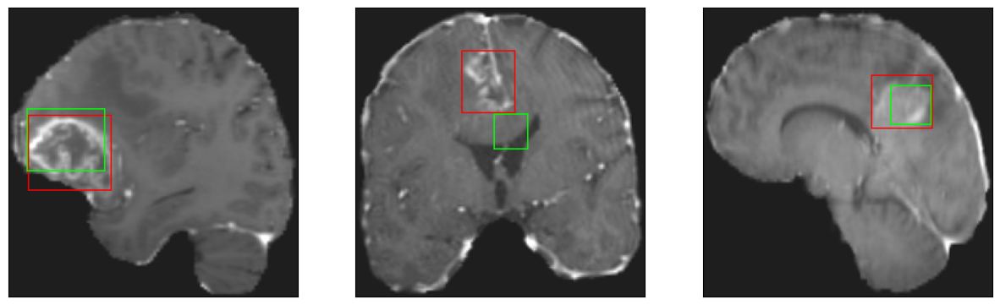

26/26 [==============================] - 3s 119ms/step - loss: 4.7741 - IoU: 0.6275 - val_loss: 11.6876 - val_IoU: 0.3768
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 4.6765 - IoU: 0.6410
Epoch 126: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


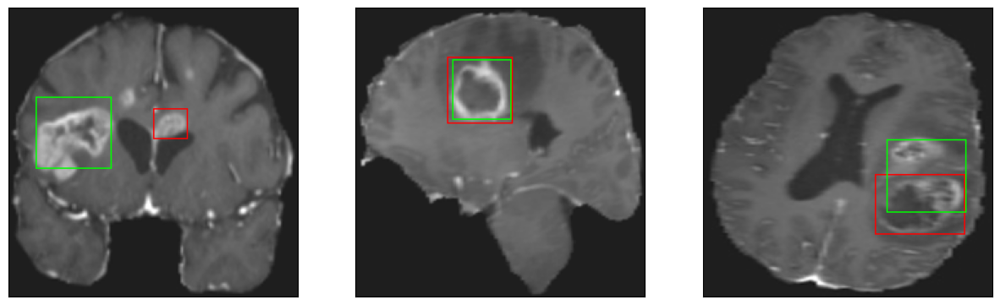

26/26 [==============================] - 4s 142ms/step - loss: 4.6765 - IoU: 0.6410 - val_loss: 8.2220 - val_IoU: 0.5220
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9114 - IoU: 0.6130
Epoch 127: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


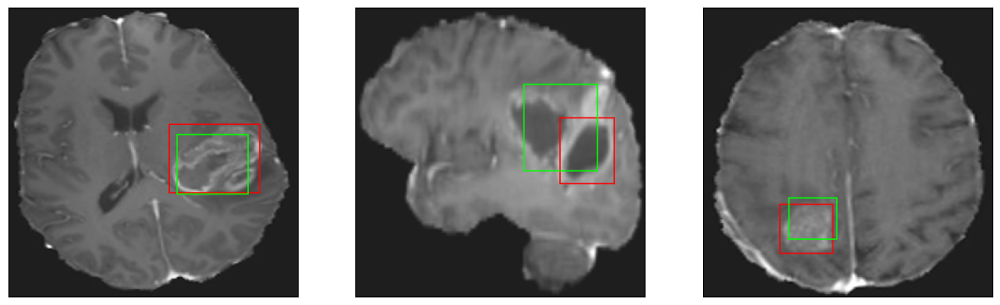

26/26 [==============================] - 3s 119ms/step - loss: 4.8595 - IoU: 0.6144 - val_loss: 9.0249 - val_IoU: 0.4829
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0056 - IoU: 0.6286
Epoch 128: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


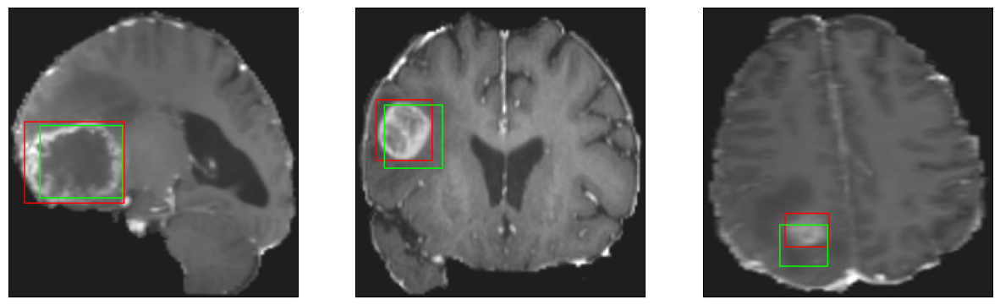

26/26 [==============================] - 3s 119ms/step - loss: 4.9802 - IoU: 0.6295 - val_loss: 8.1727 - val_IoU: 0.5446
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.5380 - IoU: 0.6394
Epoch 129: val_loss did not improve from 7.64546
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


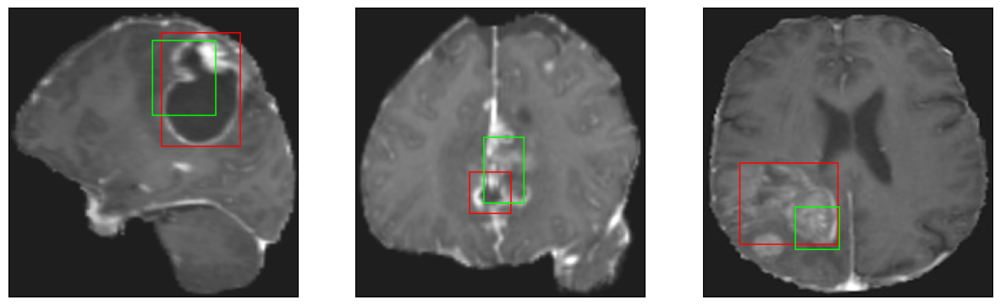

26/26 [==============================] - 3s 132ms/step - loss: 4.5380 - IoU: 0.6394 - val_loss: 8.4025 - val_IoU: 0.5256
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 4.7865 - IoU: 0.6324
Epoch 130: val_loss improved from 7.64546 to 7.59439, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


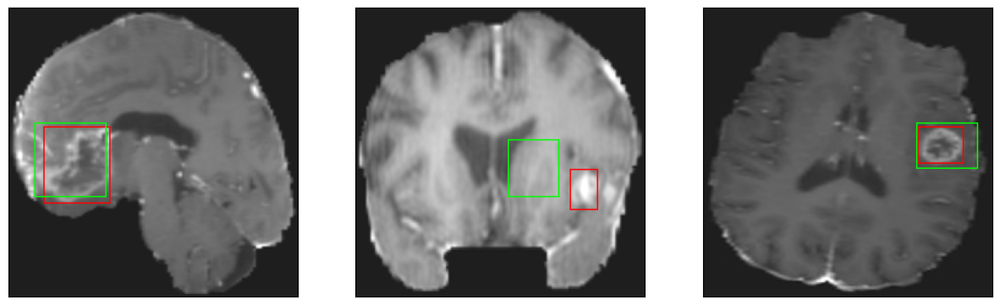

26/26 [==============================] - 5s 176ms/step - loss: 4.7865 - IoU: 0.6324 - val_loss: 7.5944 - val_IoU: 0.5701
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.5035 - IoU: 0.6406
Epoch 131: val_loss did not improve from 7.59439
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


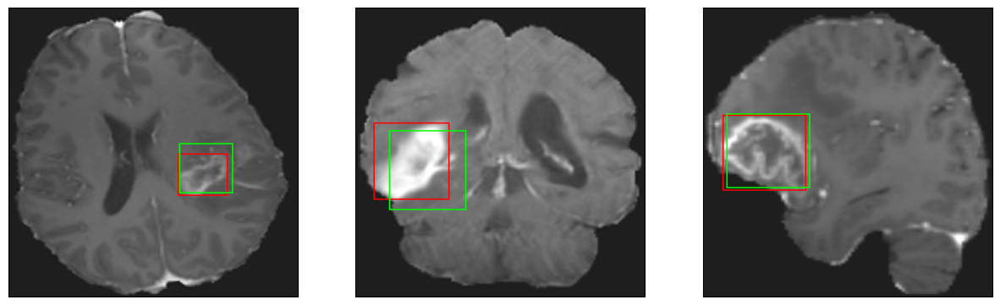

26/26 [==============================] - 3s 121ms/step - loss: 4.5035 - IoU: 0.6406 - val_loss: 9.9574 - val_IoU: 0.4420
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.4602 - IoU: 0.6437
Epoch 132: val_loss did not improve from 7.59439
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


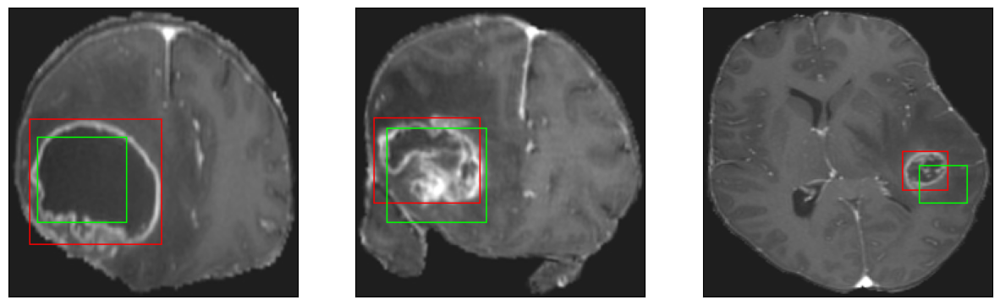

26/26 [==============================] - 3s 135ms/step - loss: 4.4602 - IoU: 0.6437 - val_loss: 9.4385 - val_IoU: 0.4542
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.4004 - IoU: 0.6483
Epoch 133: val_loss did not improve from 7.59439
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


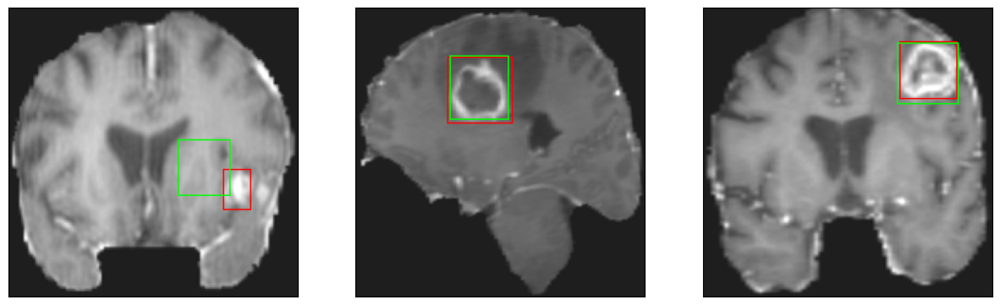

26/26 [==============================] - 4s 137ms/step - loss: 4.4004 - IoU: 0.6483 - val_loss: 8.0275 - val_IoU: 0.5298
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 4.6710 - IoU: 0.6274
Epoch 134: val_loss did not improve from 7.59439
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


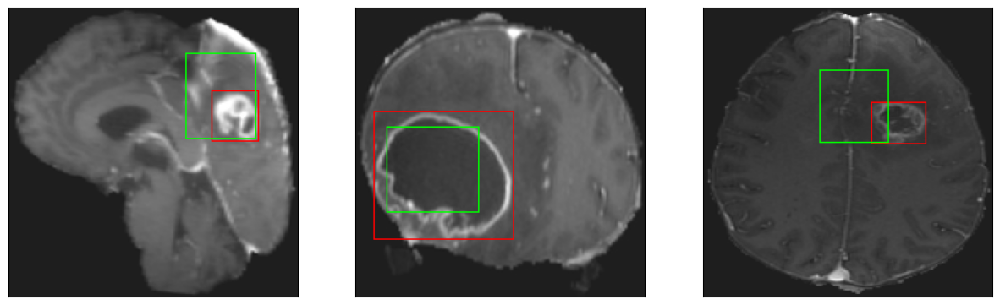

26/26 [==============================] - 3s 121ms/step - loss: 4.6710 - IoU: 0.6274 - val_loss: 7.6939 - val_IoU: 0.5510
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.4660 - IoU: 0.6456
Epoch 135: val_loss did not improve from 7.59439
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


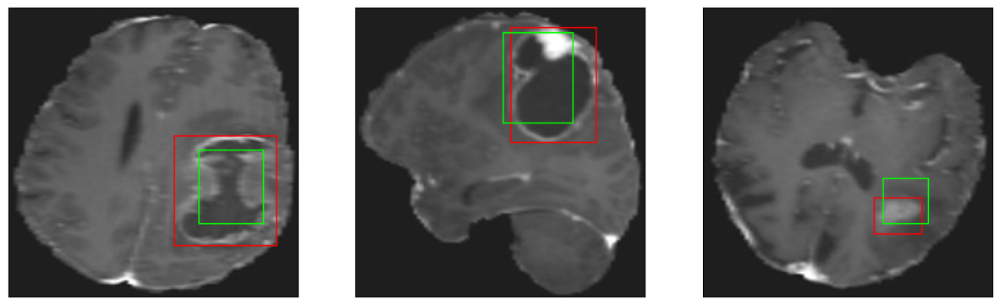

26/26 [==============================] - 3s 111ms/step - loss: 4.4660 - IoU: 0.6456 - val_loss: 7.7075 - val_IoU: 0.5562
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.7714 - IoU: 0.6265
Epoch 136: val_loss did not improve from 7.59439
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


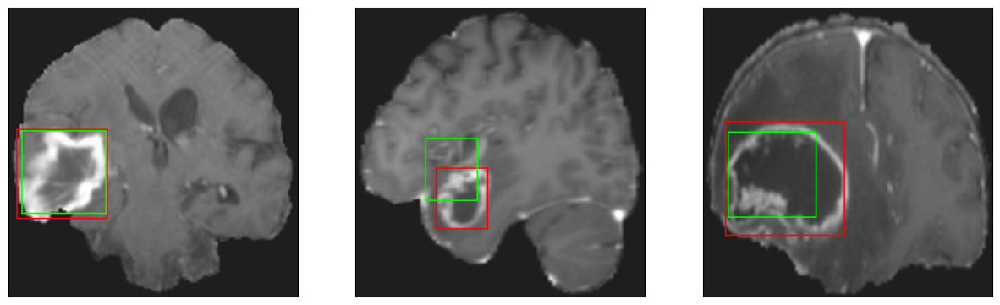

26/26 [==============================] - 4s 146ms/step - loss: 4.7714 - IoU: 0.6265 - val_loss: 11.2587 - val_IoU: 0.4053
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.4628 - IoU: 0.6431
Epoch 137: val_loss improved from 7.59439 to 7.55087, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


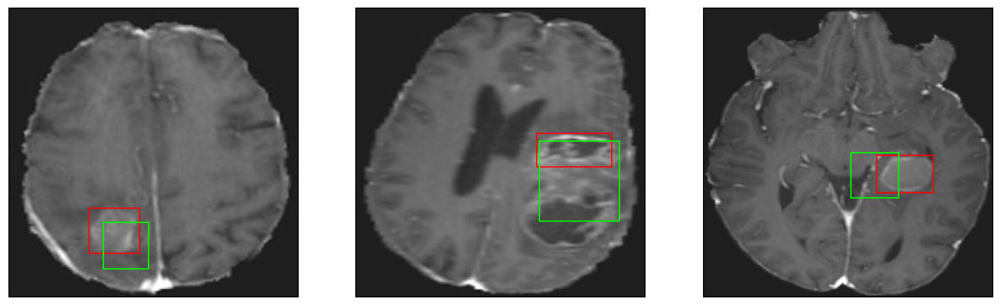

26/26 [==============================] - 5s 181ms/step - loss: 4.4628 - IoU: 0.6431 - val_loss: 7.5509 - val_IoU: 0.5553
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 4.5710 - IoU: 0.6384
Epoch 138: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


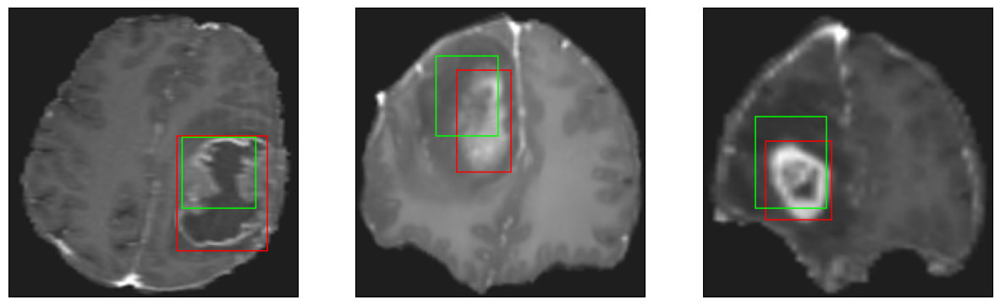

26/26 [==============================] - 3s 123ms/step - loss: 4.5710 - IoU: 0.6384 - val_loss: 10.9595 - val_IoU: 0.4122
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 4.5040 - IoU: 0.6400
Epoch 139: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 8ms/step
4


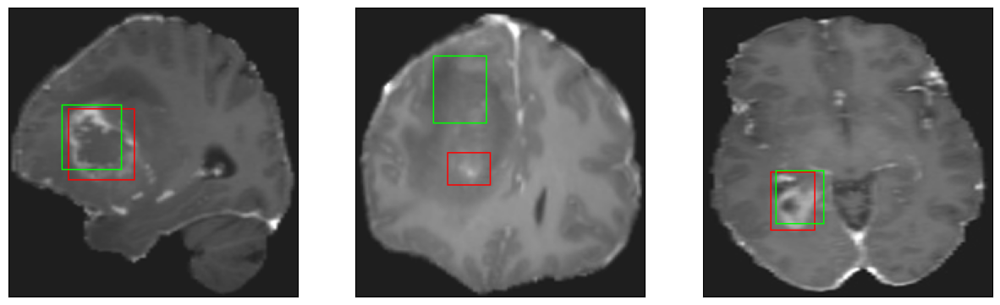

26/26 [==============================] - 3s 126ms/step - loss: 4.5040 - IoU: 0.6400 - val_loss: 9.5459 - val_IoU: 0.4730
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.4650 - IoU: 0.6493
Epoch 140: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


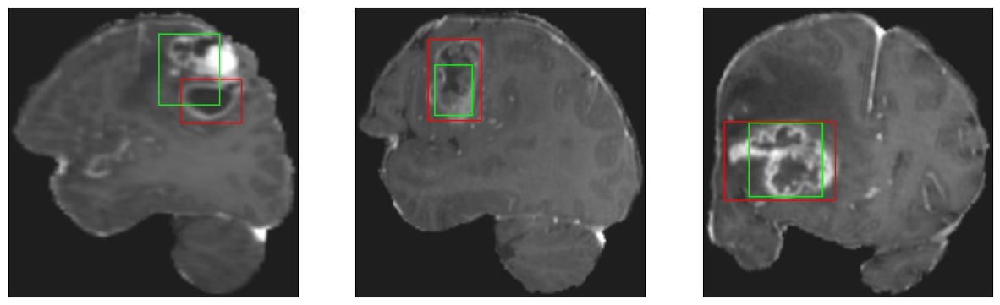

26/26 [==============================] - 4s 144ms/step - loss: 4.4650 - IoU: 0.6493 - val_loss: 8.1002 - val_IoU: 0.5287
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.8627 - IoU: 0.6231
Epoch 141: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


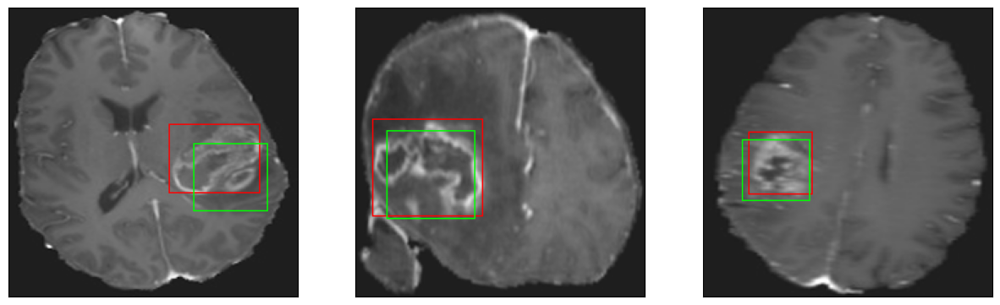

26/26 [==============================] - 3s 116ms/step - loss: 4.8627 - IoU: 0.6231 - val_loss: 7.8089 - val_IoU: 0.5664
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.5629 - IoU: 0.6400
Epoch 142: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


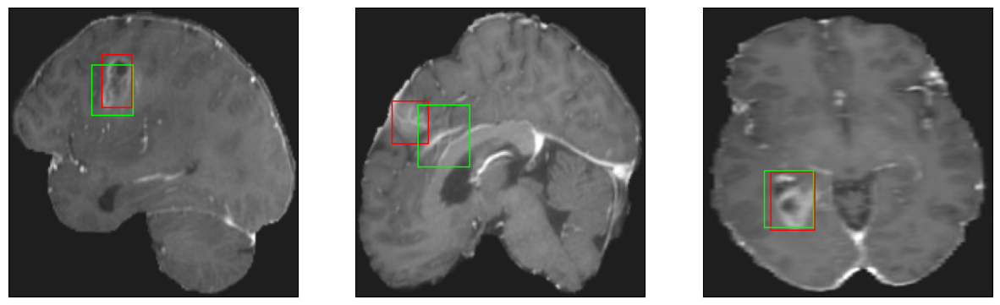

26/26 [==============================] - 3s 127ms/step - loss: 4.5629 - IoU: 0.6400 - val_loss: 8.5525 - val_IoU: 0.5205
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 4.3811 - IoU: 0.6479
Epoch 143: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


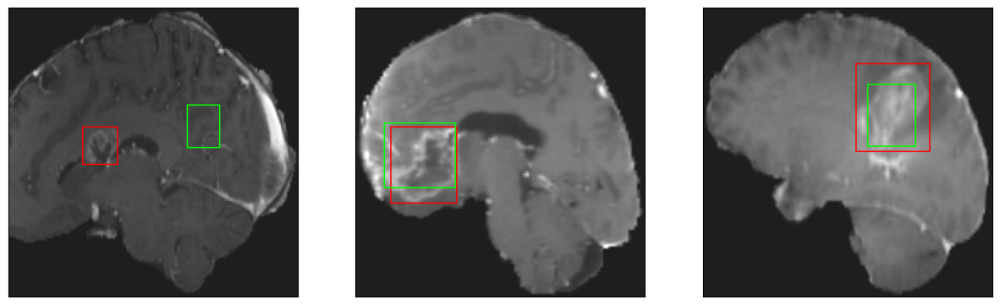

26/26 [==============================] - 4s 155ms/step - loss: 4.3811 - IoU: 0.6479 - val_loss: 8.2118 - val_IoU: 0.5461
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4755 - IoU: 0.6460
Epoch 144: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


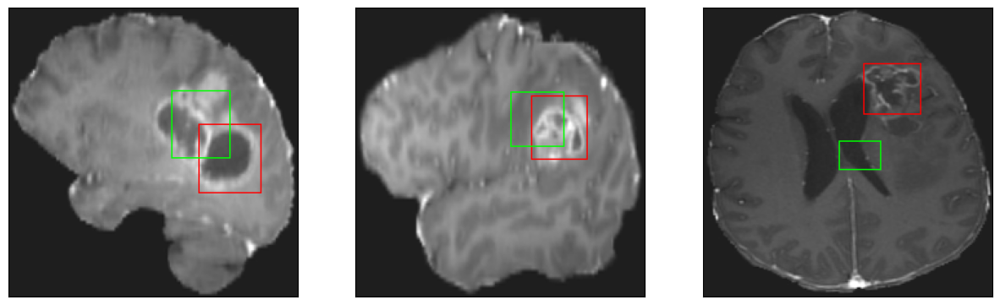

26/26 [==============================] - 3s 118ms/step - loss: 4.4663 - IoU: 0.6450 - val_loss: 10.5737 - val_IoU: 0.4277
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 4.6106 - IoU: 0.6328
Epoch 145: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


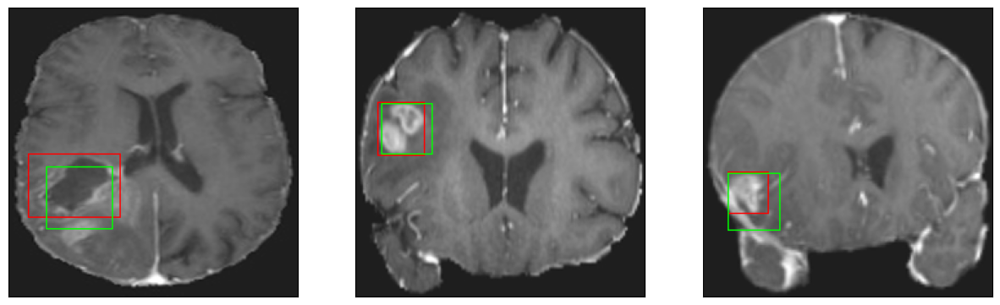

26/26 [==============================] - 3s 118ms/step - loss: 4.6106 - IoU: 0.6328 - val_loss: 7.7313 - val_IoU: 0.5564
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 4.3652 - IoU: 0.6535
Epoch 146: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4


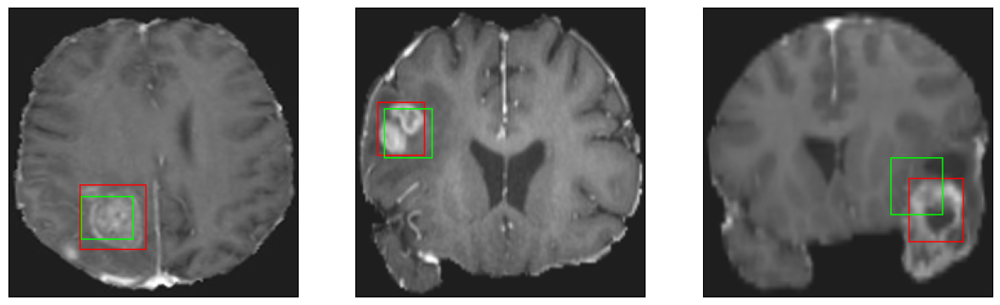

26/26 [==============================] - 4s 140ms/step - loss: 4.3652 - IoU: 0.6535 - val_loss: 8.7767 - val_IoU: 0.5024
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.5142 - IoU: 0.6420
Epoch 147: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4


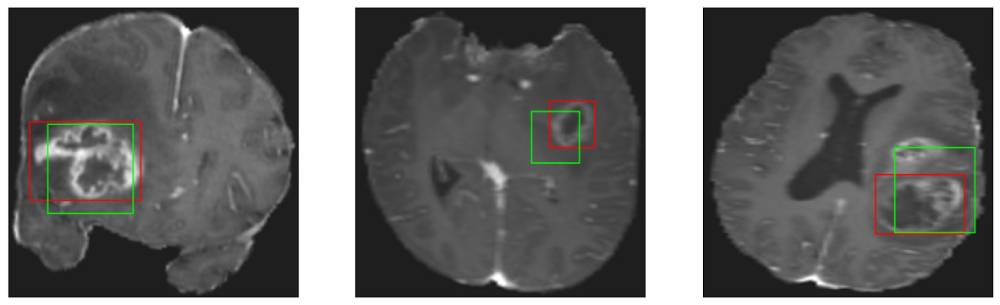

26/26 [==============================] - 4s 148ms/step - loss: 4.5142 - IoU: 0.6420 - val_loss: 8.0244 - val_IoU: 0.5562
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8558 - IoU: 0.6109
Epoch 148: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


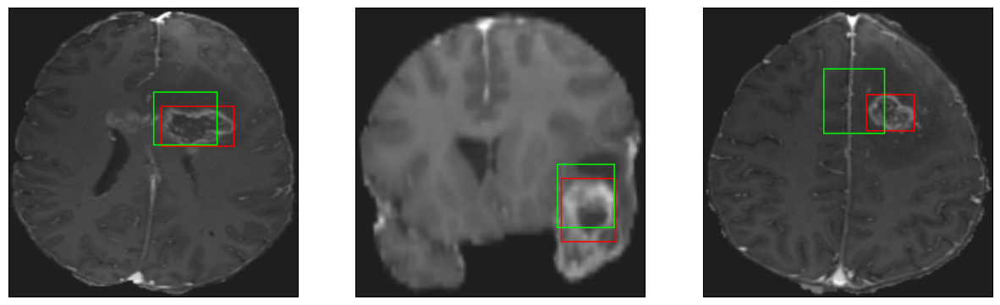

26/26 [==============================] - 3s 115ms/step - loss: 4.8210 - IoU: 0.6127 - val_loss: 7.9276 - val_IoU: 0.5415
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.3597 - IoU: 0.6563
Epoch 149: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


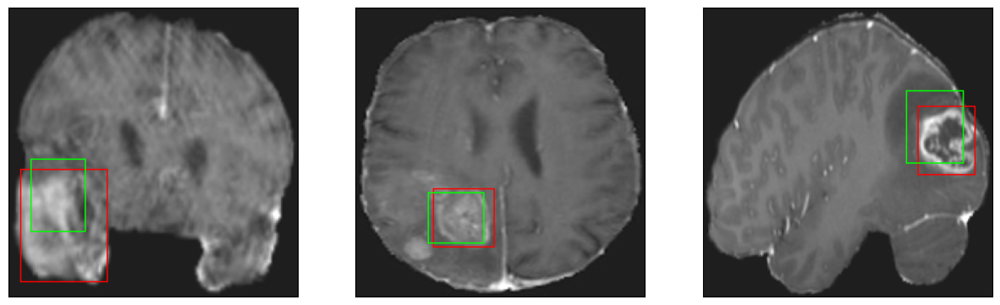

26/26 [==============================] - 3s 118ms/step - loss: 4.3597 - IoU: 0.6563 - val_loss: 8.7639 - val_IoU: 0.4793
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 4.7980 - IoU: 0.6282
Epoch 150: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


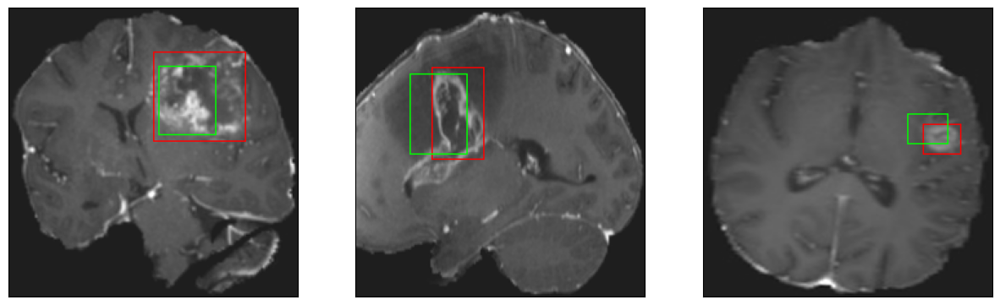

26/26 [==============================] - 3s 128ms/step - loss: 4.7980 - IoU: 0.6282 - val_loss: 7.8699 - val_IoU: 0.5489
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 4.5136 - IoU: 0.6535
Epoch 151: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


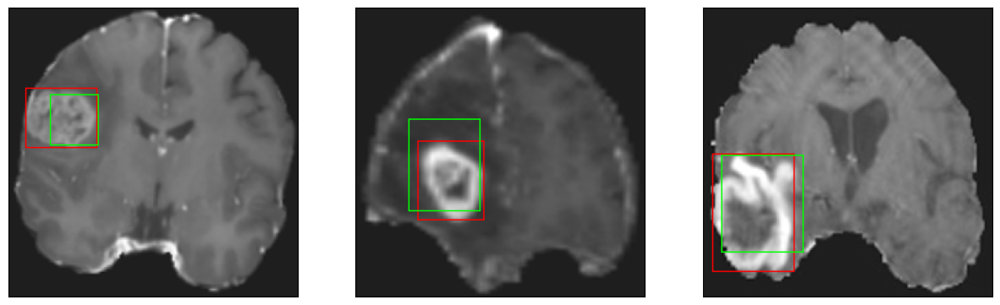

26/26 [==============================] - 4s 137ms/step - loss: 4.5136 - IoU: 0.6535 - val_loss: 8.1037 - val_IoU: 0.5458
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 4.5109 - IoU: 0.6412
Epoch 152: val_loss did not improve from 7.55087
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


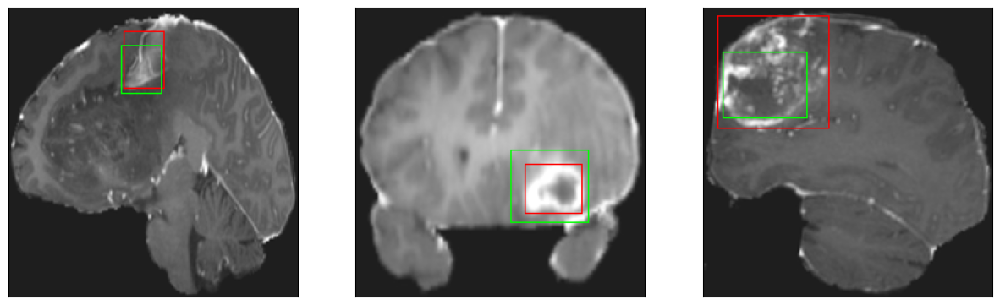

26/26 [==============================] - 3s 125ms/step - loss: 4.5109 - IoU: 0.6412 - val_loss: 9.1680 - val_IoU: 0.4853
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.5918 - IoU: 0.6390
Epoch 153: val_loss improved from 7.55087 to 7.39412, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


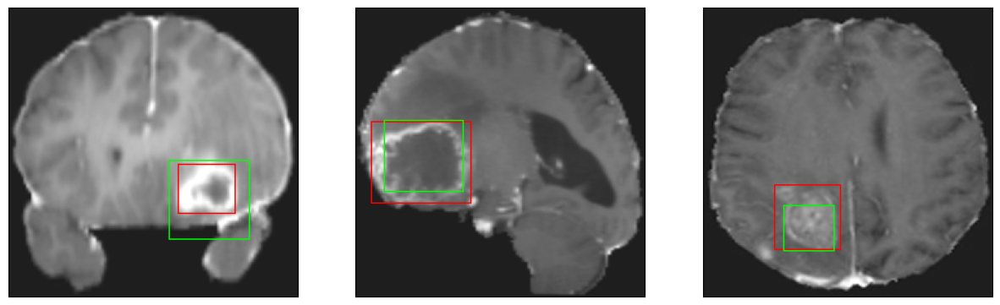

26/26 [==============================] - 4s 159ms/step - loss: 4.5918 - IoU: 0.6390 - val_loss: 7.3941 - val_IoU: 0.5792
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.4293 - IoU: 0.6526
Epoch 154: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


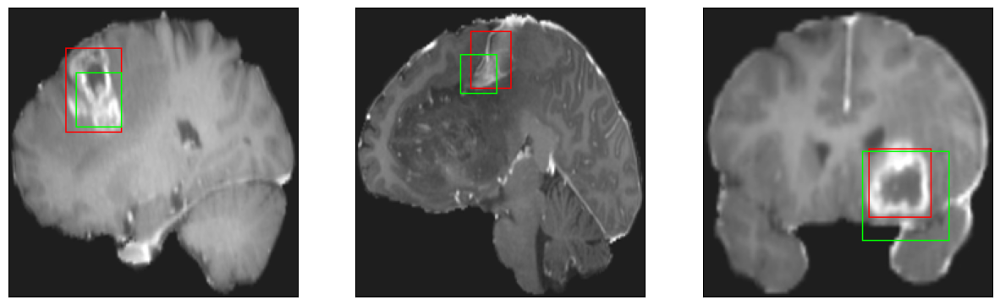

26/26 [==============================] - 3s 124ms/step - loss: 4.4293 - IoU: 0.6526 - val_loss: 8.3007 - val_IoU: 0.5291
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 4.4058 - IoU: 0.6528
Epoch 155: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4


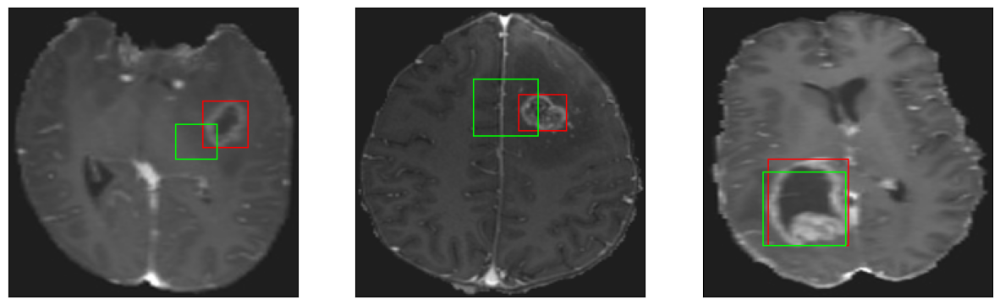

26/26 [==============================] - 4s 144ms/step - loss: 4.4058 - IoU: 0.6528 - val_loss: 8.4054 - val_IoU: 0.5272
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 4.6993 - IoU: 0.6246
Epoch 156: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


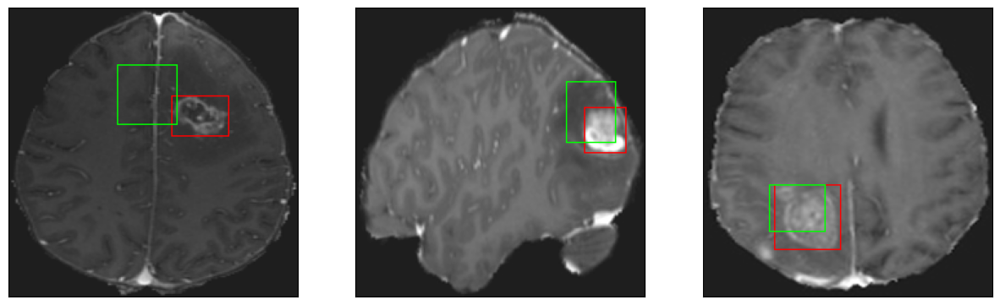

26/26 [==============================] - 3s 125ms/step - loss: 4.6993 - IoU: 0.6246 - val_loss: 10.3425 - val_IoU: 0.4115
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.4205 - IoU: 0.6422
Epoch 157: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


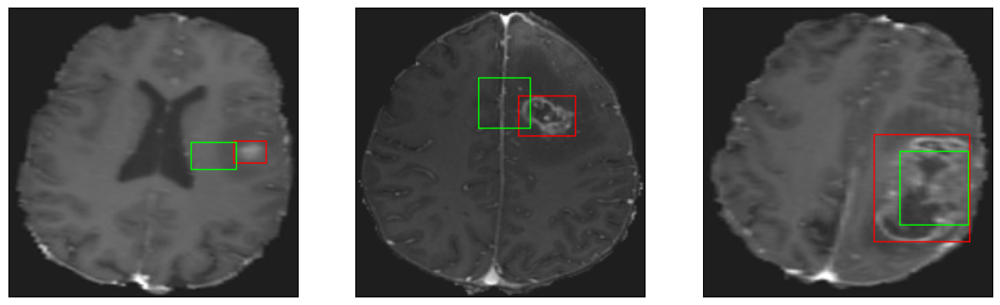

26/26 [==============================] - 3s 115ms/step - loss: 4.4205 - IoU: 0.6422 - val_loss: 8.2670 - val_IoU: 0.5280
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 4.4828 - IoU: 0.6399
Epoch 158: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


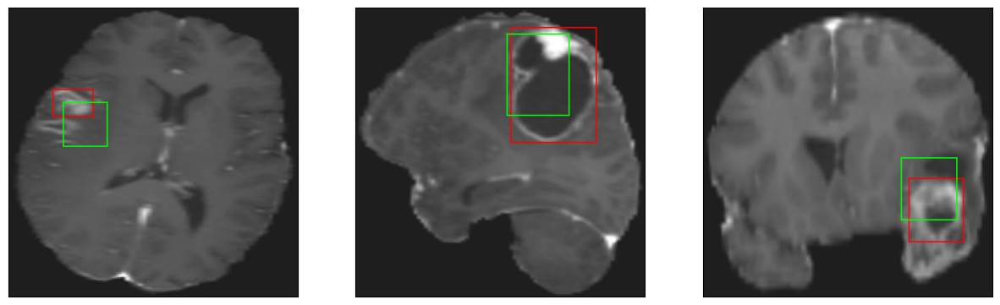

26/26 [==============================] - 3s 128ms/step - loss: 4.4828 - IoU: 0.6399 - val_loss: 8.2914 - val_IoU: 0.5300
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 4.3904 - IoU: 0.6524
Epoch 159: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


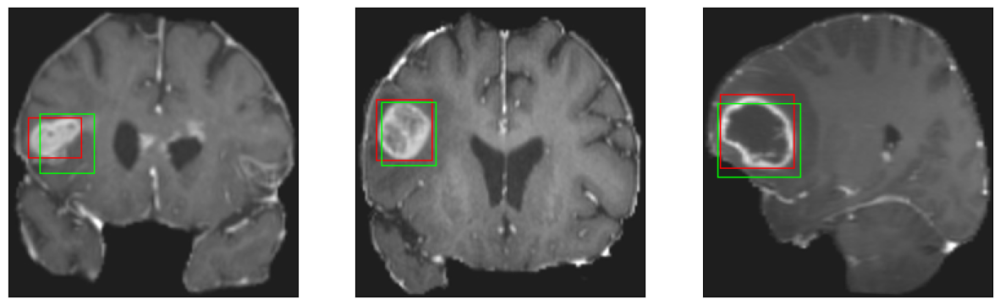

26/26 [==============================] - 4s 154ms/step - loss: 4.3904 - IoU: 0.6524 - val_loss: 8.1385 - val_IoU: 0.5410
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7195 - IoU: 0.6237
Epoch 160: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


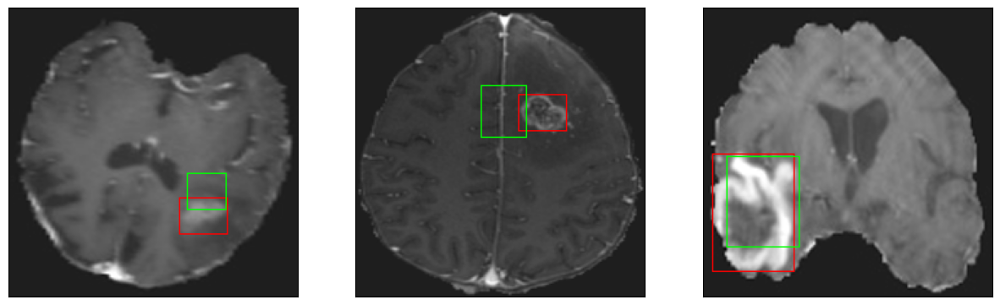

26/26 [==============================] - 3s 121ms/step - loss: 4.7489 - IoU: 0.6241 - val_loss: 8.6448 - val_IoU: 0.5134
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5875 - IoU: 0.6442
Epoch 161: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


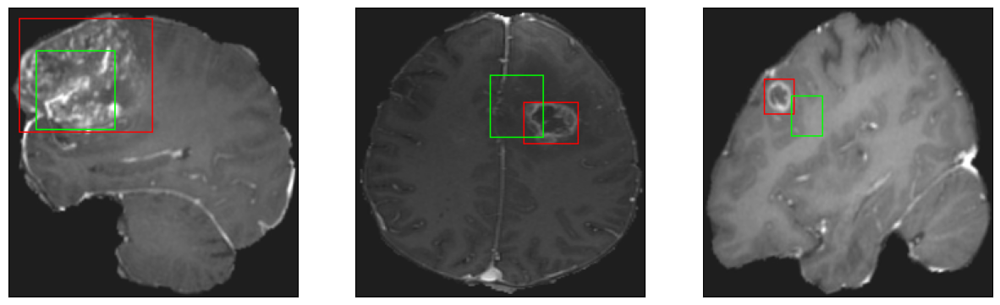

26/26 [==============================] - 3s 127ms/step - loss: 4.5260 - IoU: 0.6469 - val_loss: 8.4754 - val_IoU: 0.5181
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3579 - IoU: 0.6547
Epoch 162: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


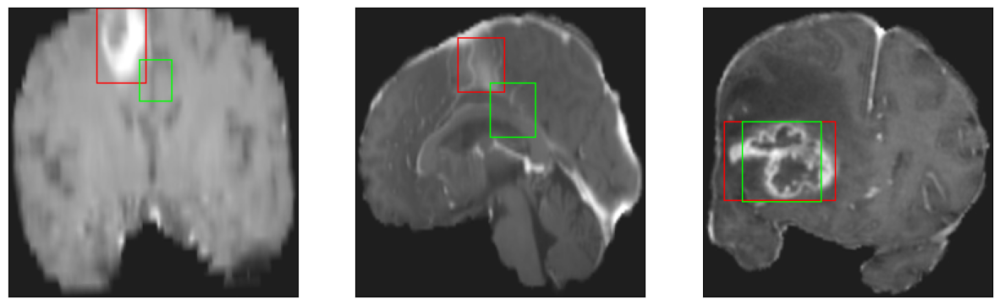

26/26 [==============================] - 3s 127ms/step - loss: 4.3685 - IoU: 0.6534 - val_loss: 7.9852 - val_IoU: 0.5424
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 4.1648 - IoU: 0.6575
Epoch 163: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


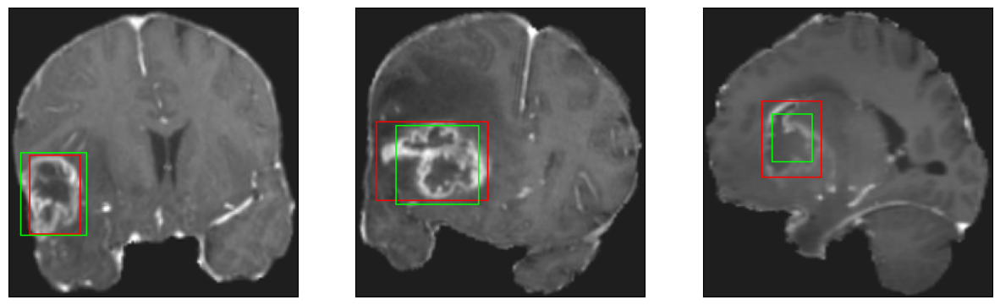

26/26 [==============================] - 4s 165ms/step - loss: 4.1648 - IoU: 0.6575 - val_loss: 7.4543 - val_IoU: 0.5731
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.4184 - IoU: 0.6474
Epoch 164: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


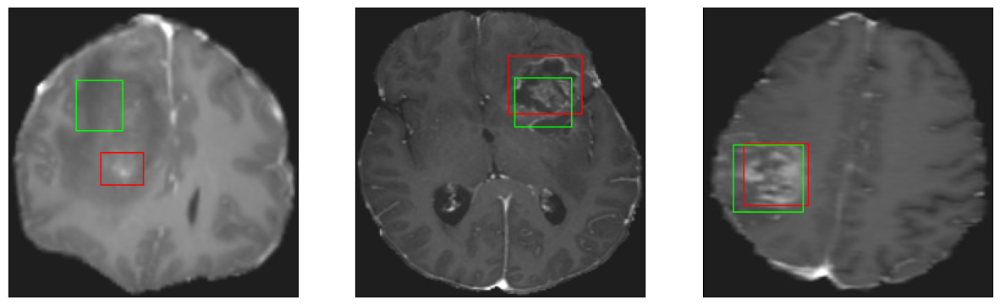

26/26 [==============================] - 3s 124ms/step - loss: 4.4184 - IoU: 0.6474 - val_loss: 8.3634 - val_IoU: 0.5316
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 4.5572 - IoU: 0.6421
Epoch 165: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


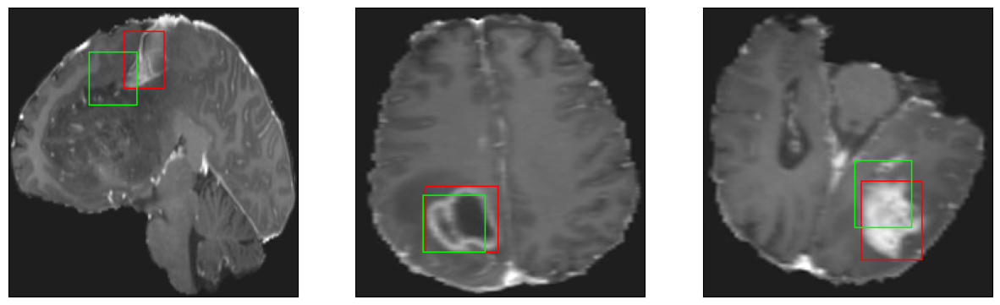

26/26 [==============================] - 3s 132ms/step - loss: 4.5572 - IoU: 0.6421 - val_loss: 9.7147 - val_IoU: 0.4516
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2828 - IoU: 0.6551
Epoch 166: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


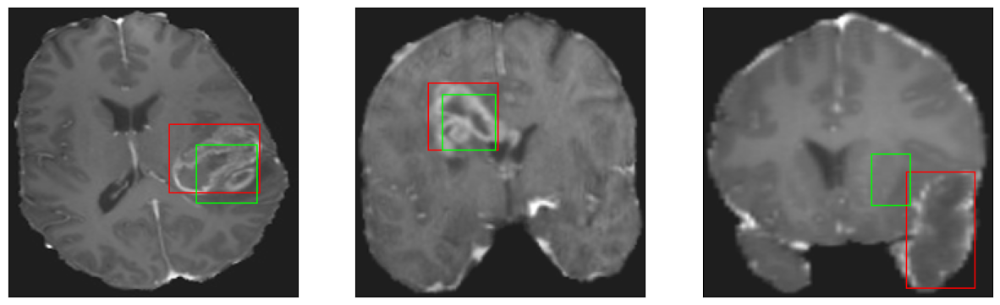

26/26 [==============================] - 3s 121ms/step - loss: 4.2503 - IoU: 0.6556 - val_loss: 8.1550 - val_IoU: 0.5250
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2665 - IoU: 0.6609
Epoch 167: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


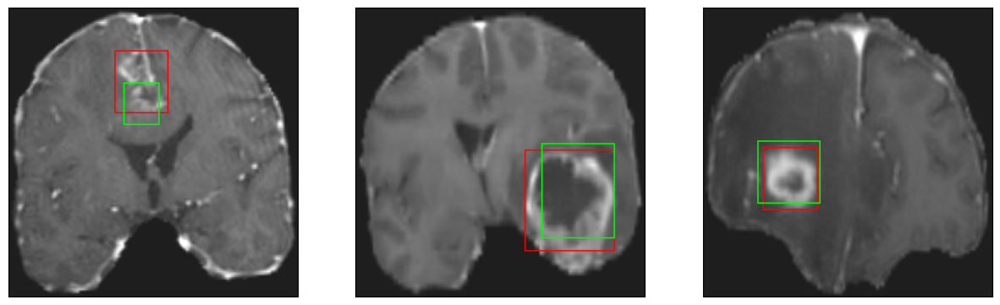

26/26 [==============================] - 3s 133ms/step - loss: 4.2925 - IoU: 0.6591 - val_loss: 8.0405 - val_IoU: 0.5340
Epoch 168/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2853 - IoU: 0.6475
Epoch 168: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


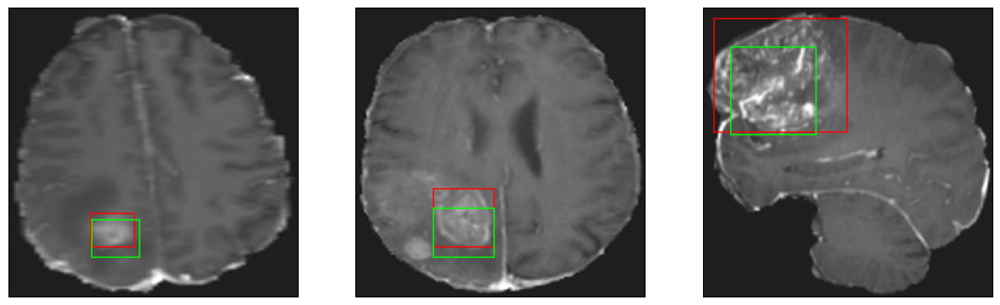

26/26 [==============================] - 3s 121ms/step - loss: 4.2887 - IoU: 0.6483 - val_loss: 8.0397 - val_IoU: 0.5398
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 4.2897 - IoU: 0.6581
Epoch 169: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


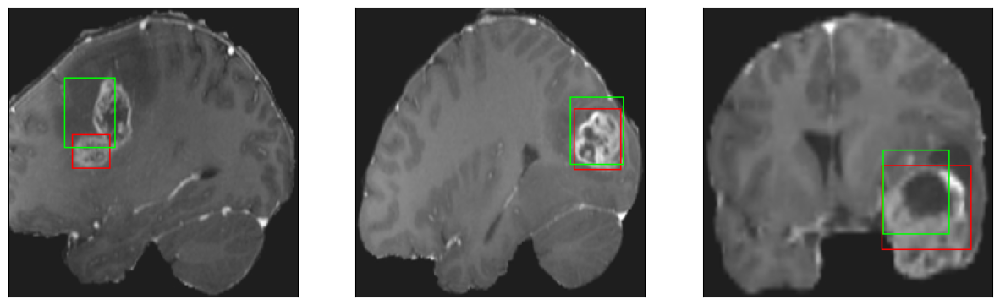

26/26 [==============================] - 3s 112ms/step - loss: 4.2897 - IoU: 0.6581 - val_loss: 8.0294 - val_IoU: 0.5307
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.2028 - IoU: 0.6565
Epoch 170: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


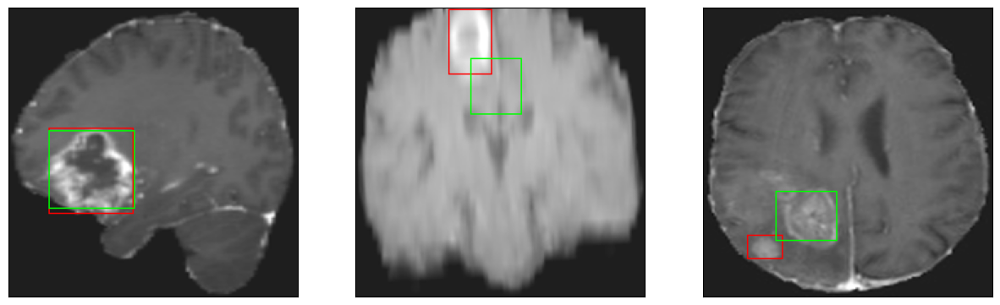

26/26 [==============================] - 4s 137ms/step - loss: 4.2028 - IoU: 0.6565 - val_loss: 9.1349 - val_IoU: 0.4940
Epoch 171/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2653 - IoU: 0.6593
Epoch 171: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 14ms/step
4


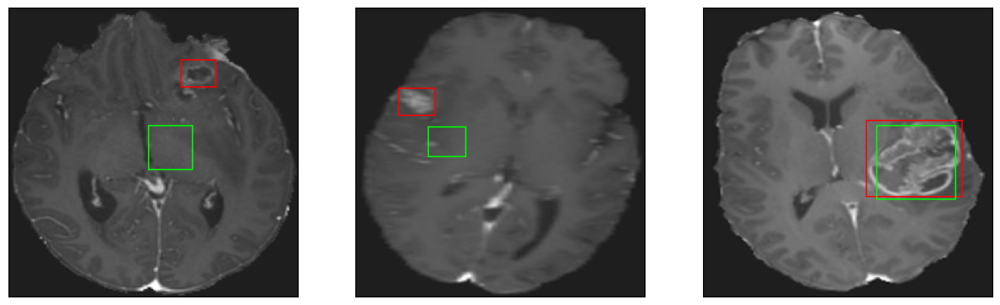

26/26 [==============================] - 4s 147ms/step - loss: 4.2760 - IoU: 0.6590 - val_loss: 7.7332 - val_IoU: 0.5567
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 4.4112 - IoU: 0.6536
Epoch 172: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


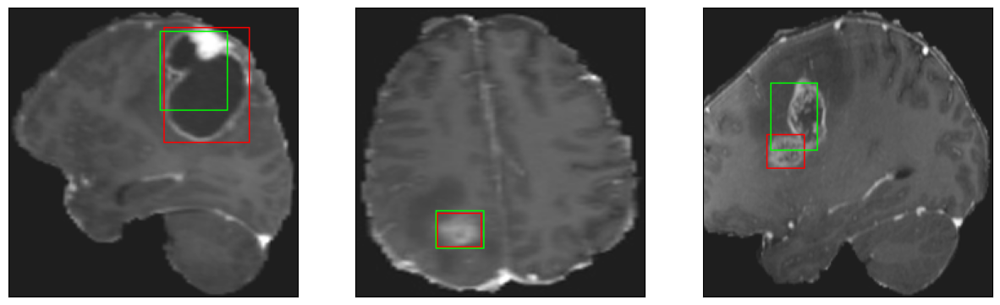

26/26 [==============================] - 3s 117ms/step - loss: 4.4112 - IoU: 0.6536 - val_loss: 8.1640 - val_IoU: 0.5296
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2415 - IoU: 0.6596
Epoch 173: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


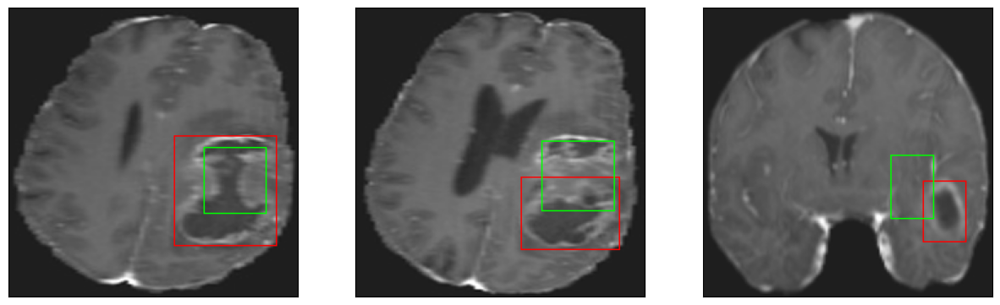

26/26 [==============================] - 3s 116ms/step - loss: 4.2342 - IoU: 0.6603 - val_loss: 7.7306 - val_IoU: 0.5646
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2795 - IoU: 0.6533
Epoch 174: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4


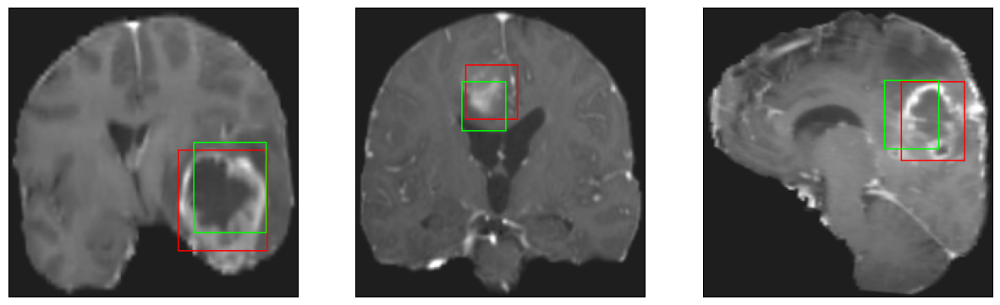

26/26 [==============================] - 3s 121ms/step - loss: 4.2943 - IoU: 0.6529 - val_loss: 7.7719 - val_IoU: 0.5658
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.4845 - IoU: 0.6464
Epoch 175: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


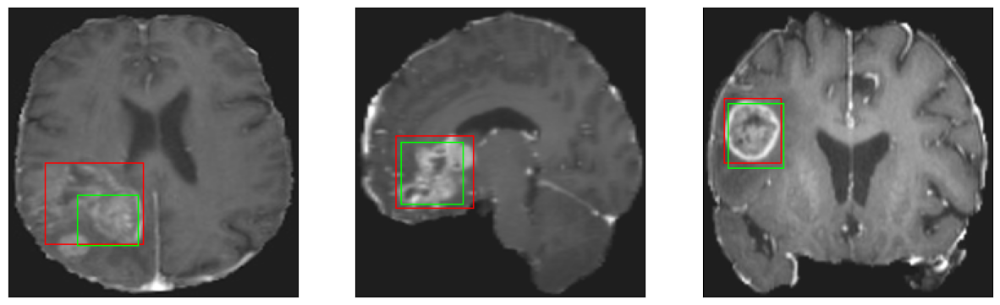

26/26 [==============================] - 4s 136ms/step - loss: 4.4845 - IoU: 0.6464 - val_loss: 7.6116 - val_IoU: 0.5683
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 4.2940 - IoU: 0.6527
Epoch 176: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


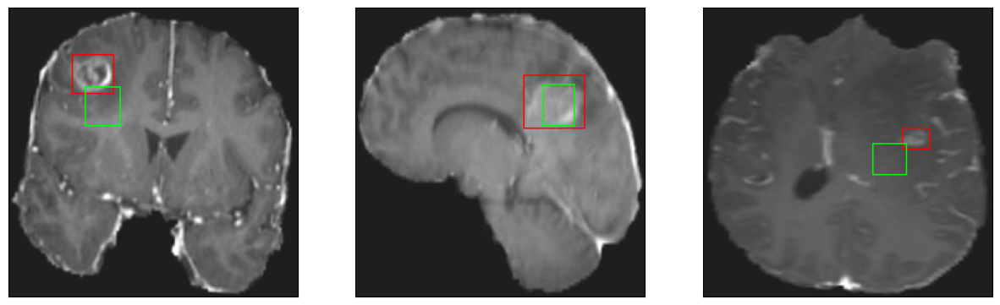

26/26 [==============================] - 3s 117ms/step - loss: 4.2940 - IoU: 0.6527 - val_loss: 8.6739 - val_IoU: 0.5208
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.3469 - IoU: 0.6504
Epoch 177: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 13ms/step
4


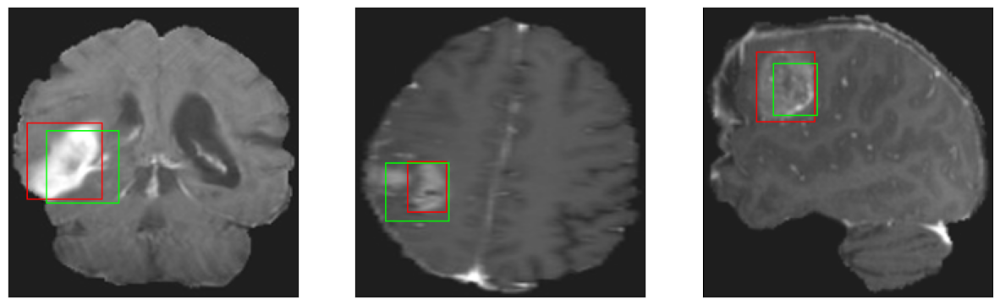

26/26 [==============================] - 3s 133ms/step - loss: 4.3469 - IoU: 0.6504 - val_loss: 7.8826 - val_IoU: 0.5471
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 4.2269 - IoU: 0.6595
Epoch 178: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


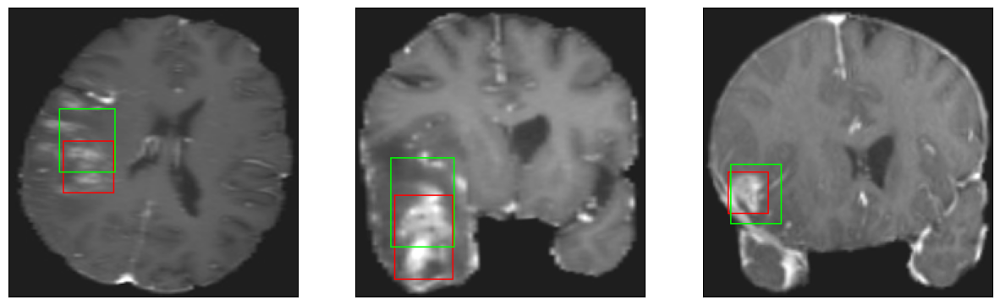

26/26 [==============================] - 4s 141ms/step - loss: 4.2269 - IoU: 0.6595 - val_loss: 8.8217 - val_IoU: 0.5058
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4949 - IoU: 0.6458
Epoch 179: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


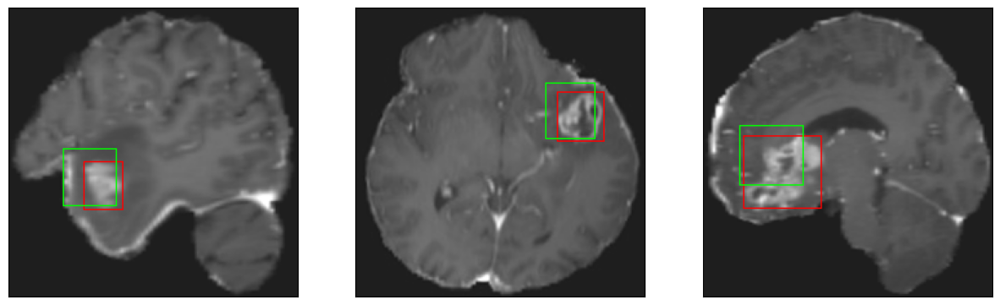

26/26 [==============================] - 4s 144ms/step - loss: 4.4637 - IoU: 0.6468 - val_loss: 10.3775 - val_IoU: 0.4152
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4292 - IoU: 0.6418
Epoch 180: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


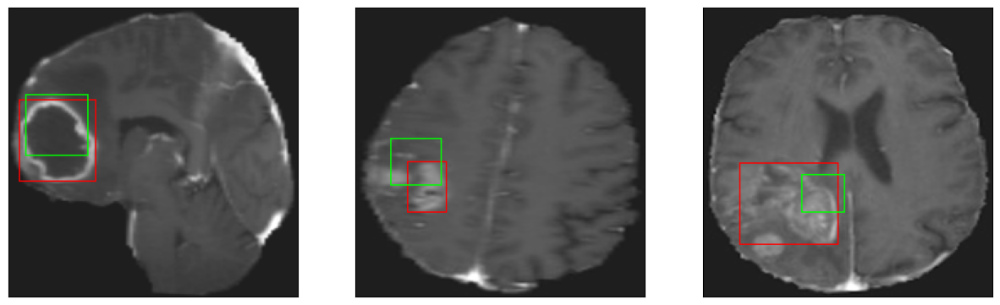

26/26 [==============================] - 3s 123ms/step - loss: 4.3990 - IoU: 0.6430 - val_loss: 11.8350 - val_IoU: 0.3449
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4783 - IoU: 0.6567
Epoch 181: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


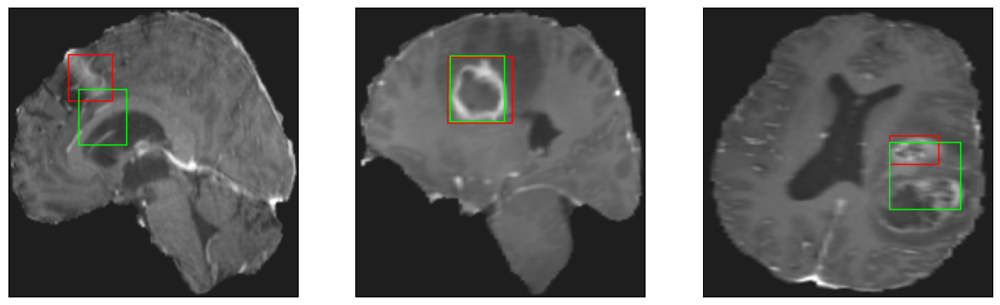

26/26 [==============================] - 3s 123ms/step - loss: 4.4422 - IoU: 0.6567 - val_loss: 7.9852 - val_IoU: 0.5397
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 4.2451 - IoU: 0.6608
Epoch 182: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


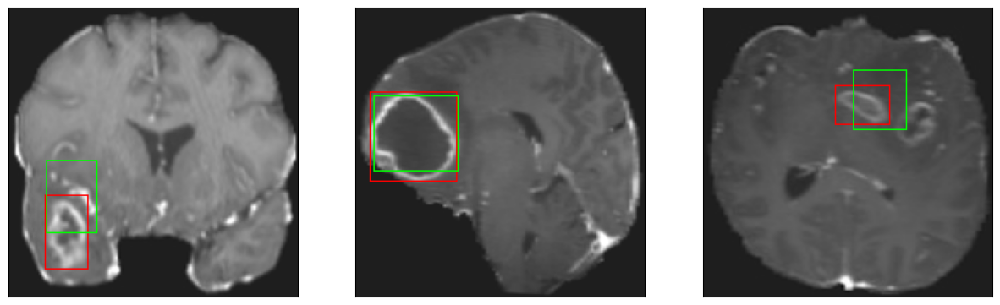

26/26 [==============================] - 3s 126ms/step - loss: 4.2451 - IoU: 0.6608 - val_loss: 10.0406 - val_IoU: 0.4375
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 4.1669 - IoU: 0.6601
Epoch 183: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


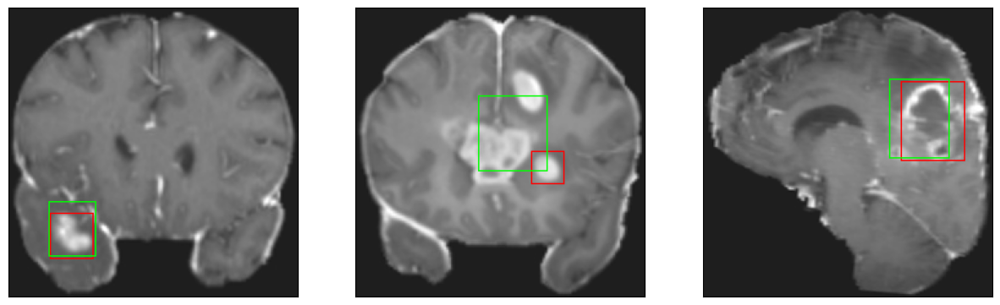

26/26 [==============================] - 4s 140ms/step - loss: 4.1669 - IoU: 0.6601 - val_loss: 7.7758 - val_IoU: 0.5607
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.6175 - IoU: 0.6351
Epoch 184: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


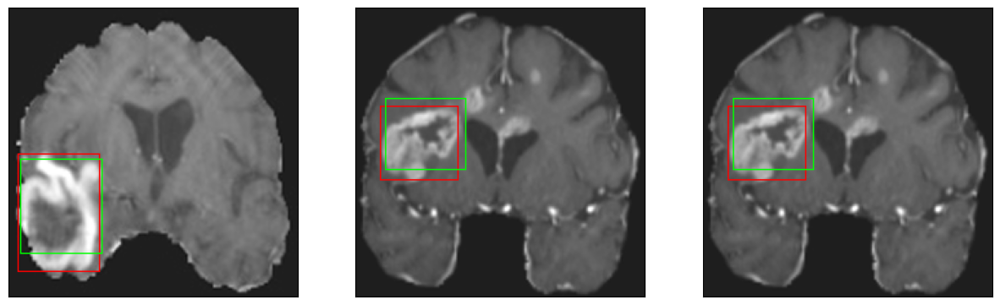

26/26 [==============================] - 4s 138ms/step - loss: 4.6175 - IoU: 0.6351 - val_loss: 8.4976 - val_IoU: 0.5120
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4282 - IoU: 0.6480
Epoch 185: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


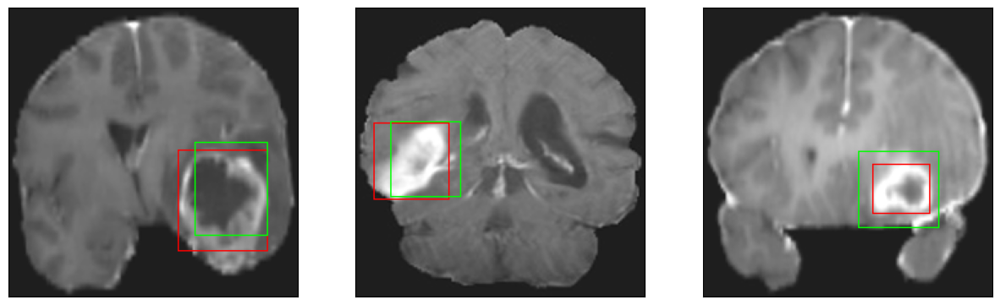

26/26 [==============================] - 3s 120ms/step - loss: 4.4364 - IoU: 0.6480 - val_loss: 8.0801 - val_IoU: 0.5315
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 4.4059 - IoU: 0.6506
Epoch 186: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4


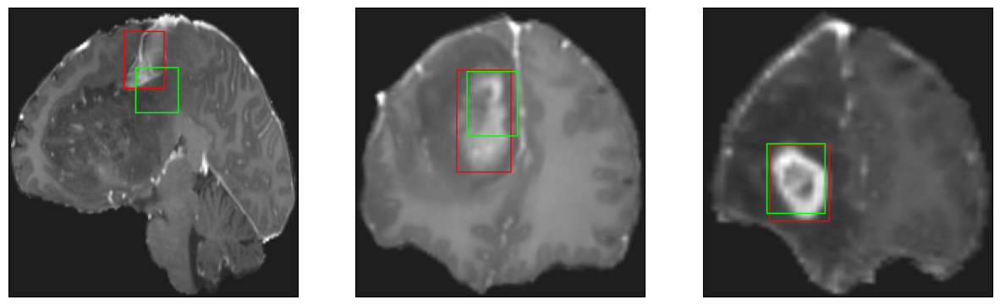

26/26 [==============================] - 3s 135ms/step - loss: 4.4059 - IoU: 0.6506 - val_loss: 10.8355 - val_IoU: 0.4115
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 4.3013 - IoU: 0.6537
Epoch 187: val_loss did not improve from 7.39412
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


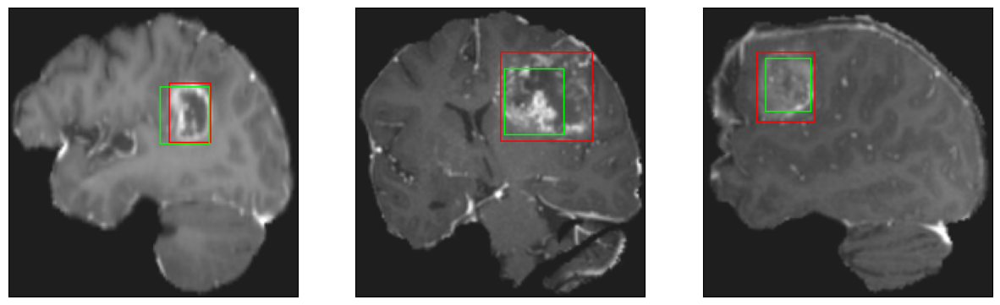

26/26 [==============================] - 3s 125ms/step - loss: 4.3013 - IoU: 0.6537 - val_loss: 7.5417 - val_IoU: 0.5763
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3775 - IoU: 0.6515
Epoch 188: val_loss improved from 7.39412 to 7.36366, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


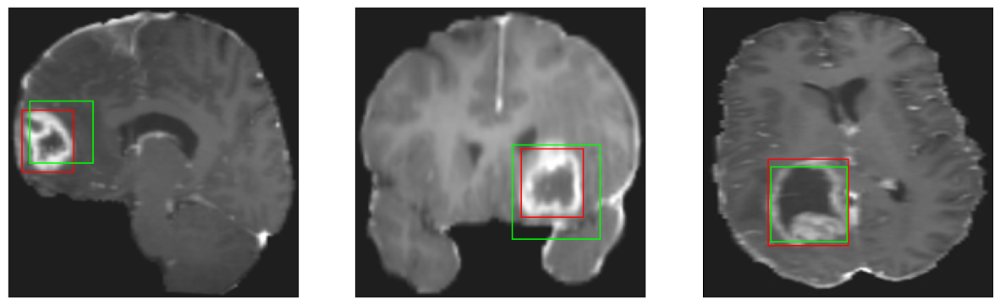

26/26 [==============================] - 4s 161ms/step - loss: 4.3649 - IoU: 0.6518 - val_loss: 7.3637 - val_IoU: 0.5828
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 4.1962 - IoU: 0.6606
Epoch 189: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4


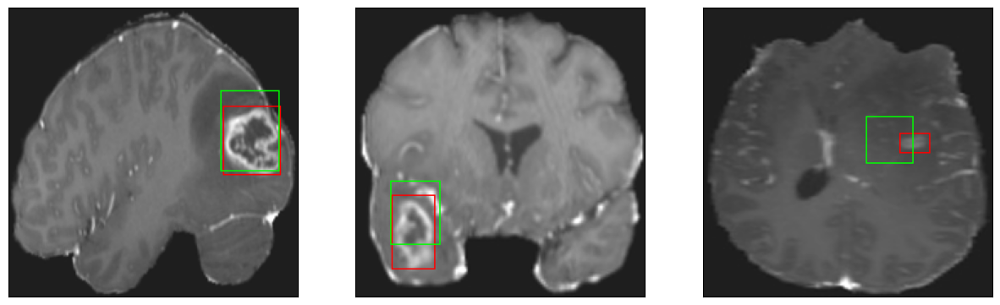

26/26 [==============================] - 3s 123ms/step - loss: 4.1962 - IoU: 0.6606 - val_loss: 8.2687 - val_IoU: 0.5211
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 4.2804 - IoU: 0.6527
Epoch 190: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


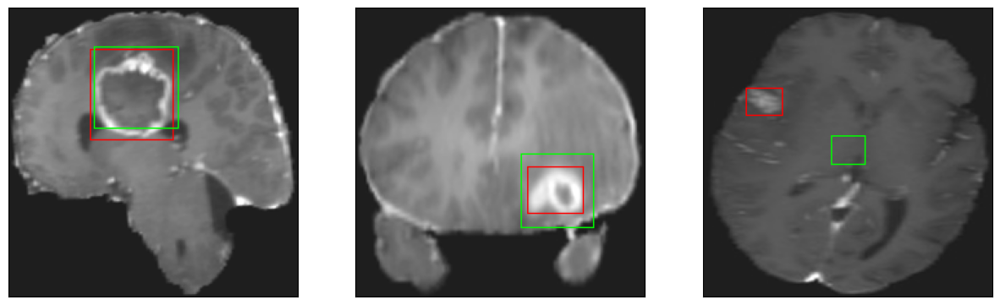

26/26 [==============================] - 4s 141ms/step - loss: 4.2804 - IoU: 0.6527 - val_loss: 9.3636 - val_IoU: 0.4924
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 4.1771 - IoU: 0.6623
Epoch 191: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


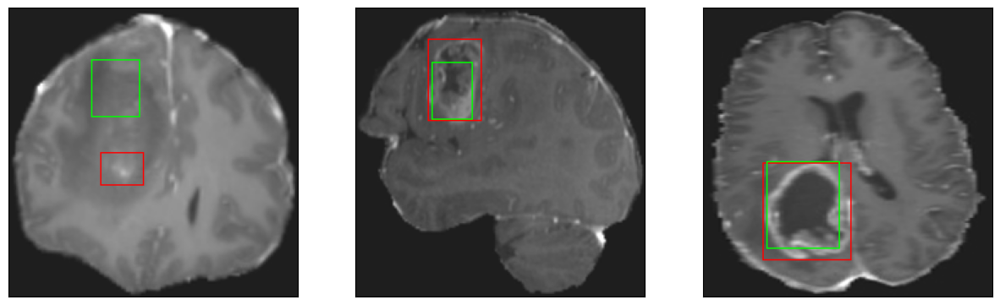

26/26 [==============================] - 4s 135ms/step - loss: 4.1771 - IoU: 0.6623 - val_loss: 7.8598 - val_IoU: 0.5451
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 4.2056 - IoU: 0.6553
Epoch 192: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


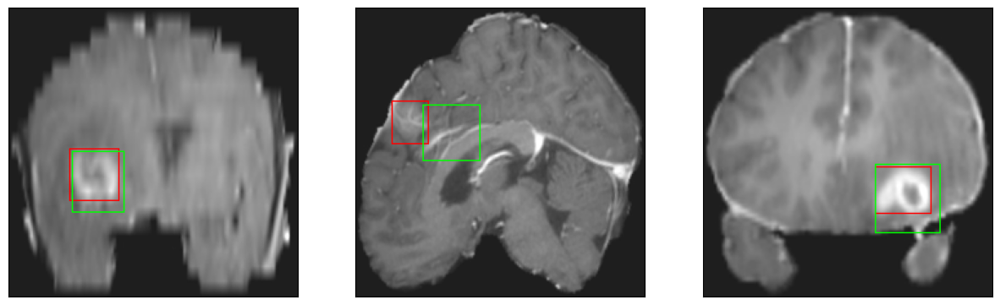

26/26 [==============================] - 3s 119ms/step - loss: 4.2056 - IoU: 0.6553 - val_loss: 7.7456 - val_IoU: 0.5619
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 4.2314 - IoU: 0.6651
Epoch 193: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


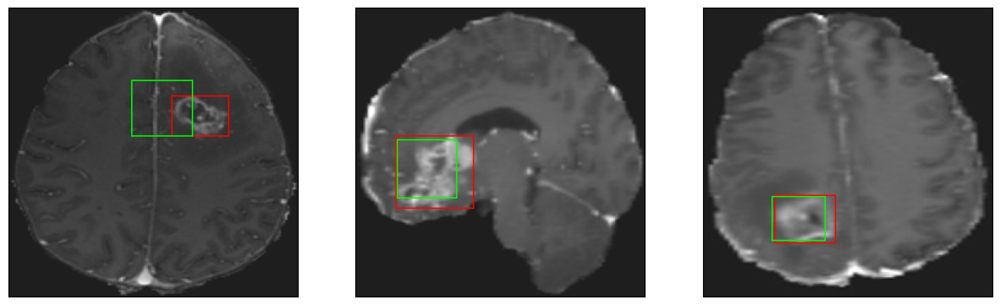

26/26 [==============================] - 4s 141ms/step - loss: 4.2314 - IoU: 0.6651 - val_loss: 7.6574 - val_IoU: 0.5727
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 4.1418 - IoU: 0.6654
Epoch 194: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


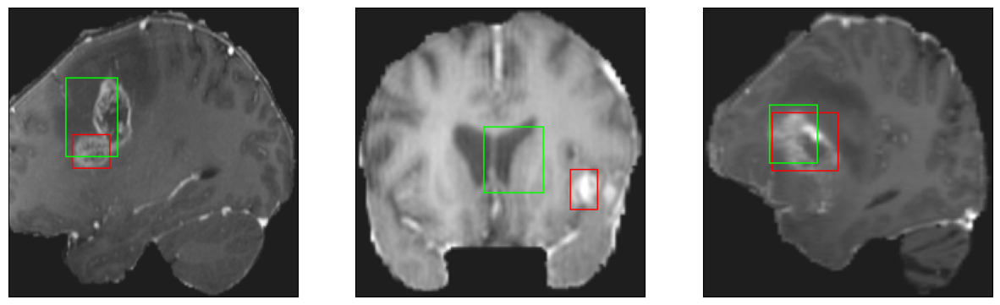

26/26 [==============================] - 3s 122ms/step - loss: 4.1418 - IoU: 0.6654 - val_loss: 8.0679 - val_IoU: 0.5342
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 4.1299 - IoU: 0.6593
Epoch 195: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


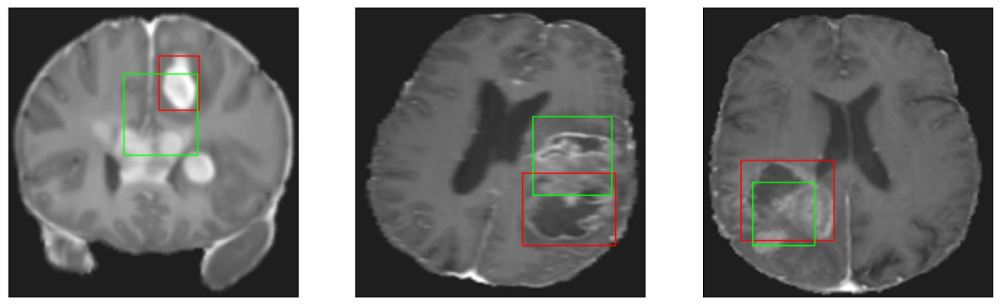

26/26 [==============================] - 3s 124ms/step - loss: 4.1299 - IoU: 0.6593 - val_loss: 7.9364 - val_IoU: 0.5528
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5089 - IoU: 0.6444
Epoch 196: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


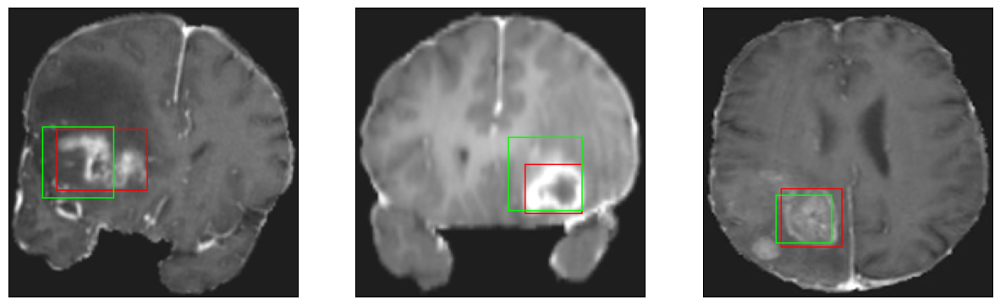

26/26 [==============================] - 3s 120ms/step - loss: 4.5405 - IoU: 0.6453 - val_loss: 8.7351 - val_IoU: 0.4961
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 4.2155 - IoU: 0.6664
Epoch 197: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


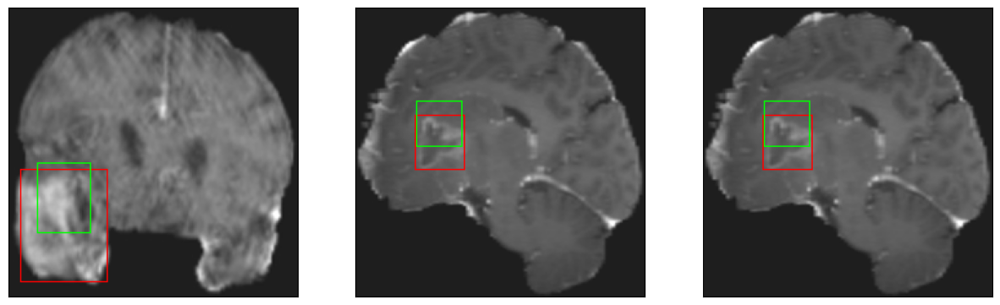

26/26 [==============================] - 3s 131ms/step - loss: 4.2155 - IoU: 0.6664 - val_loss: 8.4705 - val_IoU: 0.5155
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2092 - IoU: 0.6620
Epoch 198: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 10ms/step
4


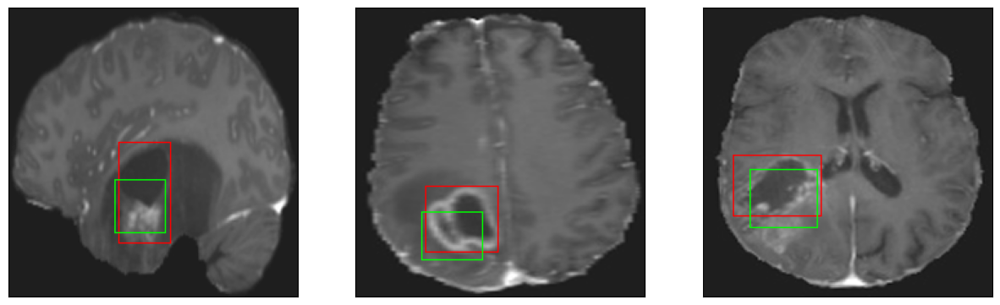

26/26 [==============================] - 4s 141ms/step - loss: 4.2026 - IoU: 0.6617 - val_loss: 8.5875 - val_IoU: 0.5201
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 4.3270 - IoU: 0.6572
Epoch 199: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


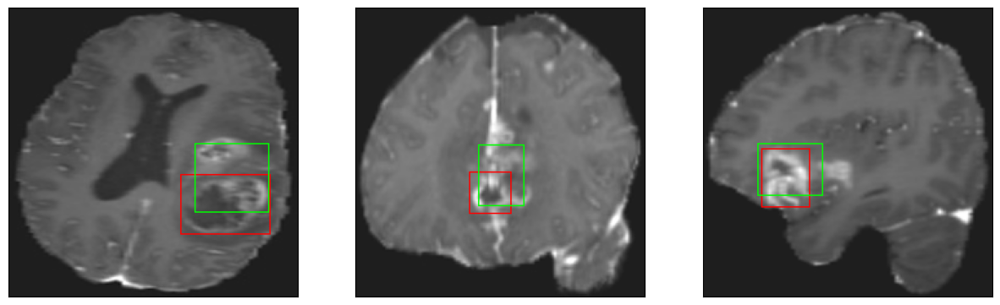

26/26 [==============================] - 3s 113ms/step - loss: 4.3270 - IoU: 0.6572 - val_loss: 8.0778 - val_IoU: 0.5613
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 4.1807 - IoU: 0.6669
Epoch 200: val_loss did not improve from 7.36366
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


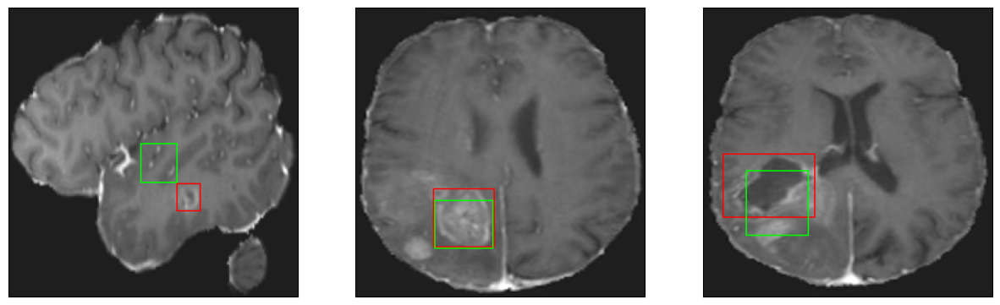

26/26 [==============================] - 3s 125ms/step - loss: 4.1807 - IoU: 0.6669 - val_loss: 8.2126 - val_IoU: 0.5291


In [25]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

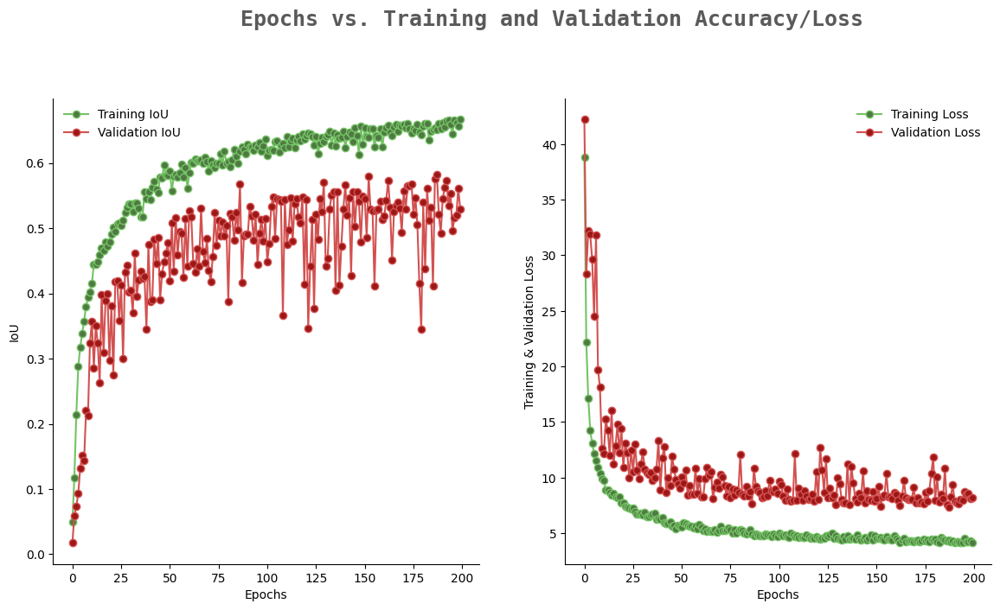

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 2s 50ms/step - loss: 10.4022 - IoU: 0.4415


[10.402249336242676, 0.4415348768234253]